<a href="https://colab.research.google.com/github/shashank3110/Master_Thesis_BA_DeepVis/blob/master/colab_notebooks/age_net_experimental_notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Agenet PT my implementation**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
'''
Pytorch implementation of Brain CA Estiimation.

'''
from __future__ import print_function
from __future__ import absolute_import

import warnings
import os
# import utils.gen_3D_vol_slices_age_gender_torch as generator
import tensorflow as tf
import math
import numpy as np
import torch
import torchvision
import torch.utils.data
from torch.utils.data import DataLoader,TensorDataset
import logging
from keras.layers import Input
from keras.layers.merge import concatenate
import torch.nn as nn
from torch.nn import BatchNorm3d,Conv3d,ReLU,MaxPool3d,Linear,AdaptiveAvgPool3d,Flatten,Softmax
import torch.nn.functional as F

def compute_pad(stride=(1,1,1),kernel_size=(3,3,3),dim=0, s=0):
        if s % stride[dim] == 0:
            return max(kernel_size[dim] - stride[dim], 0)
        else:
            return max(kernel_size[dim] - (s % stride[dim]), 0)
def pad_same(x):
        # compute 'same' padding
        stride=(1,1,1)
        kernel_size=(3,3,3)
        (batch, channel, t, h, w) = x.size()
        #print t,h,w
        out_t = np.ceil(float(t) / float(stride[0]))
        out_h = np.ceil(float(h) / float(stride[1]))
        out_w = np.ceil(float(w) / float(stride[2]))
        #print out_t, out_h, out_w
        pad_t = compute_pad(stride,kernel_size,0, t)
        pad_h = compute_pad(stride,kernel_size,1, h)
        pad_w = compute_pad(stride,kernel_size,2, w)
        #print pad_t, pad_h, pad_w

        pad_t_f = pad_t // 2
        pad_t_b = pad_t - pad_t_f
        pad_h_f = pad_h // 2
        pad_h_b = pad_h - pad_h_f
        pad_w_f = pad_w // 2
        pad_w_b = pad_w - pad_w_f

        pad = (pad_w_f, pad_w_b, pad_h_f, pad_h_b, pad_t_f, pad_t_b)
        #print x.size()
        #print pad
        print(f'padding={pad}')
        x = F.pad(x, pad)
        return x

#####  

class Conv3D_BN_Same_Padding(nn.Module):
    
    def __init__(self,in_channels=1,out_channels=64, kernel_size=(3, 3, 3),
        stride=(1,1,1),name=''):
        super(Conv3D_BN_Same_Padding,self).__init__()
        self.name = name
        self.kernel_size = kernel_size
        self.in_channels = in_channels
        self.out_channels= out_channels
        self.stride =  stride
        self.Conv3d =Conv3d(in_channels=self.in_channels,out_channels=self.out_channels, kernel_size=self.kernel_size,
        stride=self.stride,
        padding=(1,1,1),
        bias=False)
        self.BatchNorm3d =BatchNorm3d(num_features=self.out_channels,affine=True,momentum=0.99, eps=0.001)
        self.ReLU = ReLU()

    def forward(self, x):
        #july 9 th comment
        # x=pad_same(x)
        x = self.Conv3d(x)
        ##
        # x = self.Conv3d(x)
        x = self.BatchNorm3d(x)
        x = self.ReLU(x)

        return x

class MaxPool3D_Same_Padding(MaxPool3d):
    
    def __init__(self,kernel_size=(3,3,3),padding=(1,1,1),stride=(1,1,1),name=''):
        super(MaxPool3D_Same_Padding,self).__init__(kernel_size,padding,stride)
        self.name = name
        self.kernel_size = kernel_size
        self.padding = padding
        self.stride =  stride
    

    def forward(self, x):
        #july 9 comment
        # x=pad_same(x)
        # x=MaxPool3d(kernel_size=self.kernel_size,stride=self.stride)(x)
        ##
        x=MaxPool3d(kernel_size=self.kernel_size,padding=(1,1,1),stride=self.stride)(x)
        ##
        return x
###################


def regularize_kernel(l=5e-4,w=None):
	return w+ l*torch.sum(w**2)
	
class Fire_Module(nn.Module):
    def __init__(self,in_channels=1,squeeze=16,expand=64,name=''):

        super(Fire_Module,self).__init__()
        self.in_channels=in_channels
        self.squeeze=squeeze #16
        self.expand=expand #64
        self.Conv3D_squeeze = nn.Sequential(Conv3d(self.in_channels,self.squeeze,\
                            kernel_size=(1, 1, 1), bias=False),ReLU())#, padding=(0,0,0)
        
        self.in_channels = self.squeeze
        self.Conv3D_expand_left = nn.Sequential(Conv3d(self.in_channels,self.expand,\
                                  kernel_size=(1, 1, 1), bias=False),ReLU())#, padding=(0,0,0)
        
    
        self.Conv3D_expand_right = nn.Sequential(Conv3d(self.in_channels,\
                                  self.expand,kernel_size= (3, 3, 3), padding=(1,1,1), bias=False),ReLU())
        

        # self.activation = ReLU()
        self.name=name

    def forward(self,x):
        #print(self.Conv3D_squeeze.weight)
        #july 9 commenting
        #initialize_kernel

        # torch.nn.init.kaiming_normal_(self.Conv3D_squeeze.Conv3d.weight, a=0, mode='fan_in', nonlinearity='leaky_relu')
        #regularize_kernel
        # self.Conv3D_squeeze.Conv3d.weight.data=regularize_kernel(w=self.Conv3D_squeeze.Conv3d.weight)
        # print(self.Conv3D_squeeze.weight)
        ##
        x= self.Conv3D_squeeze(x)
        #July 10
        # x=self.activation(x)


        #july 9 commenting
        #initialize_kernel
        # torch.nn.init.kaiming_normal_(self.Conv3D_expand_left.Conv3d.weight, a=0, mode='fan_in', nonlinearity='leaky_relu')
        #regularize_kernel
        # self.Conv3D_expand_left.Conv3d.weight.data=regularize_kernel(w=self.Conv3D_expand_left.Conv3d.weight)
        ##
        
        left= self.Conv3D_expand_left(x)
        #July 10
        # left=self.activation(left)

        
        #july 9 commenting
        # x=pad_same(x)
        #initialize_kernel
        # torch.nn.init.kaiming_normal_(self.Conv3D_expand_right.Conv3d.weight, a=0, mode='fan_in', nonlinearity='leaky_relu')
        #regularize_kernel
        # self.Conv3D_expand_right.Conv3d.weight.data=regularize_kernel(w=self.Conv3D_expand_right.Conv3d.weight)
        ###
        right= self.Conv3D_expand_right(x)
        #July 10
        # right=self.activation(right)
        
        x= torch.cat([left,right],dim=1)
        print(f'torch fire cat shape={x.shape}')
        return x









Using TensorFlow backend.


In [ ]:
class Inception_Inflated3D2(nn.Module):

    def __init__(self):
        super(Inception_Inflated3D2,self).__init__()
        # self.img_input=img_input
        # self.Relu = ReLU()
        # self.in_channels=1
        # self.out_channels=64
        # self.stride=(2,2,1)
        # self.Conv3D_BN = Conv3D_BN_Same_Padding(in_channels=self.in_channels,out_channels=self.out_channels,stride=self.stride)
        # self.BN=BatchNorm3d(num_features=filters)  
        
        #Base Conv
        self.Conv3D_BN1 = Conv3D_BN_Same_Padding(in_channels=1,out_channels=64,stride=(2,2,1))
        self.Conv3D_BN2 = Conv3D_BN_Same_Padding(in_channels=64,out_channels=64,stride=(1,1,1))
        self.Conv3D_BN3 = Conv3D_BN_Same_Padding(in_channels=64,out_channels=192,stride=(1,1,1))

        #Branch Conv

        #3b
        self.Conv3D_BN3b1 = Conv3D_BN_Same_Padding(in_channels=192,out_channels=96,stride=(1,1,1))#x
        self.Conv3D_BN3b2 = Conv3D_BN_Same_Padding(in_channels=192,out_channels=16,stride=(1,1,1))#x
        self.Conv3D_BN3b1_1 = Conv3D_BN_Same_Padding(in_channels=96,out_channels=128,stride=(1,1,1))
        self.Conv3D_BN3b0 = Conv3D_BN_Same_Padding(in_channels=192,out_channels=64,stride=(1,1,1))#x
        self.Conv3D_BN3b2_1 = Conv3D_BN_Same_Padding(in_channels=16,out_channels=32,stride=(1,1,1))
        self.Conv3D_BN3b3 = Conv3D_BN_Same_Padding(in_channels=192,out_channels=32,stride=(1,1,1))#x
 

        #3c
        self.Conv3D_BN3c1 = Conv3D_BN_Same_Padding(in_channels=256,out_channels=128,stride=(1,1,1))
        self.Conv3D_BN3c2 = Conv3D_BN_Same_Padding(in_channels=256,out_channels=32,stride=(1,1,1))
        self.Conv3D_BN3c1_1 = Conv3D_BN_Same_Padding(in_channels=128,out_channels=192,stride=(1,1,1))
        self.Conv3D_BN3c0 = Conv3D_BN_Same_Padding(in_channels=256,out_channels=128,stride=(1,1,1))
        self.Conv3D_BN3c2_1 = Conv3D_BN_Same_Padding(in_channels=32,out_channels=96,stride=(1,1,1))
        self.Conv3D_BN3c3 = Conv3D_BN_Same_Padding(in_channels=256,out_channels=64,stride=(1,1,1))


        #4b
        self.Conv3D_BN4b1 = Conv3D_BN_Same_Padding(in_channels=480,out_channels=96,stride=(1,1,1))
        self.Conv3D_BN4b2 = Conv3D_BN_Same_Padding(in_channels=480,out_channels=16,stride=(1,1,1))
        self.Conv3D_BN4b1_1 = Conv3D_BN_Same_Padding(in_channels=96,out_channels=208,stride=(1,1,1))
        self.Conv3D_BN4b0 = Conv3D_BN_Same_Padding(in_channels=480,out_channels=192,stride=(1,1,1))
        self.Conv3D_BN4b2_1 = Conv3D_BN_Same_Padding(in_channels=16,out_channels=48,stride=(1,1,1))
        self.Conv3D_BN4b3 = Conv3D_BN_Same_Padding(in_channels=480,out_channels=64,stride=(1,1,1))
        #fire1
        #4c
        self.Conv3D_BN4c1 = Conv3D_BN_Same_Padding(in_channels=128,out_channels=112,stride=(1,1,1))
        self.Conv3D_BN4c2 = Conv3D_BN_Same_Padding(in_channels=128,out_channels=24,stride=(1,1,1))
        self.Conv3D_BN4c1_1 = Conv3D_BN_Same_Padding(in_channels=112,out_channels=224,stride=(1,1,1))
        self.Conv3D_BN4c0 = Conv3D_BN_Same_Padding(in_channels=128,out_channels=160,stride=(1,1,1))
        self.Conv3D_BN4c2_1 = Conv3D_BN_Same_Padding(in_channels=24,out_channels=64,stride=(1,1,1))
        self.Conv3D_BN4c3 = Conv3D_BN_Same_Padding(in_channels=128,out_channels=64,stride=(1,1,1))

        #4d
        self.Conv3D_BN4d1 = Conv3D_BN_Same_Padding(in_channels=512,out_channels=128,stride=(1,1,1))
        self.Conv3D_BN4d2 = Conv3D_BN_Same_Padding(in_channels=512,out_channels=24,stride=(1,1,1))
        self.Conv3D_BN4d1_1 = Conv3D_BN_Same_Padding(in_channels=128,out_channels=256,stride=(1,1,1))
        self.Conv3D_BN4d0 = Conv3D_BN_Same_Padding(in_channels=512,out_channels=128,stride=(1,1,1))
        self.Conv3D_BN4d2_1 = Conv3D_BN_Same_Padding(in_channels=24,out_channels=64,stride=(1,1,1))
        self.Conv3D_BN4d3 = Conv3D_BN_Same_Padding(in_channels=512,out_channels=64,stride=(1,1,1))

        #4e
        self.Conv3D_BN4e1 = Conv3D_BN_Same_Padding(in_channels=512,out_channels=144,stride=(1,1,1))
        self.Conv3D_BN4e2 = Conv3D_BN_Same_Padding(in_channels=512,out_channels=32,stride=(1,1,1))
        self.Conv3D_BN4e1_1 = Conv3D_BN_Same_Padding(in_channels=144,out_channels=288,stride=(1,1,1))
        self.Conv3D_BN4e0 = Conv3D_BN_Same_Padding(in_channels=512,out_channels=112,stride=(1,1,1))
        self.Conv3D_BN4e2_1 = Conv3D_BN_Same_Padding(in_channels=32,out_channels=64,stride=(1,1,1))
        self.Conv3D_BN4e3 = Conv3D_BN_Same_Padding(in_channels=512,out_channels=64,stride=(1,1,1))
        
        #4f
        self.Conv3D_BN4f1 = Conv3D_BN_Same_Padding(in_channels=528,out_channels=160,stride=(1,1,1))
        self.Conv3D_BN4f2 = Conv3D_BN_Same_Padding(in_channels=528,out_channels=32,stride=(1,1,1))
        self.Conv3D_BN4f1_1 = Conv3D_BN_Same_Padding(in_channels=160,out_channels=320,stride=(1,1,1))
        self.Conv3D_BN4f0 = Conv3D_BN_Same_Padding(in_channels=528,out_channels=256,stride=(1,1,1))
        self.Conv3D_BN4f2_1 = Conv3D_BN_Same_Padding(in_channels=32,out_channels=128,stride=(1,1,1))
        self.Conv3D_BN4f3 = Conv3D_BN_Same_Padding(in_channels=528,out_channels=128,stride=(1,1,1))
        #fire2
        #5b
        self.Conv3D_BN5b1 = Conv3D_BN_Same_Padding(in_channels=256,out_channels=160,stride=(1,1,1))
        self.Conv3D_BN5b2 = Conv3D_BN_Same_Padding(in_channels=256,out_channels=32,stride=(1,1,1))
        self.Conv3D_BN5b1_1 = Conv3D_BN_Same_Padding(in_channels=160,out_channels=320,stride=(1,1,1))
        self.Conv3D_BN5b0 = Conv3D_BN_Same_Padding(in_channels=256,out_channels=256,stride=(1,1,1))
        self.Conv3D_BN5b2_1 = Conv3D_BN_Same_Padding(in_channels=32,out_channels=128,stride=(1,1,1))
        self.Conv3D_BN5b3 = Conv3D_BN_Same_Padding(in_channels=256,out_channels=128,stride=(1,1,1))
        

        #5c
        self.Conv3D_BN5c1 = Conv3D_BN_Same_Padding(in_channels=832,out_channels=192,stride=(1,1,1))
        self.Conv3D_BN5c2 = Conv3D_BN_Same_Padding(in_channels=832,out_channels=48,stride=(1,1,1))
        self.Conv3D_BN5c1_1 = Conv3D_BN_Same_Padding(in_channels=192,out_channels=384,stride=(1,1,1))
        self.Conv3D_BN5c0 = Conv3D_BN_Same_Padding(in_channels=832,out_channels=384,stride=(1,1,1))
        self.Conv3D_BN5c2_1 = Conv3D_BN_Same_Padding(in_channels=48,out_channels=128,stride=(1,1,1))
        self.Conv3D_BN5c3 = Conv3D_BN_Same_Padding(in_channels=832,out_channels=128,stride=(1,1,1))
        #fire3

        #Max Pool3D
        self.MaxPool3D_SamePadding1 = MaxPool3D_Same_Padding(kernel_size=(3, 3, 3), stride=(1, 1, 1))
        self.MaxPool3D_SamePadding2 = MaxPool3D_Same_Padding(kernel_size=(3, 3, 3), stride=(2, 2, 1))
        self.MaxPool3D_SamePadding3 = MaxPool3D_Same_Padding(kernel_size=(3, 3, 3), stride=(2, 2, 2))
        self.MaxPool3D_SamePadding4 = MaxPool3D_Same_Padding(kernel_size=(2, 2, 2), stride=(2, 2, 1))

        #Fire Modules
        self.Fire_Module1=Fire_Module(512, squeeze=16, expand=64)
        self.Fire_Module2=Fire_Module(832, squeeze=32, expand=128)
        self.Fire_Module3=Fire_Module(1024, squeeze=64, expand=256)


        # Avg pool and flatten
        self.Adaptive_avg_pool3d = AdaptiveAvgPool3d(output_size=1)
        self.Flatten = Flatten()
        # #Regression Layers
        self.Dense1 = Linear(513,512)
        self.Dense2 = Linear(512,256)
        self.Dense3 = Linear(256,128)
        # self.Dense4 = Linear(128,1) # regression
        self.Dense4 = Linear(128,4) # classification
        self.Softmax = Softmax(dim=1) # classification
        # torch.nn.Linear(x.shape[1],512),
        # torch.nn.Linear(512,256),
        # torch.nn.Linear(256,128),
        # torch.nn.Linear(128,1)
        # self.Dense1 = Linear()

    # bn_axis = -1
    #verify this
    # One problem is we cannot specify on which axis to perform
    #batch norm in pytorch it performs on all axes
    def forward(self,X):
        x = X[0]
        gender_tensor = X[1]
        channel_axis = 1 #-1
        dim = x.size()


        # x = Conv3D_BN(pad_same(x),1, 64, strides=(2, 2, 1)) #'same')
        x = self.Conv3D_BN1(x)
        print(f'1 shape{x.shape}')
        # Downsampling (spatial only)
     
        x = self.MaxPool3D_SamePadding2(x)
        print(f'1 + maxpool shape{x.shape}')
        # x = Conv3D_BN(x, 64,64, strides=(1, 1, 1))
        x = self.Conv3D_BN2(x)
        print(f'2 shape{x.shape}')
        # x=pad_same(x)
        # x = Conv3D_BN(x,64, 192, strides=(1, 1, 1))
        x = self.Conv3D_BN3(x)
        print(f'3 shape{x.shape}')
        # Downsampling (spatial only)
        x = self.MaxPool3D_SamePadding2(x)


        # Mixed 3b
        # x=pad_same(x)
        print(f'3 + maxpool shape{x.shape}')
        # branch_0 = Conv3D_BN(x,192,64,strides=(1, 1, 1))
        branch_0 = self.Conv3D_BN3b0(x)
        # x=pad_same(x)
        # print(branch_0.shape)
        # branch_1 = Conv3D_BN(x,192, 96, strides=(1, 1, 1))
        branch_1 = self.Conv3D_BN3b1(x)

        # x=pad_same(x)
        # branch_1 = Conv3D_BN(branch_1,96, 128, strides=(1, 1, 1))
        branch_1 = self.Conv3D_BN3b1_1(branch_1)
        # x=pad_same(x)
        # branch_2 = Conv3D_BN(x,192, 16,strides=(1, 1, 1), )arg
        branch_2 = self.Conv3D_BN3b2(x)
        # x=pad_same(x)
        # branch_2 = Conv3D_BN(branch_2,16, 32,strides=(1, 1, 1))
        branch_2 = self.Conv3D_BN3b2_1(branch_2)


        
        branch_3 = self.MaxPool3D_SamePadding1(x)
        # print(branch_3.shape)
        # x=pad_same(x)
        # branch_3 = Conv3D_BN(branch_3,192, 32, strides=(1, 1, 1))
        branch_3 = self.Conv3D_BN3b3(branch_3)
        print(branch_0.shape,branch_1.shape,branch_2.shape,branch_3.shape)
        x = torch.cat(
            [branch_2, branch_0, branch_1, branch_3],
            dim=channel_axis,
           )
        
        # Mixed 3c

        # x=pad_same(x)
        print(f'x={x}')
        print(f'3b shape{x.shape}')
        # branch_0 = Conv3D_BN(x,256, 128, strides=(1, 1, 1))
        branch_0 = self.Conv3D_BN3c0(x)
        branch_1 = self.Conv3D_BN3c1(x)
        branch_1 = self.Conv3D_BN3c1_1(branch_1)
        branch_2 = self.Conv3D_BN3c2(x)
        branch_2 = self.Conv3D_BN3c2_1(branch_2)
        branch_3 = self.MaxPool3D_SamePadding1(x)
        branch_3 = self.Conv3D_BN3c3(branch_3)
        # x=pad_same(x)
        # branch_1 = Conv3D_BN(x,256, 128,strides=(1, 1, 1))
        # branch_1 = Conv3D_BN(branch_1,128, 192, strides=(1, 1, 1),padding='same')

        # branch_2 = Conv3D_BN(x,256, 32, strides=(1, 1, 1),padding='same')
        # branch_2 = Conv3D_BN(branch_2,32, 96, strides=(1, 1, 1), padding='same')

        # branch_3 = self.MaxPool3D_SamePadding1(x)
        # branch_3 = Conv3D_BN(branch_3,256, 64, strides=(1, 1, 1),padding='same')

        x = torch.cat(
            [branch_2, branch_0, branch_1, branch_3],
            dim=channel_axis,
            )
        print(f'x={x}')
        print(f'3c shape{x.shape}')
        # Downsampling (spatial and temporal)
        x = self.MaxPool3D_SamePadding3(x)
        print(x.shape)
        # Mixed 4b

        branch_0 = self.Conv3D_BN4b0(x)
        branch_1 = self.Conv3D_BN4b1(x)
        branch_1 = self.Conv3D_BN4b1_1(branch_1)
        branch_2 = self.Conv3D_BN4b2(x)
        branch_2 = self.Conv3D_BN4b2_1(branch_2)
        branch_3 = self.MaxPool3D_SamePadding1(x)
        branch_3 = self.Conv3D_BN4b3(branch_3)
        # branch_0 = Conv3D_BN(x,480, 192, strides=(1, 1, 1),padding='same')

        # branch_1 = Conv3D_BN(x,480, 96, strides=(1, 1, 1),padding='same')
        # branch_1 = Conv3D_BN(branch_1,96, 208,strides=(1, 1, 1),padding='same')

        # branch_2 = Conv3D_BN(x, 480,16, strides=(1, 1, 1),padding='same')
        # branch_2 = Conv3D_BN(branch_2,16, 48,strides=(1, 1, 1), padding='same')

        # branch_3 = self.MaxPool3D_SamePadding1(x)
        # branch_3 = Conv3D_BN(branch_3,480, 64, strides=(1, 1, 1),padding='same')

        x = torch.cat(
            [branch_2, branch_0, branch_1, branch_3],
            dim=channel_axis,
           )
        print(f'4b  shape{x.shape}')
        # x = Fire_Module(512, squeeze=16, expand=64)(x)
        x = self.Fire_Module1(x)
        print(f'x={x}')
        print(f'4b + fire shape{x.shape}')
        # Mixed 4c

        branch_0 = self.Conv3D_BN4c0(x)
        branch_1 = self.Conv3D_BN4c1(x)
        branch_1 = self.Conv3D_BN4c1_1(branch_1)
        branch_2 = self.Conv3D_BN4c2(x)
        branch_2 = self.Conv3D_BN4c2_1(branch_2)
        branch_3 = self.MaxPool3D_SamePadding1(x)
        branch_3 = self.Conv3D_BN4c3(branch_3)
        # branch_0 = Conv3D_BN(x,x.shape[1], 160, strides=(1, 1, 1), padding='same')

        # branch_1 = Conv3D_BN(x,x.shape[1], 112, strides=(1, 1, 1), padding='same')
        # branch_1 = Conv3D_BN(branch_1,112, 224, strides=(1, 1, 1), padding='same')

        # branch_2 = Conv3D_BN(x,x.shape[1], 24, strides=(1, 1, 1), padding='same')
        # branch_2 = Conv3D_BN(branch_2, 24,64, strides=(1, 1, 1), padding='same')

        # branch_3 = self.MaxPool3D_SamePadding1(x)
        # branch_3 = Conv3D_BN(branch_3,branch_3.shape[1], 64, strides=(1, 1, 1), padding='same')

        x = torch.cat(
            [branch_2, branch_0, branch_1, branch_3],
            dim=channel_axis,
            )
        print(f'4c shape{x.shape}')
        # Mixed 4d
        branch_0 = self.Conv3D_BN4d0(x)
        branch_1 = self.Conv3D_BN4d1(x)
        branch_1 = self.Conv3D_BN4d1_1(branch_1)
        branch_2 = self.Conv3D_BN4d2(x)
        branch_2 = self.Conv3D_BN4d2_1(branch_2)
        branch_3 = self.MaxPool3D_SamePadding1(x)
        branch_3 = self.Conv3D_BN4d3(branch_3)
        
        # branch_0 = Conv3D_BN(x,512, 128,strides=(1, 1, 1), padding='same')

        # branch_1 = Conv3D_BN(x, 512,128, strides=(1, 1, 1),padding='same')
        # branch_1 = Conv3D_BN(branch_1, 128,256, strides=(1, 1, 1),padding='same')

        # branch_2 = Conv3D_BN(x,512, 24, strides=(1, 1, 1),padding='same')
        # branch_2 = Conv3D_BN(branch_2,24, 64, strides=(1, 1, 1),padding='same')

        # branch_3 = self.MaxPool3D_SamePadding1(x)
        # branch_3 = Conv3D_BN(branch_3,512, 64, strides=(1, 1, 1),padding='same')

        x = torch.cat(
            [branch_2, branch_0, branch_1, branch_3],
            dim=channel_axis,
         )
        print(f'4d shape{x.shape}')
        # Mixed 4e

        branch_0 = self.Conv3D_BN4e0(x)
        branch_1 = self.Conv3D_BN4e1(x)
        branch_1 = self.Conv3D_BN4e1_1(branch_1)
        branch_2 = self.Conv3D_BN4e2(x)
        branch_2 = self.Conv3D_BN4e2_1(branch_2)
        branch_3 = self.MaxPool3D_SamePadding1(x)
        branch_3 = self.Conv3D_BN4e3(branch_3)
        # branch_0 = Conv3D_BN(x,512, 112,strides=(1, 1, 1), padding='same')

        # branch_1 = Conv3D_BN(x,512, 144, strides=(1, 1, 1),padding='same')
        # branch_1 = Conv3D_BN(branch_1,144, 288, padding='same')

        # branch_2 = Conv3D_BN(x,512, 32,strides=(1, 1, 1), padding='same')
        # branch_2 = Conv3D_BN(branch_2, 32,64, padding='same')

        # branch_3 = self.MaxPool3D_SamePadding1(x)
        # branch_3 = Conv3D_BN(branch_3,512, 64, strides=(1, 1, 1),padding='same')

        x = torch.cat(
            [branch_2, branch_0, branch_1, branch_3],
            dim=channel_axis,
            )
        print(branch_0.shape, branch_1.shape, branch_2.shape, branch_3.shape)
        print(f'4e shape{x.shape}')
        # Mixed 4f
        branch_0 = self.Conv3D_BN4f0(x)
        branch_1 = self.Conv3D_BN4f1(x)
        branch_1 = self.Conv3D_BN4f1_1(branch_1)
        branch_2 = self.Conv3D_BN4f2(x)
        branch_2 = self.Conv3D_BN4f2_1(branch_2)
        branch_3 = self.MaxPool3D_SamePadding1(x)
        branch_3 = self.Conv3D_BN4f3(branch_3)
        # branch_0 = Conv3D_BN(x,528, 256,strides=(1, 1, 1), padding='same')

        # branch_1 = Conv3D_BN(x,528, 160, strides=(1, 1, 1),padding='same')
        # branch_1 = Conv3D_BN(branch_1,160, 320, padding='same')

        # branch_2 = Conv3D_BN(x,528, 32,strides=(1, 1, 1), padding='same')
        # branch_2 = Conv3D_BN(branch_2, 32,128, strides=(1, 1, 1),padding='same')

        # branch_3 = self.MaxPool3D_SamePadding1(x)
        # branch_3 = Conv3D_BN(branch_3,528, 128, strides=(1, 1, 1),padding='same')

        x = torch.cat(
            [branch_2, branch_0, branch_1, branch_3],
            dim=channel_axis,
            )
        print(branch_0.shape, branch_1.shape, branch_2.shape, branch_3.shape)
        print(f'4f shape{x.shape}')
        # Downsampling (spatial and temporal)
        x = self.MaxPool3D_SamePadding2(x)
        print(f'4f +max pool shape{x.shape}')
        # x = Fire_Module(832, squeeze=32, expand=128)(x)
        x = self.Fire_Module2(x)
        print(f'4f +fire shape{x.shape}')
        # Mixed 5b
        branch_0 = self.Conv3D_BN5b0(x)
        branch_1 = self.Conv3D_BN5b1(x)
        branch_1 = self.Conv3D_BN5b1_1(branch_1)
        branch_2 = self.Conv3D_BN5b2(x)
        branch_2 = self.Conv3D_BN5b2_1(branch_2)
        branch_3 = self.MaxPool3D_SamePadding1(x)
        branch_3 = self.Conv3D_BN5b3(branch_3)
        # branch_0 = Conv3D_BN(x,x.shape[1], 256,strides=(1, 1, 1), padding='same')

        # branch_1 = Conv3D_BN(x,x.shape[1], 160,strides=(1, 1, 1), padding='same')
        # branch_1 = Conv3D_BN(branch_1,branch_1.shape[1], 320, padding='same')

        # branch_2 = Conv3D_BN(x,x.shape[1], 32, strides=(1, 1, 1), padding='same')
        # branch_2 = Conv3D_BN(branch_2,branch_2.shape[1], 128, strides=(1, 1, 1),padding='same')

        # branch_3 = self.MaxPool3D_SamePadding1(x)
        # branch_3 = Conv3D_BN(branch_3,branch_3.shape[1], 128, strides=(1, 1, 1),padding='same')

        x = torch.cat(
            [branch_2, branch_0, branch_1, branch_3],
            dim=channel_axis,
            )
        print(branch_0.shape, branch_1.shape, branch_2.shape, branch_3.shape)
        print(f'5b shape{x.shape}')
        # Mixed 5c

        branch_0 = self.Conv3D_BN5c0(x)
        branch_1 = self.Conv3D_BN5c1(x)
        branch_1 = self.Conv3D_BN5c1_1(branch_1)
        branch_2 = self.Conv3D_BN5c2(x)
        branch_2 = self.Conv3D_BN5c2_1(branch_2)
        branch_3 = self.MaxPool3D_SamePadding1(x)
        branch_3 = self.Conv3D_BN5c3(branch_3)
        # branch_0 = Conv3D_BN(x,x.shape[1], 384, strides=(1, 1, 1),padding='same')

        # branch_1 = Conv3D_BN(x,x.shape[1], 192, strides=(1, 1, 1), padding='same')
        # branch_1 = Conv3D_BN(branch_1,192, 384,strides=(1, 1, 1),  padding='same')

        # branch_2 = Conv3D_BN(x, x.shape[1],48, strides=(1, 1, 1),padding='same')
        # branch_2 = Conv3D_BN(branch_2,48, 128,strides=(1, 1, 1), padding='same')

        # branch_3 = self.MaxPool3D_SamePadding1(x)
        # branch_3 = Conv3D_BN(branch_3,branch_3.shape[1], 128, strides=(1, 1, 1), padding='same')

        x = torch.cat(
            [branch_2, branch_0, branch_1, branch_3],
            dim=channel_axis,
     )
        print(branch_0.shape, branch_1.shape, branch_2.shape, branch_3.shape)
        print(f'5c shape{x.shape}')
        ##x = MaxPooling3D((3, 3, 3), strides=(2, 2, 2), padding='same')(x)
        x = self.Fire_Module3(x)
        # x = Fire_Module(x.shape[1], squeeze=64, expand=256)(x)
        print(f'5c + fire module shape{x.shape}')
        # x = F.avg_pool3d(x,(dim[0],dim[1],1),stride=1)
        #############
        # both methods below seem correct for global average pooling 3D use any of these 
        # x = F.avg_pool3d(x,(x.shape[2:]),stride=1).view(x.size()[0],-1)
        # x = F.adaptive_avg_pool3d(x,output_size=dim[1]).view(x.size()[0],-1)
        x= self.Adaptive_avg_pool3d(x).view(x.size()[0],-1)
        print(f'avg pool shape={x.shape}')
        x=self.Flatten(x)
        # x=x.view(1,x.shape[1])
        print(f'inflated output={x.shape}')

        ####
        print(f'Entering Regression Layers')
        x = torch.cat([x,gender_tensor.float()],dim =1)
        print(f'input + gender concat shape={x.shape}')
        x = self.Dense1(x)
        print(f'x={x}')
        print(f'Dense1 shape={x.shape}')
        x = self.Dense2(x)
        print(f'x={x}')
        print(f'Dense2 shape={x.shape}')
        x = self.Dense3(x)
        print(f'x={x}')
        print(f'Dense3 shape={x.shape}')
        x = self.Dense4(x)
        x = self.Softmax(x) #classification
        print(f'x={x}')
        print(f'Dense4 shape={x.shape}')

        ####

        return x



In [ ]:
# test_model=Inception_Inflated3D2()

In [ ]:
# test_model_state=test_model.state_dict()


In [ ]:
# test_model_state.keys()

odict_keys(['Conv3D_BN1.Conv3d.weight', 'Conv3D_BN1.BatchNorm3d.weight', 'Conv3D_BN1.BatchNorm3d.bias', 'Conv3D_BN1.BatchNorm3d.running_mean', 'Conv3D_BN1.BatchNorm3d.running_var', 'Conv3D_BN1.BatchNorm3d.num_batches_tracked', 'Conv3D_BN2.Conv3d.weight', 'Conv3D_BN2.BatchNorm3d.weight', 'Conv3D_BN2.BatchNorm3d.bias', 'Conv3D_BN2.BatchNorm3d.running_mean', 'Conv3D_BN2.BatchNorm3d.running_var', 'Conv3D_BN2.BatchNorm3d.num_batches_tracked', 'Conv3D_BN3.Conv3d.weight', 'Conv3D_BN3.BatchNorm3d.weight', 'Conv3D_BN3.BatchNorm3d.bias', 'Conv3D_BN3.BatchNorm3d.running_mean', 'Conv3D_BN3.BatchNorm3d.running_var', 'Conv3D_BN3.BatchNorm3d.num_batches_tracked', 'Conv3D_BN3b1.Conv3d.weight', 'Conv3D_BN3b1.BatchNorm3d.weight', 'Conv3D_BN3b1.BatchNorm3d.bias', 'Conv3D_BN3b1.BatchNorm3d.running_mean', 'Conv3D_BN3b1.BatchNorm3d.running_var', 'Conv3D_BN3b1.BatchNorm3d.num_batches_tracked', 'Conv3D_BN3b2.Conv3d.weight', 'Conv3D_BN3b2.BatchNorm3d.weight', 'Conv3D_BN3b2.BatchNorm3d.bias', 'Conv3D_BN3b2.Batc

In [ ]:
# test_model_state['Conv3D_BN1.BatchNorm3d.weight']

tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

In [ ]:
# inflated_model_dict['Conv3D_BN1.bias']

#**Read Nii images code**

In [ ]:
import os
import nibabel as nib


def read(path='', b_reorient=False, orientation=(('R', 'L'), ('P', 'A'), ('I', 'S'))):
    """
     Read the nifti file and switch to a given orientation

     orientation defaults to std LAS (radiological) - RAS (neurological)
    """

    if not os.path.isfile(path):
        raise ValueError('Provided path is not a valid file')

    image_nii = nib.load(path)
    if b_reorient:
        # switch to given orientation (http://nipy.org/nibabel/image_orientation.html)
        axcodes = nib.aff2axcodes(image_nii.affine)
        orientations = nib.orientations.axcodes2ornt(axcodes, orientation)
        image = image_nii.get_data()
        image = nib.apply_orientation(image, orientations)
        header = image_nii.header
        img_shape = image.shape
        #print(img_shape)
        # image_nii = nib.as_closest_canonical(image_nii)  # quick way to switch to RAS
    else:
        #print('inside orient false')
        image = image_nii.get_data()
        img_shape = image.shape
        #print(img_shape)
    header = image_nii.header
    print(f'preprocessed data shape={img_shape}')
    return image, header, img_shape

In [ ]:
# img,header, img_shape=read(path='/content/drive/My Drive/Uni-Sem4/colab_files/smwc1OAS1_0014_MR1_mpr-1_anon.nii')

#**Load tf model**

In [ ]:
device=torch.device('cuda:0')
def createModel2(inflated_model_dict):
    ModelName = 'BioAgeNet_Regression'
    patchSize=[121,145, 6, 1]
    input_tensor = torch.randn([1,1,patchSize[0], patchSize[1],patchSize[2]])#[N,in_ch, d,h,w]
    img,header, img_shape=read(path='/content/drive/My Drive/Uni-Sem4/colab_files/smwc1OAS1_0014_MR1_mpr-1_anon.nii')
    print(input_tensor.shape)
    # img_chunk = img_chunk.unsqueeze(0)

    ###
    tfr_img=tf.data.TFRecordDataset('/content/drive/My Drive/Uni-Sem4/colab_files/OAS30720_MR_d4213.tfrecord')
    img_tf=tfr_img.map(map_func=lambda a:parse_function_image(a))
    for im in img_tf:
      print(type(im),im.shape)
    img=im.numpy()
    ###
    img_chunk=torch.tensor(img[:,:,:6])
    img_chunk = img_chunk.unsqueeze(0)
    input_tensor = img_chunk.unsqueeze(0)

    gender_tensor= torch.tensor([[1]])
    
    final_model=Inception_Inflated3D2()
    # final_model.load_state_dict(inflated_model_dict)
    inflated_model_dict=final_model.state_dict()
    final_model.eval()
    # with torch.no_grad():
    output =  final_model([input_tensor,gender_tensor])
   
    print(f'final output={output,output.shape}')

    
    return output,ModelName,final_model,inflated_model_dict

In [ ]:
# output,ModelName,final_model,inflated_model_dict=createModel2(inflated_model_dict)

In [ ]:
# mname='colab_files' 
#TF model
# mname='model2'
# tf_weights = np.load('/content/drive/My Drive/Uni-Sem4/'+mname+'/age_net_oasis1_3.hdf5',allow_pickle=True)
model =  tf.python.keras.models.load_model('/content/drive/My Drive/BA_Estimation/models/exp2/age_net_oasis1_3.hdf5',compile=False)

tf_model = model
tfw=tf_model.weights

In [ ]:
# dir(model)
# (model.weights[0].numpy())
# (model.weights[0].name)

'conv3d_70/kernel:0'

In [ ]:
# tf_model = model
# # pt_model = final_model

In [ ]:
# # dir(pt_model)
# tf_model = model
# tfw=tf_model.weights
# # inflated_model_dict=inflated_model.state_dict()

In [ ]:
# for t in tfw:
#   print(t.name)

In [ ]:
# tfw1=tfw[0].numpy()
# tfw1

In [ ]:
# ptfw1=torch.from_numpy(tfw1).permute(4,3,0,1,2)

In [ ]:
# final_model=Inception_Inflated3D2()
# inflated_model_dict=final_model.state_dict()
# inflated_model_dict.keys()

odict_keys(['Conv3D_BN1.Conv3d.weight', 'Conv3D_BN1.BatchNorm3d.weight', 'Conv3D_BN1.BatchNorm3d.bias', 'Conv3D_BN1.BatchNorm3d.running_mean', 'Conv3D_BN1.BatchNorm3d.running_var', 'Conv3D_BN1.BatchNorm3d.num_batches_tracked', 'Conv3D_BN2.Conv3d.weight', 'Conv3D_BN2.BatchNorm3d.weight', 'Conv3D_BN2.BatchNorm3d.bias', 'Conv3D_BN2.BatchNorm3d.running_mean', 'Conv3D_BN2.BatchNorm3d.running_var', 'Conv3D_BN2.BatchNorm3d.num_batches_tracked', 'Conv3D_BN3.Conv3d.weight', 'Conv3D_BN3.BatchNorm3d.weight', 'Conv3D_BN3.BatchNorm3d.bias', 'Conv3D_BN3.BatchNorm3d.running_mean', 'Conv3D_BN3.BatchNorm3d.running_var', 'Conv3D_BN3.BatchNorm3d.num_batches_tracked', 'Conv3D_BN3b1.Conv3d.weight', 'Conv3D_BN3b1.BatchNorm3d.weight', 'Conv3D_BN3b1.BatchNorm3d.bias', 'Conv3D_BN3b1.BatchNorm3d.running_mean', 'Conv3D_BN3b1.BatchNorm3d.running_var', 'Conv3D_BN3b1.BatchNorm3d.num_batches_tracked', 'Conv3D_BN3b2.Conv3d.weight', 'Conv3D_BN3b2.BatchNorm3d.weight', 'Conv3D_BN3b2.BatchNorm3d.bias', 'Conv3D_BN3b2.Batc

In [ ]:
# print(tfw[86].numpy().shape,tfw[-9].name,tfw[4].name,tfw[0].numpy().shape,inflated_model_dict['Conv3D_BN1.Conv3d.weight'].shape)

(3, 3, 3, 16, 64) conv3d_65_5/kernel:0 conv3d_1_5/kernel:0 (3, 3, 3, 1, 64) torch.Size([64, 1, 3, 3, 3])


#**Pt agenet others implementation**

In [ ]:
import torch
from torch.utils import data
import time

import torch.nn as nn
import torch.nn.functional as F

import tensorflow as tf
import os
import shutil
import pandas as pd
from random import shuffle
import numpy as np


class conv3d_bn(nn.Module):
    def __init__(self, cin, cout, strides=(1, 1, 1), padding=(1,1,1)):
        super(conv3d_bn, self).__init__()
        self.conv3d_1 = nn.Conv3d(cin, cout, kernel_size=3, stride=strides, padding=padding, bias=False)
        self.batch_norm_1 = nn.BatchNorm3d(cout)


    def forward(self, x):
        x = self.conv3d_1(x)
        x = F.relu(self.batch_norm_1(x))
        return x


class fire_module(nn.Module):
    def __init__(self, cin, squeeze=16, expand=64):
        super(fire_module, self).__init__()
        self.conv3d_1 = nn.Conv3d(cin, squeeze, kernel_size=1, bias=False)
        self.conv3d_left = nn.Conv3d(squeeze, expand, kernel_size=1, bias=False)
        self.conv3d_right = nn.Conv3d(squeeze, expand, kernel_size=3, padding=(1,1,1), bias=False)
        


    def forward(self, x):
        x = F.relu(self.conv3d_1(x))
        left = F.relu(self.conv3d_left(x))
        right = F.relu(self.conv3d_right(x))
        x = torch.cat((left, right), dim=1)
        return x


class inception(nn.Module):
    def __init__(self, cin, cout1, cout2, cout3,cout4,cout5,cout6):
        super(inception, self).__init__()
        self.branch_0 = conv3d_bn(cin,cout1)
        self.branch_1_0 = conv3d_bn(cin,cout2)
        self.branch_1_1 = conv3d_bn(cout2,cout3)
        self.branch_2_0 = conv3d_bn(cin,cout4)
        self.branch_2_1 = conv3d_bn(cout4,cout5)      
        self.MaxPool2d_2a_3x3 = nn.MaxPool3d(kernel_size = (3,3,3), stride = (1,1,1), padding=(1,1,1)) 
        self.branch_3 = conv3d_bn(cin,cout6)  


    def forward(self, x):
        branch_0 = self.branch_0(x)
        branch_1 = self.branch_1_0(x)
        branch_1 = self.branch_1_1(branch_1)
        branch_2 = self.branch_2_0(x)
        branch_2 = self.branch_2_1(branch_2)
        branch_3 = self.MaxPool2d_2a_3x3(x)
        branch_3 = self.branch_3(branch_3)
        x = torch.cat((branch_0, branch_1, branch_2, branch_3), dim=1)
        return x


     

class AgeNet(nn.Module):
    def __init__(self):
        super(AgeNet, self).__init__()
        self.conv3d_bn_1 = conv3d_bn(1,64,(1,2,2))
        self.MaxPool2d_2a_3x3 = nn.MaxPool3d(kernel_size = (3,3,3), stride = (1,2,2), padding=(1,1,1))
        self.MaxPool2d_3a_3x3 = nn.MaxPool3d(kernel_size = (3,3,3), stride = (1,2,2), padding=(1,1,1))
        self.MaxPool3d_3 = nn.MaxPool3d(kernel_size = (3,3,3), stride = (2,2,2), padding=(1,1,1))
        self.MaxPool2d_4 = nn.MaxPool3d(kernel_size = (1,2,2))
        self.conv3d_bn_2 = conv3d_bn(64,64,(1,1,1))
        self.conv3d_bn_3 = conv3d_bn(64,192,(1,1,1))
        self.incep_1 = inception(192,64,96,128,16,32,32)
        self.incep_2 = inception(256,128,128,192,32,96,64)
        self.incep_3 = inception(480,192,96,208,16,48,64)
        self.fire_module_1 = fire_module(512,16,64)

        self.incep_4 = inception(128,160,112,224,24,64,64)
        self.incep_5 = inception(512,128,128,256,24,64,64)
        self.incep_6 = inception(512,112,144,288,32,64,64)
        self.incep_7 = inception(528,256,160,320,32,128,128)
        self.fire_module_2 = fire_module(832,32,128)

        self.incep_8 = inception(256,256,160,320,32,128,128)
        self.incep_9 = inception(832,384,192,384,48,128,128)

        self.fire_module_3 = fire_module(1024,64,256)

        self.flatten1 = nn.Flatten()

        # self.fc1 = nn.Linear(513, 256)
        # self.fc2 = nn.Linear(256, 128)
        # self.fc3 = nn.Linear(128, 1)

        self.fc1 = nn.Linear(513, 512)
        self.fc2 = nn.Linear(512, 256)
        self.fc3 = nn.Linear(256, 128)
        self.fc4 = nn.Linear(128,1)

    def forward(self, x, gender):
        x = self.conv3d_bn_1(x)
        x = self.MaxPool2d_2a_3x3(x)
        x = self.conv3d_bn_2(x)
        x = self.conv3d_bn_3(x)
        x = self.MaxPool2d_3a_3x3(x)
        x = self.incep_1(x)
        x = self.incep_2(x)
        x = self.MaxPool3d_3(x)
        x = self.incep_3(x)
        x = self.fire_module_1(x)

        x = self.incep_4(x)
        x = self.incep_5(x)
        x = self.incep_6(x)
        x = self.incep_7(x)
        x = self.MaxPool2d_4(x)

        x = self.fire_module_2(x)       

        x = self.incep_8(x)
        x = self.incep_9(x)
        x = self.fire_module_3(x)  

        x = F.avg_pool3d(x, kernel_size=(3,4,5)) 
        x1 = self.flatten1(x)

        x2 = gender
        x = torch.cat((x1, x2), dim=1)
        x = (self.fc1(x))
        x = (self.fc2(x))
        x = self.fc3(x)

        x = self.fc4(x)
        return x


#**Layerwise weight assignment tf to pt others implementation**

In [ ]:
final_model=AgeNet()

In [ ]:
final_model_state_dict=final_model.state_dict()
for k in final_model_state_dict.keys():
  print(k,final_model_state_dict[k].shape)
len(final_model_state_dict.keys())


In [ ]:
# tfw[44].numpy().shape,final_model_state_dict['incep_2.branch_0.conv3d_1.weight'].shape,tfw[12].numpy().shape,final_model_state_dict['incep_1.branch_1_0.conv3d_1.weight'].shape,final_model_state_dict['incep_2.branch_1_0.conv3d_1.weight'].shape,tfw[-8].shape

In [ ]:
#@title
# final_model_state_dict={}

print(f'layer:{tfw[0].name}')
final_model_state_dict['conv3d_bn_1.conv3d_1.weight']=torch.from_numpy(tfw[0].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[1].name}')
final_model_state_dict['conv3d_bn_1.batch_norm_1.bias']=torch.from_numpy(tfw[1].numpy())#.permute(4,3,0,1,2)
print(f'layer:{tfw[2].name}')
final_model_state_dict['conv3d_bn_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[2].numpy())
print(f'layer:{tfw[3].name}')
final_model_state_dict['conv3d_bn_1.batch_norm_1.running_var']=torch.from_numpy(tfw[3].numpy())

print(f'layer:{tfw[4].name}')
final_model_state_dict['conv3d_bn_2.conv3d_1.weight']=torch.from_numpy(tfw[4].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[5].name}')
final_model_state_dict['conv3d_bn_2.batch_norm_1.bias']=torch.from_numpy(tfw[5].numpy())
print(f'layer:{tfw[6].name}')
final_model_state_dict['conv3d_bn_2.batch_norm_1.running_mean']=torch.from_numpy(tfw[6].numpy())
print(f'layer:{tfw[7].name}')
final_model_state_dict['conv3d_bn_2.batch_norm_1.running_var']=torch.from_numpy(tfw[7].numpy())

print(f'layer:{tfw[8].name}')
final_model_state_dict['conv3d_bn_3.conv3d_1.weight']=torch.from_numpy(tfw[8].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[9].name}')
final_model_state_dict['conv3d_bn_3.batch_norm_1.bias']=torch.from_numpy(tfw[9].numpy())
print(f'layer:{tfw[10].name}')
final_model_state_dict['conv3d_bn_3.batch_norm_1.running_mean']=torch.from_numpy(tfw[10].numpy())
print(f'layer:{tfw[11].name}')
final_model_state_dict['conv3d_bn_3.batch_norm_1.running_var']=torch.from_numpy(tfw[11].numpy())


print(f'layer:{tfw[12].name}')#conv3d 4
final_model_state_dict['incep_1.branch_1_0.conv3d_1.weight']=torch.from_numpy(tfw[12].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[14].name}')
final_model_state_dict['incep_1.branch_1_0.batch_norm_1.bias']=torch.from_numpy(tfw[14].numpy())
print(f'layer:{tfw[15].name}')
final_model_state_dict['incep_1.branch_1_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[15].numpy())
print(f'layer:{tfw[16].name}')
final_model_state_dict['incep_1.branch_1_0.batch_norm_1.running_var']=torch.from_numpy(tfw[16].numpy())


print(f'layer:{tfw[13].name}')#3onv 3d 6 2_0 1_1 
final_model_state_dict['incep_1.branch_2_0.conv3d_1.weight']=torch.from_numpy(tfw[13].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[17].name}')
final_model_state_dict['incep_1.branch_2_0.batch_norm_1.bias']=torch.from_numpy(tfw[17].numpy())
print(f'layer:{tfw[18].name}')
final_model_state_dict['incep_1.branch_2_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[18].numpy())
print(f'layer:{tfw[19].name}')
final_model_state_dict['incep_1.branch_2_0.batch_norm_1.running_var']=torch.from_numpy(tfw[19].numpy())


print(f'layer:{tfw[20].name}')#conv 3d 3
final_model_state_dict['incep_1.branch_0.conv3d_1.weight']=torch.from_numpy(tfw[20].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[24].name}')
final_model_state_dict['incep_1.branch_0.batch_norm_1.bias']=torch.from_numpy(tfw[24].numpy())
print(f'layer:{tfw[25].name}')
final_model_state_dict['incep_1.branch_0.batch_norm_1.bias']=torch.from_numpy(tfw[25].numpy())
print(f'layer:{tfw[26].name}')
final_model_state_dict['incep_1.branch_0.batch_norm_1.running_var']=torch.from_numpy(tfw[26].numpy())

print(f'layer:{tfw[21].name}')#conv 3d 5
final_model_state_dict['incep_1.branch_1_1.conv3d_1.weight']=torch.from_numpy(tfw[21].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[27].name}')
final_model_state_dict['incep_1.branch_1_1.batch_norm_1.bias']=torch.from_numpy(tfw[27].numpy())
print(f'layer:{tfw[28].name}')
final_model_state_dict['incep_1.branch_1_1.batch_norm_1.bias']=torch.from_numpy(tfw[28].numpy())
print(f'layer:{tfw[29].name}')
final_model_state_dict['incep_1.branch_1_1.batch_norm_1.running_var']=torch.from_numpy(tfw[29].numpy())


print(f'layer:{tfw[22].name}')#conv 3d 7
final_model_state_dict['incep_1.branch_2_1.conv3d_1.weight']=torch.from_numpy(tfw[22].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[30].name}')
final_model_state_dict['incep_1.branch_2_1.batch_norm_1.bias']=torch.from_numpy(tfw[30].numpy())
print(f'layer:{tfw[31].name}')
final_model_state_dict['incep_1.branch_2_1.batch_norm_1.bias']=torch.from_numpy(tfw[31].numpy())
print(f'layer:{tfw[32].name}')
final_model_state_dict['incep_1.branch_2_1.batch_norm_1.running_var']=torch.from_numpy(tfw[32].numpy())


print(f'layer:{tfw[23].name}')#conv 3d 8
final_model_state_dict['incep_1.branch_3.conv3d_1.weight']=torch.from_numpy(tfw[23].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[33].name}')
final_model_state_dict['incep_1.branch_3.batch_norm_1.bias']=torch.from_numpy(tfw[33].numpy())
print(f'layer:{tfw[34].name}')
final_model_state_dict['incep_1.branch_3.batch_norm_1.running_mean']=torch.from_numpy(tfw[34].numpy())
print(f'layer:{tfw[35].name}')
final_model_state_dict['incep_1.branch_3.batch_norm_1.running_var']=torch.from_numpy(tfw[35].numpy())

print(f'layer:{tfw[36].name}')#conv 3d 10
final_model_state_dict['incep_2.branch_1_0.conv3d_1.weight']=torch.from_numpy(tfw[36].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[38].name}')
final_model_state_dict['incep_2.branch_1_0.batch_norm_1.bias']=torch.from_numpy(tfw[38].numpy())
print(f'layer:{tfw[39].name}')
final_model_state_dict['incep_2.branch_1_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[39].numpy())
print(f'layer:{tfw[40].name}')
final_model_state_dict['incep_2.branch_1_0.batch_norm_1.running_var']=torch.from_numpy(tfw[40].numpy())


print(f'layer:{tfw[37].name}')#conv 3d 12
final_model_state_dict['incep_2.branch_2_0.conv3d_1.weight']=torch.from_numpy(tfw[37].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[41].name}')
final_model_state_dict['incep_2.branch_2_0.batch_norm_1.bias']=torch.from_numpy(tfw[41].numpy())
print(f'layer:{tfw[42].name}')
final_model_state_dict['incep_2.branch_2_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[42].numpy())
print(f'layer:{tfw[43].name}')
final_model_state_dict['incep_2.branch_2_0.batch_norm_1.running_var']=torch.from_numpy(tfw[43].numpy())


print(f'layer:{tfw[44].name}')#conv 3d 9
final_model_state_dict['incep_2.branch_0.conv3d_1.weight']=torch.from_numpy(tfw[44].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[48].name}')
final_model_state_dict['incep_2.branch_0.batch_norm_1.bias']=torch.from_numpy(tfw[48].numpy())
print(f'layer:{tfw[49].name}')
final_model_state_dict['incep_2.branch_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[49].numpy())
print(f'layer:{tfw[50].name}')
final_model_state_dict['incep_2.branch_0.batch_norm_1.running_var']=torch.from_numpy(tfw[50].numpy())

print(f'layer:{tfw[45].name}')#conv 3d 11
final_model_state_dict['incep_2.branch_1_1.conv3d_1.weight']=torch.from_numpy(tfw[45].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[51].name}')
final_model_state_dict['incep_2.branch_1_1.batch_norm_1.bias']=torch.from_numpy(tfw[51].numpy())
print(f'layer:{tfw[52].name}')
final_model_state_dict['incep_2.branch_1_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[52].numpy())
print(f'layer:{tfw[53].name}')
final_model_state_dict['incep_2.branch_1_1.batch_norm_1.running_var']=torch.from_numpy(tfw[53].numpy())


print(f'layer:{tfw[46].name}')#conv 3d 13
final_model_state_dict['incep_2.branch_2_1.conv3d_1.weight']=torch.from_numpy(tfw[46].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[54].name}')
final_model_state_dict['incep_2.branch_2_1.batch_norm_1.bias']=torch.from_numpy(tfw[54].numpy())
print(f'layer:{tfw[55].name}')
final_model_state_dict['incep_2.branch_2_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[55].numpy())
print(f'layer:{tfw[56].name}')
final_model_state_dict['incep_2.branch_2_1.batch_norm_1.running_var']=torch.from_numpy(tfw[56].numpy())


print(f'layer:{tfw[47].name}')#conv 3d 14
final_model_state_dict['incep_2.branch_3.conv3d_1.weight']=torch.from_numpy(tfw[47].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[57].name}')
final_model_state_dict['incep_2.branch_3.batch_norm_1.bias']=torch.from_numpy(tfw[57].numpy())
print(f'layer:{tfw[58].name}')
final_model_state_dict['incep_2.branch_3.batch_norm_1.running_mean']=torch.from_numpy(tfw[58].numpy())
print(f'layer:{tfw[59].name}')
final_model_state_dict['incep_2.branch_3.batch_norm_1.running_var']=torch.from_numpy(tfw[59].numpy())

print(f'layer:{tfw[60].name}')#conv 3d 16
final_model_state_dict['incep_3.branch_1_0.conv3d_1.weight']=torch.from_numpy(tfw[60].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[62].name}')
final_model_state_dict['incep_3.branch_1_0.batch_norm_1.bias']=torch.from_numpy(tfw[62].numpy())
print(f'layer:{tfw[63].name}')
final_model_state_dict['incep_3.branch_1_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[63].numpy())
print(f'layer:{tfw[64].name}')
final_model_state_dict['incep_3.branch_1_0.batch_norm_1.running_var']=torch.from_numpy(tfw[64].numpy())


print(f'layer:{tfw[61].name}')#conv 3d 18
final_model_state_dict['incep_3.branch_2_0.conv3d_1.weight']=torch.from_numpy(tfw[61].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[65].name}')
final_model_state_dict['incep_3.branch_2_0.batch_norm_1.bias']=torch.from_numpy(tfw[65].numpy())
print(f'layer:{tfw[66].name}')
final_model_state_dict['incep_3.branch_2_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[66].numpy())
print(f'layer:{tfw[67].name}')
final_model_state_dict['incep_3.branch_2_0.batch_norm_1.running_var']=torch.from_numpy(tfw[67].numpy())

# print(f'layer:{tfw[68].name}')#conv 3d 15
# final_model_state_dict['Conv3D_BN4b2.weight']=torch.from_numpy(tfw[68].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[72].name}')
# final_model_state_dict['Conv3D_BN4b2.BatchNorm3d.weight']=torch.from_numpy(tfw[72].numpy())
# print(f'layer:{tfw[73].name}')
# final_model_state_dict['Conv3D_BN4b2.BatchNorm3d.running_mean']=torch.from_numpy(tfw[73].numpy())
# print(f'layer:{tfw[74].name}')
# final_model_state_dict['Conv3D_BN4b2.BatchNorm3d.running_var']=torch.from_numpy(tfw[74].numpy())


print(f'layer:{tfw[68].name}')#conv 3d 15
final_model_state_dict['incep_3.branch_0.conv3d_1.weight']=torch.from_numpy(tfw[68].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[72].name}')
final_model_state_dict['incep_3.branch_0.batch_norm_1.bias']=torch.from_numpy(tfw[72].numpy())
print(f'layer:{tfw[73].name}')
final_model_state_dict['incep_3.branch_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[73].numpy())
print(f'layer:{tfw[74].name}')
final_model_state_dict['incep_3.branch_0.batch_norm_1.running_var']=torch.from_numpy(tfw[74].numpy())

print(f'layer:{tfw[69].name}')#conv 3d 17
final_model_state_dict['incep_3.branch_1_1.conv3d_1.weight']=torch.from_numpy(tfw[69].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[75].name}')
final_model_state_dict['incep_3.branch_1_1.batch_norm_1.bias']=torch.from_numpy(tfw[75].numpy())
print(f'layer:{tfw[76].name}')
final_model_state_dict['incep_3.branch_1_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[76].numpy())
print(f'layer:{tfw[77].name}')
final_model_state_dict['incep_3.branch_1_1.batch_norm_1.running_var']=torch.from_numpy(tfw[77].numpy())


print(f'layer:{tfw[70].name}')#conv 3d 19
final_model_state_dict['incep_3.branch_2_1.conv3d_1.weight']=torch.from_numpy(tfw[70].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[78].name}')
final_model_state_dict['incep_3.branch_2_1.batch_norm_1.bias']=torch.from_numpy(tfw[78].numpy())
print(f'layer:{tfw[79].name}')
final_model_state_dict['incep_3.branch_2_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[79].numpy())
print(f'layer:{tfw[80].name}')
final_model_state_dict['incep_3.branch_2_1.batch_norm_1.running_var']=torch.from_numpy(tfw[80].numpy())

print(f'layer:{tfw[71].name}')#conv 3d 20
final_model_state_dict['incep_3.branch_3.conv3d_1.weight']=torch.from_numpy(tfw[71].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[81].name}')
final_model_state_dict['incep_3.branch_3.batch_norm_1.bias']=torch.from_numpy(tfw[81].numpy())
print(f'layer:{tfw[82].name}')
final_model_state_dict['incep_3.branch_3.batch_norm_1.running_mean']=torch.from_numpy(tfw[82].numpy())
print(f'layer:{tfw[83].name}')
final_model_state_dict['incep_3.branch_3.batch_norm_1.running_var']=torch.from_numpy(tfw[83].numpy())


#F1
# print(f'layer:{tfw[84].name}')#conv 3d 21, firemodule 1 (3 conv layers)
# final_model_state_dict['Fire_Module1.Conv3D_squeeze.weight']=torch.from_numpy(tfw[84].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[85].name}')
# final_model_state_dict['Fire_Module1.Conv3D_expand_left.weight']=torch.from_numpy(tfw[85].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[86].name}')
# final_model_state_dict['Fire_Module1.Conv3D_expand_right.weight']=torch.from_numpy(tfw[86].numpy()).permute(4,3,0,1,2)

print(f'layer:{tfw[84].name}')#conv 3d 21, firemodule 1 (3 conv layers)
final_model_state_dict['fire_module_1.conv3d_1.weight']=torch.from_numpy(tfw[84].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[85].name}')
final_model_state_dict['fire_module_1.conv3d_left.weight']=torch.from_numpy(tfw[85].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[86].name}')
final_model_state_dict['fire_module_1.conv3d_right.weight']=torch.from_numpy(tfw[86].numpy()).permute(4,3,0,1,2)
##
print(f'layer:{tfw[87].name}')#conv 3d 25
final_model_state_dict['incep_4.branch_1_0.conv3d_1.weight']=torch.from_numpy(tfw[87].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[89].name}')
final_model_state_dict['incep_4.branch_1_0.batch_norm_1.bias']=torch.from_numpy(tfw[89].numpy())
print(f'layer:{tfw[90].name}')
final_model_state_dict['incep_4.branch_1_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[90].numpy())
print(f'layer:{tfw[91].name}')
final_model_state_dict['incep_4.branch_1_0.batch_norm_1.running_var']=torch.from_numpy(tfw[91].numpy())


print(f'layer:{tfw[88].name}')#conv 3d 27
final_model_state_dict['incep_4.branch_2_0.conv3d_1.weight']=torch.from_numpy(tfw[88].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[92].name}')
final_model_state_dict['incep_4.branch_2_0.batch_norm_1.bias']=torch.from_numpy(tfw[92].numpy())
print(f'layer:{tfw[93].name}')
final_model_state_dict['incep_4.branch_2_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[93].numpy())
print(f'layer:{tfw[94].name}')
final_model_state_dict['incep_4.branch_2_0.batch_norm_1.running_var']=torch.from_numpy(tfw[94].numpy())

print(f'layer:{tfw[95].name}')#conv 3d 24
final_model_state_dict['incep_4.branch_0.conv3d_1.weight']=torch.from_numpy(tfw[95].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[99].name}')
final_model_state_dict['incep_4.branch_0.batch_norm_1.bias']=torch.from_numpy(tfw[99].numpy())
print(f'layer:{tfw[100].name}')
final_model_state_dict['incep_4.branch_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[100].numpy())
print(f'layer:{tfw[101].name}')
final_model_state_dict['incep_4.branch_0.batch_norm_1.running_var']=torch.from_numpy(tfw[101].numpy())


print(f'layer:{tfw[96].name}')#conv 3d 26
final_model_state_dict['incep_4.branch_1_1.conv3d_1.weight']=torch.from_numpy(tfw[96].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[102].name}')
final_model_state_dict['incep_4.branch_1_1.batch_norm_1.bias']=torch.from_numpy(tfw[102].numpy())
print(f'layer:{tfw[103].name}')
final_model_state_dict['incep_4.branch_1_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[103].numpy())
print(f'layer:{tfw[104].name}')
final_model_state_dict['incep_4.branch_1_1.batch_norm_1.running_var']=torch.from_numpy(tfw[104].numpy())

print(f'layer:{tfw[97].name}')#conv 3d 28
final_model_state_dict['incep_4.branch_2_1.conv3d_1.weight']=torch.from_numpy(tfw[97].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[105].name}')
final_model_state_dict['incep_4.branch_2_1.batch_norm_1.bias']=torch.from_numpy(tfw[105].numpy())
print(f'layer:{tfw[106].name}')
final_model_state_dict['incep_4.branch_2_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[106].numpy())
print(f'layer:{tfw[107].name}')
final_model_state_dict['incep_4.branch_2_1.batch_norm_1.running_var']=torch.from_numpy(tfw[107].numpy())


print(f'layer:{tfw[98].name}')#conv 3d 29
final_model_state_dict['incep_4.branch_3.conv3d_1.weight']=torch.from_numpy(tfw[98].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[108].name}')
final_model_state_dict['incep_4.branch_3.batch_norm_1.bias']=torch.from_numpy(tfw[108].numpy())
print(f'layer:{tfw[109].name}')
final_model_state_dict['incep_4.branch_3.batch_norm_1.running_mean']=torch.from_numpy(tfw[109].numpy())
print(f'layer:{tfw[110].name}')
final_model_state_dict['incep_4.branch_3.batch_norm_1.running_var']=torch.from_numpy(tfw[110].numpy())

print(f'layer:{tfw[111].name}')#conv 3d 31
final_model_state_dict['incep_5.branch_1_0.conv3d_1.weight']=torch.from_numpy(tfw[111].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[113].name}')
final_model_state_dict['incep_5.branch_1_0.batch_norm_1.bias']=torch.from_numpy(tfw[113].numpy())
print(f'layer:{tfw[114].name}')
final_model_state_dict['incep_5.branch_1_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[114].numpy())
print(f'layer:{tfw[115].name}')
final_model_state_dict['incep_5.branch_1_0.batch_norm_1.running_var']=torch.from_numpy(tfw[115].numpy())

print(f'layer:{tfw[112].name}')#conv 3d 33
final_model_state_dict['incep_5.branch_2_0.conv3d_1.weight']=torch.from_numpy(tfw[112].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[116].name}')
final_model_state_dict['incep_5.branch_2_0.batch_norm_1.bias']=torch.from_numpy(tfw[116].numpy())
print(f'layer:{tfw[117].name}')
final_model_state_dict['incep_5.branch_2_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[117].numpy())
print(f'layer:{tfw[118].name}')
final_model_state_dict['incep_5.branch_2_0.batch_norm_1.running_var']=torch.from_numpy(tfw[118].numpy())

print(f'layer:{tfw[119].name}')#conv 3d 30
final_model_state_dict['incep_5.branch_0.conv3d_1.weight']=torch.from_numpy(tfw[119].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[123].name}')
final_model_state_dict['incep_5.branch_0.batch_norm_1.bias']=torch.from_numpy(tfw[123].numpy())
print(f'layer:{tfw[124].name}')
final_model_state_dict['incep_5.branch_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[124].numpy())
print(f'layer:{tfw[125].name}')
final_model_state_dict['incep_5.branch_0.batch_norm_1.running_var']=torch.from_numpy(tfw[125].numpy())

print(f'layer:{tfw[120].name}')#conv 3d 32
final_model_state_dict['incep_5.branch_1_1.conv3d_1.weight']=torch.from_numpy(tfw[120].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[126].name}')
final_model_state_dict['incep_5.branch_1_1.batch_norm_1.bias']=torch.from_numpy(tfw[126].numpy())
print(f'layer:{tfw[127].name}')
final_model_state_dict['incep_5.branch_1_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[127].numpy())
print(f'layer:{tfw[128].name}')
final_model_state_dict['incep_5.branch_1_1.batch_norm_1.running_var']=torch.from_numpy(tfw[128].numpy())


print(f'layer:{tfw[121].name}')#conv 3d 34
final_model_state_dict['incep_5.branch_2_1.conv3d_1.weight']=torch.from_numpy(tfw[121].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[129].name}')
final_model_state_dict['incep_5.branch_2_1.batch_norm_1.bias']=torch.from_numpy(tfw[129].numpy())
print(f'layer:{tfw[130].name}')
final_model_state_dict['incep_5.branch_2_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[130].numpy())
print(f'layer:{tfw[131].name}')
final_model_state_dict['incep_5.branch_2_1.batch_norm_1.running_var']=torch.from_numpy(tfw[131].numpy())

print(f'layer:{tfw[122].name}')#conv 3d 35
final_model_state_dict['incep_5.branch_3.conv3d_1.weight']=torch.from_numpy(tfw[122].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[132].name}')
final_model_state_dict['incep_5.branch_3.batch_norm_1.bias']=torch.from_numpy(tfw[132].numpy())
print(f'layer:{tfw[133].name}')
final_model_state_dict['incep_5.branch_3.batch_norm_1.running_mean']=torch.from_numpy(tfw[133].numpy())
print(f'layer:{tfw[134].name}')
final_model_state_dict['incep_5.branch_3.batch_norm_1.running_var']=torch.from_numpy(tfw[134].numpy())



print(f'layer:{tfw[135].name}')#conv 3d 37
final_model_state_dict['incep_6.branch_1_0.conv3d_1.weight']=torch.from_numpy(tfw[135].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[137].name}')
final_model_state_dict['incep_6.branch_1_0.batch_norm_1.bias']=torch.from_numpy(tfw[137].numpy())
print(f'layer:{tfw[138].name}')
final_model_state_dict['incep_6.branch_1_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[138].numpy())
print(f'layer:{tfw[139].name}')
final_model_state_dict['incep_6.branch_1_0.batch_norm_1.running_var']=torch.from_numpy(tfw[139].numpy())


print(f'layer:{tfw[136].name}')#conv 3d 39
final_model_state_dict['incep_6.branch_2_0.conv3d_1.weight']=torch.from_numpy(tfw[136].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[140].name}')
final_model_state_dict['incep_6.branch_2_0.batch_norm_1.bias']=torch.from_numpy(tfw[140].numpy())
print(f'layer:{tfw[141].name}')
final_model_state_dict['incep_6.branch_2_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[141].numpy())
print(f'layer:{tfw[142].name}')
final_model_state_dict['incep_6.branch_2_0.batch_norm_1.running_var']=torch.from_numpy(tfw[142].numpy())


print(f'layer:{tfw[143].name}')#conv 3d 36
final_model_state_dict['incep_6.branch_0.conv3d_1.weight']=torch.from_numpy(tfw[143].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[147].name}')
final_model_state_dict['incep_6.branch_0.batch_norm_1.bias']=torch.from_numpy(tfw[147].numpy())
print(f'layer:{tfw[148].name}')
final_model_state_dict['incep_6.branch_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[148].numpy())
print(f'layer:{tfw[149].name}')
final_model_state_dict['incep_6.branch_0.batch_norm_1.running_var']=torch.from_numpy(tfw[149].numpy())

print(f'layer:{tfw[144].name}')#conv 3d 38
final_model_state_dict['incep_6.branch_1_1.conv3d_1.weight']=torch.from_numpy(tfw[144].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[150].name}')
final_model_state_dict['incep_6.branch_1_1.batch_norm_1.bias']=torch.from_numpy(tfw[150].numpy())
print(f'layer:{tfw[151].name}')
final_model_state_dict['incep_6.branch_1_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[151].numpy())
print(f'layer:{tfw[152].name}')
final_model_state_dict['incep_6.branch_1_1.batch_norm_1.running_var']=torch.from_numpy(tfw[152].numpy())

print(f'layer:{tfw[145].name}')#conv 3d 40
final_model_state_dict['incep_6.branch_2_1.conv3d_1.weight']=torch.from_numpy(tfw[145].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[153].name}')
final_model_state_dict['incep_6.branch_2_1.batch_norm_1.bias']=torch.from_numpy(tfw[153].numpy())
print(f'layer:{tfw[154].name}')
final_model_state_dict['incep_6.branch_2_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[154].numpy())
print(f'layer:{tfw[155].name}')
final_model_state_dict['incep_6.branch_2_1.batch_norm_1.running_var']=torch.from_numpy(tfw[155].numpy())


print(f'layer:{tfw[146].name}')#conv 3d 41
final_model_state_dict['incep_6.branch_3.conv3d_1.weight']=torch.from_numpy(tfw[146].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[156].name}')
final_model_state_dict['incep_6.branch_3.batch_norm_1.bias']=torch.from_numpy(tfw[156].numpy())
print(f'layer:{tfw[157].name}')
final_model_state_dict['incep_6.branch_3.batch_norm_1.running_mean']=torch.from_numpy(tfw[157].numpy())
print(f'layer:{tfw[158].name}')
final_model_state_dict['incep_6.branch_3.batch_norm_1.running_var']=torch.from_numpy(tfw[158].numpy())

print(f'layer:{tfw[159].name}')#conv 3d 43
final_model_state_dict['incep_7.branch_1_0.conv3d_1.weight']=torch.from_numpy(tfw[159].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[161].name}')
final_model_state_dict['incep_7.branch_1_0.batch_norm_1.bias']=torch.from_numpy(tfw[161].numpy())
print(f'layer:{tfw[162].name}')
final_model_state_dict['incep_7.branch_1_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[162].numpy())
print(f'layer:{tfw[163].name}')
final_model_state_dict['incep_7.branch_1_0.batch_norm_1.running_var']=torch.from_numpy(tfw[163].numpy())

print(f'layer:{tfw[160].name}')#conv 3d 45
final_model_state_dict['incep_7.branch_2_0.conv3d_1.weight']=torch.from_numpy(tfw[160].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[164].name}')
final_model_state_dict['incep_7.branch_2_0.batch_norm_1.bias']=torch.from_numpy(tfw[164].numpy())
print(f'layer:{tfw[165].name}')
final_model_state_dict['incep_7.branch_2_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[165].numpy())
print(f'layer:{tfw[166].name}')
final_model_state_dict['incep_7.branch_2_0.batch_norm_1.running_var']=torch.from_numpy(tfw[166].numpy())


print(f'layer:{tfw[167].name}')#conv 3d 42
final_model_state_dict['incep_7.branch_0.conv3d_1.weight']=torch.from_numpy(tfw[167].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[171].name}')
final_model_state_dict['incep_7.branch_0.batch_norm_1.bias']=torch.from_numpy(tfw[171].numpy())
print(f'layer:{tfw[172].name}')
final_model_state_dict['incep_7.branch_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[172].numpy())
print(f'layer:{tfw[173].name}')
final_model_state_dict['incep_7.branch_0.batch_norm_1.running_var']=torch.from_numpy(tfw[173].numpy())


print(f'layer:{tfw[168].name}')#conv 3d 44
final_model_state_dict['incep_7.branch_1_1.conv3d_1.weight']=torch.from_numpy(tfw[168].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[174].name}')
final_model_state_dict['incep_7.branch_1_1.batch_norm_1.bias']=torch.from_numpy(tfw[174].numpy())
print(f'layer:{tfw[175].name}')
final_model_state_dict['incep_7.branch_1_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[175].numpy())
print(f'layer:{tfw[176].name}')
final_model_state_dict['incep_7.branch_1_1.batch_norm_1.running_var']=torch.from_numpy(tfw[176].numpy())


print(f'layer:{tfw[169].name}')#conv 3d 46
final_model_state_dict['incep_7.branch_2_1.conv3d_1.weight']=torch.from_numpy(tfw[169].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[177].name}')
final_model_state_dict['incep_7.branch_2_1.batch_norm_1.bias']=torch.from_numpy(tfw[177].numpy())
print(f'layer:{tfw[178].name}')
final_model_state_dict['incep_7.branch_2_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[178].numpy())
print(f'layer:{tfw[179].name}')
final_model_state_dict['incep_7.branch_2_1.batch_norm_1.running_var']=torch.from_numpy(tfw[179].numpy())


print(f'layer:{tfw[170].name}')#conv 3d 47
final_model_state_dict['incep_7.branch_3.conv3d_1.weight']=torch.from_numpy(tfw[170].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[180].name}')
final_model_state_dict['incep_7.branch_3.batch_norm_1.bias']=torch.from_numpy(tfw[180].numpy())
print(f'layer:{tfw[181].name}')
final_model_state_dict['incep_7.branch_3.batch_norm_1.running_mean']=torch.from_numpy(tfw[181].numpy())
print(f'layer:{tfw[182].name}')
final_model_state_dict['incep_7.branch_3.batch_norm_1.running_var']=torch.from_numpy(tfw[182].numpy())

#F2
# print(f'layer:{tfw[183].name}')#conv 3d 48,49,50 firemodule 2 (3 conv layers)
# final_model_state_dict['Fire_Module2.Conv3D_squeeze.weight']=torch.from_numpy(tfw[183].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[184].name}')
# final_model_state_dict['Fire_Module2.Conv3D_expand_left.weight']=torch.from_numpy(tfw[184].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[185].name}')
# final_model_state_dict['Fire_Module2.Conv3D_expand_right.weight']=torch.from_numpy(tfw[185].numpy()).permute(4,3,0,1,2)

print(f'layer:{tfw[183].name}')#conv 3d 48,49,50 firemodule 2 (3 conv layers)
final_model_state_dict['fire_module_2.conv3d_1.weight']=torch.from_numpy(tfw[183].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[184].name}')
final_model_state_dict['fire_module_2.conv3d_left.weight']=torch.from_numpy(tfw[184].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[185].name}')
final_model_state_dict['fire_module_2.conv3d_right.weight']=torch.from_numpy(tfw[185].numpy()).permute(4,3,0,1,2)
##
print(f'layer:{tfw[186].name}')#conv 3d 52
final_model_state_dict['incep_8.branch_1_0.conv3d_1.weight']=torch.from_numpy(tfw[186].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[188].name}')
final_model_state_dict['incep_8.branch_1_0.batch_norm_1.bias']=torch.from_numpy(tfw[188].numpy())
print(f'layer:{tfw[189].name}')
final_model_state_dict['incep_8.branch_1_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[189].numpy())
print(f'layer:{tfw[190].name}')
final_model_state_dict['incep_8.branch_1_0.batch_norm_1.running_var']=torch.from_numpy(tfw[190].numpy())

print(f'layer:{tfw[187].name}')#conv 3d 54
final_model_state_dict['incep_8.branch_2_0.conv3d_1.weight']=torch.from_numpy(tfw[187].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[191].name}')
final_model_state_dict['incep_8.branch_2_0.batch_norm_1.bias']=torch.from_numpy(tfw[191].numpy())
print(f'layer:{tfw[192].name}')
final_model_state_dict['incep_8.branch_2_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[192].numpy())
print(f'layer:{tfw[193].name}')
final_model_state_dict['incep_8.branch_2_0.batch_norm_1.running_var']=torch.from_numpy(tfw[193].numpy())


# print(f'layer:{tfw[187].name}')#conv 3d 54
# final_model_state_dict['Conv3D_BN5b2.weight']=torch.from_numpy(tfw[187].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[215].name}')
# final_model_state_dict['Conv3D_BN5b2.BatchNorm3d.weight']=torch.from_numpy(tfw[215].numpy())
# print(f'layer:{tfw[216].name}')
# final_model_state_dict['Conv3D_BN5b2.BatchNorm3d.running_mean']=torch.from_numpy(tfw[216].numpy())
# print(f'layer:{tfw[217].name}')
# final_model_state_dict['Conv3D_BN5b2.BatchNorm3d.running_var']=torch.from_numpy(tfw[217].numpy())


print(f'layer:{tfw[194].name}')#conv 3d 51
final_model_state_dict['incep_8.branch_0.conv3d_1.weight']=torch.from_numpy(tfw[194].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[198].name}')
final_model_state_dict['incep_8.branch_0.batch_norm_1.bias']=torch.from_numpy(tfw[198].numpy())
print(f'layer:{tfw[199].name}')
final_model_state_dict['incep_8.branch_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[199].numpy())
print(f'layer:{tfw[200].name}')
final_model_state_dict['incep_8.branch_0.batch_norm_1.running_var']=torch.from_numpy(tfw[200].numpy())

print(f'layer:{tfw[195].name}')#conv 3d 53
final_model_state_dict['incep_8.branch_1_1.conv3d_1.weight']=torch.from_numpy(tfw[195].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[201].name}')
final_model_state_dict['incep_8.branch_1_1.batch_norm_1.bias']=torch.from_numpy(tfw[201].numpy())
print(f'layer:{tfw[202].name}')
final_model_state_dict['incep_8.branch_1_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[202].numpy())
print(f'layer:{tfw[203].name}')
final_model_state_dict['incep_8.branch_1_1.batch_norm_1.running_var']=torch.from_numpy(tfw[203].numpy())

print(f'layer:{tfw[196].name}')#conv 3d 55
final_model_state_dict['incep_8.branch_2_1.conv3d_1.weight']=torch.from_numpy(tfw[196].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[204].name}')
final_model_state_dict['incep_8.branch_2_1.batch_norm_1.bias']=torch.from_numpy(tfw[204].numpy())
print(f'layer:{tfw[205].name}')
final_model_state_dict['incep_8.branch_2_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[205].numpy())
print(f'layer:{tfw[206].name}')
final_model_state_dict['incep_8.branch_2_1.batch_norm_1.running_var']=torch.from_numpy(tfw[206].numpy())


print(f'layer:{tfw[197].name}')#conv 3d 56
final_model_state_dict['incep_8.branch_3.conv3d_1.weight']=torch.from_numpy(tfw[197].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[207].name}')
final_model_state_dict['incep_8.branch_3.batch_norm_1.bias']=torch.from_numpy(tfw[207].numpy())
print(f'layer:{tfw[208].name}')
final_model_state_dict['incep_8.branch_3.batch_norm_1.running_mean']=torch.from_numpy(tfw[208].numpy())
print(f'layer:{tfw[209].name}')
final_model_state_dict['incep_8.branch_3.batch_norm_1.running_var']=torch.from_numpy(tfw[209].numpy())


print(f'layer:{tfw[210].name}')#conv 3d 58
final_model_state_dict['incep_9.branch_1_0.conv3d_1.weight']=torch.from_numpy(tfw[210].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[212].name}')
final_model_state_dict['incep_9.branch_1_0.batch_norm_1.bias']=torch.from_numpy(tfw[212].numpy())
print(f'layer:{tfw[213].name}')
final_model_state_dict['incep_9.branch_1_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[213].numpy())
print(f'layer:{tfw[214].name}')
final_model_state_dict['incep_9.branch_1_0.batch_norm_1.running_var']=torch.from_numpy(tfw[214].numpy())



print(f'layer:{tfw[211].name}')#conv 3d 60
final_model_state_dict['incep_9.branch_2_0.conv3d_1.weight']=torch.from_numpy(tfw[211].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[215].name}')
final_model_state_dict['incep_9.branch_2_0.batch_norm_1.bias']=torch.from_numpy(tfw[215].numpy())
print(f'layer:{tfw[216].name}')
final_model_state_dict['incep_9.branch_2_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[216].numpy())
print(f'layer:{tfw[217].name}')
final_model_state_dict['incep_9.branch_2_0.batch_norm_1.running_var']=torch.from_numpy(tfw[217].numpy())


print(f'layer:{tfw[218].name}')#conv 3d 57
final_model_state_dict['incep_9.branch_0.conv3d_1.weight']=torch.from_numpy(tfw[218].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[222].name}')
final_model_state_dict['incep_9.branch_0.batch_norm_1.bias']=torch.from_numpy(tfw[222].numpy())
print(f'layer:{tfw[223].name}')
final_model_state_dict['incep_9.branch_0.batch_norm_1.running_mean']=torch.from_numpy(tfw[223].numpy())
print(f'layer:{tfw[224].name}')
final_model_state_dict['incep_9.branch_0.batch_norm_1.running_var']=torch.from_numpy(tfw[224].numpy())




print(f'layer:{tfw[219].name}')#conv 3d 59
final_model_state_dict['incep_9.branch_1_1.conv3d_1.weight']=torch.from_numpy(tfw[219].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[225].name}')
final_model_state_dict['incep_9.branch_1_1.batch_norm_1.bias']=torch.from_numpy(tfw[225].numpy())
print(f'layer:{tfw[226].name}')
final_model_state_dict['incep_9.branch_1_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[226].numpy())
print(f'layer:{tfw[227].name}')
final_model_state_dict['incep_9.branch_1_1.batch_norm_1.running_var']=torch.from_numpy(tfw[227].numpy())


print(f'layer:{tfw[220].name}')#conv 3d 61
final_model_state_dict['incep_9.branch_2_1.conv3d_1.weight']=torch.from_numpy(tfw[220].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[228].name}')
final_model_state_dict['incep_9.branch_2_1.batch_norm_1.bias']=torch.from_numpy(tfw[228].numpy())
print(f'layer:{tfw[229].name}')
final_model_state_dict['incep_9.branch_2_1.batch_norm_1.running_mean']=torch.from_numpy(tfw[229].numpy())
print(f'layer:{tfw[230].name}')
final_model_state_dict['incep_9.branch_2_1.batch_norm_1.running_var']=torch.from_numpy(tfw[230].numpy())


print(f'layer:{tfw[221].name}')#conv 3d 62
final_model_state_dict['incep_9.branch_3.conv3d_1.weight']=torch.from_numpy(tfw[221].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[231].name}')
final_model_state_dict['incep_9.branch_3.batch_norm_1.bias']=torch.from_numpy(tfw[231].numpy())
print(f'layer:{tfw[232].name}')
final_model_state_dict['incep_9.branch_3.batch_norm_1.running_mean']=torch.from_numpy(tfw[232].numpy())
print(f'layer:{tfw[233].name}')
final_model_state_dict['incep_9.branch_3.batch_norm_1.running_var']=torch.from_numpy(tfw[233].numpy())

#F3
# print(f'layer:{tfw[234].name}')#conv 3d 63,64,65 firemodule 2 (3 conv layers)
# final_model_state_dict['Fire_Module3.Conv3D_squeeze.weight']=torch.from_numpy(tfw[234].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[235].name}')
# final_model_state_dict['Fire_Module3.Conv3D_expand_left.weight']=torch.from_numpy(tfw[235].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[236].name}')
# final_model_state_dict['Fire_Module3.Conv3D_expand_right.weight']=torch.from_numpy(tfw[236].numpy()).permute(4,3,0,1,2)

print(f'layer:{tfw[234].name}')#conv 3d 63,64,65 firemodule 2 (3 conv layers)
final_model_state_dict['fire_module_3.conv3d_1.weight']=torch.from_numpy(tfw[234].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[235].name}')
final_model_state_dict['fire_module_3.conv3d_left.weight']=torch.from_numpy(tfw[235].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[236].name}')
final_model_state_dict['fire_module_3.conv3d_right.weight']=torch.from_numpy(tfw[236].numpy()).permute(4,3,0,1,2)
##
print(f'layer:{tfw[237].name}')#Dense 1, 2, 3, 4 
final_model_state_dict['fc1.weight']=torch.from_numpy(tfw[237].numpy()).permute(1,0)
print(f'layer:{tfw[239].name}')
final_model_state_dict['fc2.weight']=torch.from_numpy(tfw[239].numpy()).permute(1,0)
print(f'layer:{tfw[241].name}')
final_model_state_dict['fc3.weight']=torch.from_numpy(tfw[241].numpy()).permute(1,0)
print(f'layer:{tfw[243].name}')
final_model_state_dict['fc4.weight']=torch.from_numpy(tfw[243].numpy()).permute(1,0)

print(f'layer:{tfw[238].name}')
final_model_state_dict['fc1.bias'] = torch.from_numpy(tfw[238].numpy())
print(f'layer:{tfw[240].name}')
final_model_state_dict['fc2.bias'] = torch.from_numpy(tfw[240].numpy())
print(f'layer:{tfw[242].name}')
final_model_state_dict['fc3.bias'] = torch.from_numpy(tfw[242].numpy())
print(f'layer:{tfw[244].name}')
final_model_state_dict['fc4.bias'] = torch.from_numpy(tfw[244].numpy())



layer:conv3d/kernel:0
layer:batch_normalization/beta:0
layer:batch_normalization/moving_mean:0
layer:batch_normalization/moving_variance:0
layer:conv3d_1/kernel:0
layer:batch_normalization_1/beta:0
layer:batch_normalization_1/moving_mean:0
layer:batch_normalization_1/moving_variance:0
layer:conv3d_2/kernel:0
layer:batch_normalization_2/beta:0
layer:batch_normalization_2/moving_mean:0
layer:batch_normalization_2/moving_variance:0
layer:conv3d_4/kernel:0
layer:batch_normalization_4/beta:0
layer:batch_normalization_4/moving_mean:0
layer:batch_normalization_4/moving_variance:0
layer:conv3d_6/kernel:0
layer:batch_normalization_6/beta:0
layer:batch_normalization_6/moving_mean:0
layer:batch_normalization_6/moving_variance:0
layer:conv3d_3/kernel:0
layer:batch_normalization_3/beta:0
layer:batch_normalization_3/moving_mean:0
layer:batch_normalization_3/moving_variance:0
layer:conv3d_5/kernel:0
layer:batch_normalization_5/beta:0
layer:batch_normalization_5/moving_mean:0
layer:batch_normalization

#**Layerwise weight assignment tf to pt my implementation**

In [ ]:
# inflated_model_dict={}
final_model=Inception_Inflated3D2()
# final_model.eval()
inflated_model_dict=final_model.state_dict()
print(f'layer:{tfw[0].name}')
inflated_model_dict['Conv3D_BN1.Conv3d.weight']=torch.from_numpy(tfw[0].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[1].name}')
inflated_model_dict['Conv3D_BN1.BatchNorm3d.bias']=torch.from_numpy(tfw[1].numpy())#.permute(4,3,0,1,2)
print(f'layer:{tfw[2].name}')
inflated_model_dict['Conv3D_BN1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[2].numpy())
print(f'layer:{tfw[3].name}')
inflated_model_dict['Conv3D_BN1.BatchNorm3d.running_var']=torch.from_numpy(tfw[3].numpy())

print(f'layer:{tfw[4].name}')
inflated_model_dict['Conv3D_BN2.Conv3d.weight']=torch.from_numpy(tfw[4].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[5].name}')
inflated_model_dict['Conv3D_BN2.BatchNorm3d.bias']=torch.from_numpy(tfw[5].numpy())
print(f'layer:{tfw[6].name}')
inflated_model_dict['Conv3D_BN2.BatchNorm3d.running_mean']=torch.from_numpy(tfw[6].numpy())
print(f'layer:{tfw[7].name}')
inflated_model_dict['Conv3D_BN2.BatchNorm3d.running_var']=torch.from_numpy(tfw[7].numpy())

print(f'layer:{tfw[8].name}')
inflated_model_dict['Conv3D_BN3.Conv3d.weight']=torch.from_numpy(tfw[8].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[9].name}')
inflated_model_dict['Conv3D_BN3.BatchNorm3d.bias']=torch.from_numpy(tfw[9].numpy())
print(f'layer:{tfw[10].name}')
inflated_model_dict['Conv3D_BN3.BatchNorm3d.running_mean']=torch.from_numpy(tfw[10].numpy())
print(f'layer:{tfw[11].name}')
inflated_model_dict['Conv3D_BN3.BatchNorm3d.running_var']=torch.from_numpy(tfw[11].numpy())


print(f'layer:{tfw[12].name}')#conv3d 4
inflated_model_dict['Conv3D_BN3b1.Conv3d.weight']=torch.from_numpy(tfw[12].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[14].name}')
inflated_model_dict['Conv3D_BN3b1.BatchNorm3d.bias']=torch.from_numpy(tfw[14].numpy())
print(f'layer:{tfw[15].name}')
inflated_model_dict['Conv3D_BN3b1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[15].numpy())
print(f'layer:{tfw[16].name}')
inflated_model_dict['Conv3D_BN3b1.BatchNorm3d.running_var']=torch.from_numpy(tfw[16].numpy())


print(f'layer:{tfw[13].name}')#3onv 3d 6
inflated_model_dict['Conv3D_BN3b2.Conv3d.weight']=torch.from_numpy(tfw[13].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[17].name}')
inflated_model_dict['Conv3D_BN3b2.BatchNorm3d.bias']=torch.from_numpy(tfw[17].numpy())
print(f'layer:{tfw[18].name}')
inflated_model_dict['Conv3D_BN3b2.BatchNorm3d.running_mean']=torch.from_numpy(tfw[18].numpy())
print(f'layer:{tfw[19].name}')
inflated_model_dict['Conv3D_BN3b2.BatchNorm3d.running_var']=torch.from_numpy(tfw[19].numpy())


print(f'layer:{tfw[20].name}')#conv 3d 3
inflated_model_dict['Conv3D_BN3b0.Conv3d.weight']=torch.from_numpy(tfw[20].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[24].name}')
inflated_model_dict['Conv3D_BN3b0.BatchNorm3d.bias']=torch.from_numpy(tfw[24].numpy())
print(f'layer:{tfw[25].name}')
inflated_model_dict['Conv3D_BN3b0.BatchNorm3d.running_mean']=torch.from_numpy(tfw[25].numpy())
print(f'layer:{tfw[26].name}')
inflated_model_dict['Conv3D_BN3b0.BatchNorm3d.running_var']=torch.from_numpy(tfw[26].numpy())

print(f'layer:{tfw[21].name}')#conv 3d 5
inflated_model_dict['Conv3D_BN3b1_1.Conv3d.weight']=torch.from_numpy(tfw[21].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[27].name}')
inflated_model_dict['Conv3D_BN3b1_1.BatchNorm3d.bias']=torch.from_numpy(tfw[27].numpy())
print(f'layer:{tfw[28].name}')
inflated_model_dict['Conv3D_BN3b1_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[28].numpy())
print(f'layer:{tfw[29].name}')
inflated_model_dict['Conv3D_BN3b1_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[29].numpy())


print(f'layer:{tfw[22].name}')#conv 3d 7
inflated_model_dict['Conv3D_BN3b2_1.Conv3d.weight']=torch.from_numpy(tfw[22].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[30].name}')
inflated_model_dict['Conv3D_BN3b2_1.BatchNorm3d.bias']=torch.from_numpy(tfw[30].numpy())
print(f'layer:{tfw[31].name}')
inflated_model_dict['Conv3D_BN3b2_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[31].numpy())
print(f'layer:{tfw[32].name}')
inflated_model_dict['Conv3D_BN3b2_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[32].numpy())


print(f'layer:{tfw[23].name}')#conv 3d 8
inflated_model_dict['Conv3D_BN3b3.Conv3d.weight']=torch.from_numpy(tfw[23].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[33].name}')
inflated_model_dict['Conv3D_BN3b3.BatchNorm3d.bias']=torch.from_numpy(tfw[33].numpy())
print(f'layer:{tfw[34].name}')
inflated_model_dict['Conv3D_BN3b3.BatchNorm3d.running_mean']=torch.from_numpy(tfw[34].numpy())
print(f'layer:{tfw[35].name}')
inflated_model_dict['Conv3D_BN3b3.BatchNorm3d.running_var']=torch.from_numpy(tfw[35].numpy())

print(f'layer:{tfw[36].name}')#conv 3d 10
inflated_model_dict['Conv3D_BN3c1.Conv3d.weight']=torch.from_numpy(tfw[36].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[38].name}')
inflated_model_dict['Conv3D_BN3c1.BatchNorm3d.bias']=torch.from_numpy(tfw[38].numpy())
print(f'layer:{tfw[39].name}')
inflated_model_dict['Conv3D_BN3c1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[39].numpy())
print(f'layer:{tfw[40].name}')
inflated_model_dict['Conv3D_BN3c1.BatchNorm3d.running_var']=torch.from_numpy(tfw[40].numpy())


print(f'layer:{tfw[37].name}')#conv 3d 12
inflated_model_dict['Conv3D_BN3c2.Conv3d.weight']=torch.from_numpy(tfw[37].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[41].name}')
inflated_model_dict['Conv3D_BN3c2.BatchNorm3d.bias']=torch.from_numpy(tfw[41].numpy())
print(f'layer:{tfw[42].name}')
inflated_model_dict['Conv3D_BN3c2.BatchNorm3d.running_mean']=torch.from_numpy(tfw[42].numpy())
print(f'layer:{tfw[43].name}')
inflated_model_dict['Conv3D_BN3c2.BatchNorm3d.running_var']=torch.from_numpy(tfw[43].numpy())


print(f'layer:{tfw[44].name}')#conv 3d 9
inflated_model_dict['Conv3D_BN3c0.Conv3d.weight']=torch.from_numpy(tfw[44].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[48].name}')
inflated_model_dict['Conv3D_BN3c0.BatchNorm3d.bias']=torch.from_numpy(tfw[48].numpy())
print(f'layer:{tfw[49].name}')
inflated_model_dict['Conv3D_BN3c0.BatchNorm3d.running_mean']=torch.from_numpy(tfw[49].numpy())
print(f'layer:{tfw[50].name}')
inflated_model_dict['Conv3D_BN3c0.BatchNorm3d.running_var']=torch.from_numpy(tfw[50].numpy())

print(f'layer:{tfw[45].name}')#conv 3d 11
inflated_model_dict['Conv3D_BN3c1_1.Conv3d.weight']=torch.from_numpy(tfw[45].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[51].name}')
inflated_model_dict['Conv3D_BN3c1_1.BatchNorm3d.bias']=torch.from_numpy(tfw[51].numpy())
print(f'layer:{tfw[52].name}')
inflated_model_dict['Conv3D_BN3c1_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[52].numpy())
print(f'layer:{tfw[53].name}')
inflated_model_dict['Conv3D_BN3c1_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[53].numpy())


print(f'layer:{tfw[46].name}')#conv 3d 13
inflated_model_dict['Conv3D_BN3c2_1.Conv3d.weight']=torch.from_numpy(tfw[46].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[54].name}')
inflated_model_dict['Conv3D_BN3c2_1.BatchNorm3d.bias']=torch.from_numpy(tfw[54].numpy())
print(f'layer:{tfw[55].name}')
inflated_model_dict['Conv3D_BN3c2_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[55].numpy())
print(f'layer:{tfw[56].name}')
inflated_model_dict['Conv3D_BN3c2_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[56].numpy())


print(f'layer:{tfw[47].name}')#conv 3d 14
inflated_model_dict['Conv3D_BN3c3.Conv3d.weight']=torch.from_numpy(tfw[47].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[57].name}')
inflated_model_dict['Conv3D_BN3c3.BatchNorm3d.bias']=torch.from_numpy(tfw[57].numpy())
print(f'layer:{tfw[58].name}')
inflated_model_dict['Conv3D_BN3c3.BatchNorm3d.running_mean']=torch.from_numpy(tfw[58].numpy())
print(f'layer:{tfw[59].name}')
inflated_model_dict['Conv3D_BN3c3.BatchNorm3d.running_var']=torch.from_numpy(tfw[59].numpy())

print(f'layer:{tfw[60].name}')#conv 3d 16
inflated_model_dict['Conv3D_BN4b1.Conv3d.weight']=torch.from_numpy(tfw[60].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[62].name}')
inflated_model_dict['Conv3D_BN4b1.BatchNorm3d.bias']=torch.from_numpy(tfw[62].numpy())
print(f'layer:{tfw[63].name}')
inflated_model_dict['Conv3D_BN4b1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[63].numpy())
print(f'layer:{tfw[64].name}')
inflated_model_dict['Conv3D_BN4b1.BatchNorm3d.running_var']=torch.from_numpy(tfw[64].numpy())


print(f'layer:{tfw[61].name}')#conv 3d 18
inflated_model_dict['Conv3D_BN4b2.Conv3d.weight']=torch.from_numpy(tfw[61].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[65].name}')
inflated_model_dict['Conv3D_BN4b2.BatchNorm3d.bias']=torch.from_numpy(tfw[65].numpy())
print(f'layer:{tfw[66].name}')
inflated_model_dict['Conv3D_BN4b2.BatchNorm3d.running_mean']=torch.from_numpy(tfw[66].numpy())
print(f'layer:{tfw[67].name}')
inflated_model_dict['Conv3D_BN4b2.BatchNorm3d.running_var']=torch.from_numpy(tfw[67].numpy())

# print(f'layer:{tfw[68].name}')#conv 3d 15
# inflated_model_dict['Conv3D_BN4b2.weight']=torch.from_numpy(tfw[68].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[72].name}')
# inflated_model_dict['Conv3D_BN4b2.BatchNorm3d.weight']=torch.from_numpy(tfw[72].numpy())
# print(f'layer:{tfw[73].name}')
# inflated_model_dict['Conv3D_BN4b2.BatchNorm3d.running_mean']=torch.from_numpy(tfw[73].numpy())
# print(f'layer:{tfw[74].name}')
# inflated_model_dict['Conv3D_BN4b2.BatchNorm3d.running_var']=torch.from_numpy(tfw[74].numpy())


print(f'layer:{tfw[68].name}')#conv 3d 15
inflated_model_dict['Conv3D_BN4b0.Conv3d.weight']=torch.from_numpy(tfw[68].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[72].name}')
inflated_model_dict['Conv3D_BN4b0.BatchNorm3d.bias']=torch.from_numpy(tfw[72].numpy())
print(f'layer:{tfw[73].name}')
inflated_model_dict['Conv3D_BN4b0.BatchNorm3d.running_mean']=torch.from_numpy(tfw[73].numpy())
print(f'layer:{tfw[74].name}')
inflated_model_dict['Conv3D_BN4b0.BatchNorm3d.running_var']=torch.from_numpy(tfw[74].numpy())

print(f'layer:{tfw[69].name}')#conv 3d 17
inflated_model_dict['Conv3D_BN4b1_1.Conv3d.weight']=torch.from_numpy(tfw[69].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[75].name}')
inflated_model_dict['Conv3D_BN4b1_1.BatchNorm3d.bias']=torch.from_numpy(tfw[75].numpy())
print(f'layer:{tfw[76].name}')
inflated_model_dict['Conv3D_BN4b1_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[76].numpy())
print(f'layer:{tfw[77].name}')
inflated_model_dict['Conv3D_BN4b1_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[77].numpy())


print(f'layer:{tfw[70].name}')#conv 3d 19
inflated_model_dict['Conv3D_BN4b2_1.Conv3d.weight']=torch.from_numpy(tfw[70].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[78].name}')
inflated_model_dict['Conv3D_BN4b2_1.BatchNorm3d.bias']=torch.from_numpy(tfw[78].numpy())
print(f'layer:{tfw[79].name}')
inflated_model_dict['Conv3D_BN4b2_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[79].numpy())
print(f'layer:{tfw[80].name}')
inflated_model_dict['Conv3D_BN4b2_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[80].numpy())

print(f'layer:{tfw[71].name}')#conv 3d 20
inflated_model_dict['Conv3D_BN4b3.Conv3d.weight']=torch.from_numpy(tfw[71].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[81].name}')
inflated_model_dict['Conv3D_BN4b3.BatchNorm3d.bias']=torch.from_numpy(tfw[81].numpy())
print(f'layer:{tfw[82].name}')
inflated_model_dict['Conv3D_BN4b3.BatchNorm3d.running_mean']=torch.from_numpy(tfw[82].numpy())
print(f'layer:{tfw[83].name}')
inflated_model_dict['Conv3D_BN4b3.BatchNorm3d.running_var']=torch.from_numpy(tfw[83].numpy())


#F1
# print(f'layer:{tfw[84].name}')#conv 3d 21, firemodule 1 (3 conv layers)
# inflated_model_dict['Fire_Module1.Conv3D_squeeze.weight']=torch.from_numpy(tfw[84].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[85].name}')
# inflated_model_dict['Fire_Module1.Conv3D_expand_left.weight']=torch.from_numpy(tfw[85].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[86].name}')
# inflated_model_dict['Fire_Module1.Conv3D_expand_right.weight']=torch.from_numpy(tfw[86].numpy()).permute(4,3,0,1,2)

print(f'layer:{tfw[84].name}')#conv 3d 21, firemodule 1 (3 conv layers)
inflated_model_dict['Fire_Module1.Conv3D_squeeze.0.weight']=torch.from_numpy(tfw[84].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[85].name}')
inflated_model_dict['Fire_Module1.Conv3D_expand_left.0.weight']=torch.from_numpy(tfw[85].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[86].name}')
inflated_model_dict['Fire_Module1.Conv3D_expand_right.0.weight']=torch.from_numpy(tfw[86].numpy()).permute(4,3,0,1,2)
##
print(f'layer:{tfw[87].name}')#conv 3d 25
inflated_model_dict['Conv3D_BN4c1.Conv3d.weight']=torch.from_numpy(tfw[87].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[89].name}')
inflated_model_dict['Conv3D_BN4c1.BatchNorm3d.bias']=torch.from_numpy(tfw[89].numpy())
print(f'layer:{tfw[90].name}')
inflated_model_dict['Conv3D_BN4c1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[90].numpy())
print(f'layer:{tfw[91].name}')
inflated_model_dict['Conv3D_BN4c1.BatchNorm3d.running_var']=torch.from_numpy(tfw[91].numpy())


print(f'layer:{tfw[88].name}')#conv 3d 27
inflated_model_dict['Conv3D_BN4c2.Conv3d.weight']=torch.from_numpy(tfw[88].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[92].name}')
inflated_model_dict['Conv3D_BN4c2.BatchNorm3d.bias']=torch.from_numpy(tfw[92].numpy())
print(f'layer:{tfw[93].name}')
inflated_model_dict['Conv3D_BN4c2.BatchNorm3d.running_mean']=torch.from_numpy(tfw[93].numpy())
print(f'layer:{tfw[94].name}')
inflated_model_dict['Conv3D_BN4c2.BatchNorm3d.running_var']=torch.from_numpy(tfw[94].numpy())

print(f'layer:{tfw[95].name}')#conv 3d 24
inflated_model_dict['Conv3D_BN4c0.Conv3d.weight']=torch.from_numpy(tfw[95].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[99].name}')
inflated_model_dict['Conv3D_BN4c0.BatchNorm3d.bias']=torch.from_numpy(tfw[99].numpy())
print(f'layer:{tfw[100].name}')
inflated_model_dict['Conv3D_BN4c0.BatchNorm3d.running_mean']=torch.from_numpy(tfw[100].numpy())
print(f'layer:{tfw[101].name}')
inflated_model_dict['Conv3D_BN4c0.BatchNorm3d.running_var']=torch.from_numpy(tfw[101].numpy())


print(f'layer:{tfw[96].name}')#conv 3d 26
inflated_model_dict['Conv3D_BN4c1_1.Conv3d.weight']=torch.from_numpy(tfw[96].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[102].name}')
inflated_model_dict['Conv3D_BN4c1_1.BatchNorm3d.bias']=torch.from_numpy(tfw[102].numpy())
print(f'layer:{tfw[103].name}')
inflated_model_dict['Conv3D_BN4c1_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[103].numpy())
print(f'layer:{tfw[104].name}')
inflated_model_dict['Conv3D_BN4c1_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[104].numpy())

print(f'layer:{tfw[97].name}')#conv 3d 28
inflated_model_dict['Conv3D_BN4c2_1.Conv3d.weight']=torch.from_numpy(tfw[97].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[105].name}')
inflated_model_dict['Conv3D_BN4c2_1.BatchNorm3d.bias']=torch.from_numpy(tfw[105].numpy())
print(f'layer:{tfw[106].name}')
inflated_model_dict['Conv3D_BN4c2_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[106].numpy())
print(f'layer:{tfw[107].name}')
inflated_model_dict['Conv3D_BN4c2_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[107].numpy())


print(f'layer:{tfw[98].name}')#conv 3d 29
inflated_model_dict['Conv3D_BN4c3.Conv3d.weight']=torch.from_numpy(tfw[98].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[108].name}')
inflated_model_dict['Conv3D_BN4c3.BatchNorm3d.bias']=torch.from_numpy(tfw[108].numpy())
print(f'layer:{tfw[109].name}')
inflated_model_dict['Conv3D_BN4c3.BatchNorm3d.running_mean']=torch.from_numpy(tfw[109].numpy())
print(f'layer:{tfw[110].name}')
inflated_model_dict['Conv3D_BN4c3.BatchNorm3d.running_var']=torch.from_numpy(tfw[110].numpy())

print(f'layer:{tfw[111].name}')#conv 3d 31
inflated_model_dict['Conv3D_BN4d1.Conv3d.weight']=torch.from_numpy(tfw[111].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[113].name}')
inflated_model_dict['Conv3D_BN4d1.BatchNorm3d.bias']=torch.from_numpy(tfw[113].numpy())
print(f'layer:{tfw[114].name}')
inflated_model_dict['Conv3D_BN4d1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[114].numpy())
print(f'layer:{tfw[115].name}')
inflated_model_dict['Conv3D_BN4d1.BatchNorm3d.running_var']=torch.from_numpy(tfw[115].numpy())

print(f'layer:{tfw[112].name}')#conv 3d 33
inflated_model_dict['Conv3D_BN4d2.Conv3d.weight']=torch.from_numpy(tfw[112].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[116].name}')
inflated_model_dict['Conv3D_BN4d2.BatchNorm3d.bias']=torch.from_numpy(tfw[116].numpy())
print(f'layer:{tfw[117].name}')
inflated_model_dict['Conv3D_BN4d2.BatchNorm3d.running_mean']=torch.from_numpy(tfw[117].numpy())
print(f'layer:{tfw[118].name}')
inflated_model_dict['Conv3D_BN4d2.BatchNorm3d.running_var']=torch.from_numpy(tfw[118].numpy())

print(f'layer:{tfw[119].name}')#conv 3d 30
inflated_model_dict['Conv3D_BN4d0.Conv3d.weight']=torch.from_numpy(tfw[119].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[123].name}')
inflated_model_dict['Conv3D_BN4d0.BatchNorm3d.bias']=torch.from_numpy(tfw[123].numpy())
print(f'layer:{tfw[124].name}')
inflated_model_dict['Conv3D_BN4d0.BatchNorm3d.running_mean']=torch.from_numpy(tfw[124].numpy())
print(f'layer:{tfw[125].name}')
inflated_model_dict['Conv3D_BN4d0.BatchNorm3d.running_var']=torch.from_numpy(tfw[125].numpy())

print(f'layer:{tfw[120].name}')#conv 3d 32
inflated_model_dict['Conv3D_BN4d1_1.Conv3d.weight']=torch.from_numpy(tfw[120].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[126].name}')
inflated_model_dict['Conv3D_BN4d1_1.BatchNorm3d.bias']=torch.from_numpy(tfw[126].numpy())
print(f'layer:{tfw[127].name}')
inflated_model_dict['Conv3D_BN4d1_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[127].numpy())
print(f'layer:{tfw[128].name}')
inflated_model_dict['Conv3D_BN4d1_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[128].numpy())


print(f'layer:{tfw[121].name}')#conv 3d 34
inflated_model_dict['Conv3D_BN4d2_1.Conv3d.weight']=torch.from_numpy(tfw[121].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[129].name}')
inflated_model_dict['Conv3D_BN4d2_1.BatchNorm3d.bias']=torch.from_numpy(tfw[129].numpy())
print(f'layer:{tfw[130].name}')
inflated_model_dict['Conv3D_BN4d2_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[130].numpy())
print(f'layer:{tfw[131].name}')
inflated_model_dict['Conv3D_BN4d2_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[131].numpy())

print(f'layer:{tfw[122].name}')#conv 3d 35
inflated_model_dict['Conv3D_BN4d3.Conv3d.weight']=torch.from_numpy(tfw[122].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[132].name}')
inflated_model_dict['Conv3D_BN4d3.BatchNorm3d.bias']=torch.from_numpy(tfw[132].numpy())
print(f'layer:{tfw[133].name}')
inflated_model_dict['Conv3D_BN4d3.BatchNorm3d.running_mean']=torch.from_numpy(tfw[133].numpy())
print(f'layer:{tfw[134].name}')
inflated_model_dict['Conv3D_BN4d3.BatchNorm3d.running_var']=torch.from_numpy(tfw[134].numpy())



print(f'layer:{tfw[135].name}')#conv 3d 37
inflated_model_dict['Conv3D_BN4e1.Conv3d.weight']=torch.from_numpy(tfw[135].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[137].name}')
inflated_model_dict['Conv3D_BN4e1.BatchNorm3d.bias']=torch.from_numpy(tfw[137].numpy())
print(f'layer:{tfw[138].name}')
inflated_model_dict['Conv3D_BN4e1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[138].numpy())
print(f'layer:{tfw[139].name}')
inflated_model_dict['Conv3D_BN4e1.BatchNorm3d.running_var']=torch.from_numpy(tfw[139].numpy())


print(f'layer:{tfw[136].name}')#conv 3d 39
inflated_model_dict['Conv3D_BN4e2.Conv3d.weight']=torch.from_numpy(tfw[136].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[140].name}')
inflated_model_dict['Conv3D_BN4e2.BatchNorm3d.bias']=torch.from_numpy(tfw[140].numpy())
print(f'layer:{tfw[141].name}')
inflated_model_dict['Conv3D_BN4e2.BatchNorm3d.running_mean']=torch.from_numpy(tfw[141].numpy())
print(f'layer:{tfw[142].name}')
inflated_model_dict['Conv3D_BN4e2.BatchNorm3d.running_var']=torch.from_numpy(tfw[142].numpy())


print(f'layer:{tfw[143].name}')#conv 3d 36
inflated_model_dict['Conv3D_BN4e0.Conv3d.weight']=torch.from_numpy(tfw[143].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[147].name}')
inflated_model_dict['Conv3D_BN4e0.BatchNorm3d.bias']=torch.from_numpy(tfw[147].numpy())
print(f'layer:{tfw[148].name}')
inflated_model_dict['Conv3D_BN4e0.BatchNorm3d.running_mean']=torch.from_numpy(tfw[148].numpy())
print(f'layer:{tfw[149].name}')
inflated_model_dict['Conv3D_BN4e0.BatchNorm3d.running_var']=torch.from_numpy(tfw[149].numpy())

print(f'layer:{tfw[144].name}')#conv 3d 38
inflated_model_dict['Conv3D_BN4e1_1.Conv3d.weight']=torch.from_numpy(tfw[144].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[150].name}')
inflated_model_dict['Conv3D_BN4e1_1.BatchNorm3d.bias']=torch.from_numpy(tfw[150].numpy())
print(f'layer:{tfw[151].name}')
inflated_model_dict['Conv3D_BN4e1_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[151].numpy())
print(f'layer:{tfw[152].name}')
inflated_model_dict['Conv3D_BN4e1_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[152].numpy())

print(f'layer:{tfw[145].name}')#conv 3d 40
inflated_model_dict['Conv3D_BN4e2_1.Conv3d.weight']=torch.from_numpy(tfw[145].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[153].name}')
inflated_model_dict['Conv3D_BN4e2_1.BatchNorm3d.bias']=torch.from_numpy(tfw[153].numpy())
print(f'layer:{tfw[154].name}')
inflated_model_dict['Conv3D_BN4e2_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[154].numpy())
print(f'layer:{tfw[155].name}')
inflated_model_dict['Conv3D_BN4e2_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[155].numpy())


print(f'layer:{tfw[146].name}')#conv 3d 41
inflated_model_dict['Conv3D_BN4e3.Conv3d.weight']=torch.from_numpy(tfw[146].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[156].name}')
inflated_model_dict['Conv3D_BN4e3.BatchNorm3d.bias']=torch.from_numpy(tfw[156].numpy())
print(f'layer:{tfw[157].name}')
inflated_model_dict['Conv3D_BN4e3.BatchNorm3d.running_mean']=torch.from_numpy(tfw[157].numpy())
print(f'layer:{tfw[158].name}')
inflated_model_dict['Conv3D_BN4e3.BatchNorm3d.running_var']=torch.from_numpy(tfw[158].numpy())

print(f'layer:{tfw[159].name}')#conv 3d 43
inflated_model_dict['Conv3D_BN4f1.Conv3d.weight']=torch.from_numpy(tfw[159].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[161].name}')
inflated_model_dict['Conv3D_BN4f1.BatchNorm3d.bias']=torch.from_numpy(tfw[161].numpy())
print(f'layer:{tfw[162].name}')
inflated_model_dict['Conv3D_BN4f1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[162].numpy())
print(f'layer:{tfw[163].name}')
inflated_model_dict['Conv3D_BN4f1.BatchNorm3d.running_var']=torch.from_numpy(tfw[163].numpy())

print(f'layer:{tfw[160].name}')#conv 3d 45
inflated_model_dict['Conv3D_BN4f2.Conv3d.weight']=torch.from_numpy(tfw[160].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[164].name}')
inflated_model_dict['Conv3D_BN4f2.BatchNorm3d.bias']=torch.from_numpy(tfw[164].numpy())
print(f'layer:{tfw[165].name}')
inflated_model_dict['Conv3D_BN4f2.BatchNorm3d.running_mean']=torch.from_numpy(tfw[165].numpy())
print(f'layer:{tfw[166].name}')
inflated_model_dict['Conv3D_BN4f2.BatchNorm3d.running_var']=torch.from_numpy(tfw[166].numpy())


print(f'layer:{tfw[167].name}')#conv 3d 42
inflated_model_dict['Conv3D_BN4f0.Conv3d.weight']=torch.from_numpy(tfw[167].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[171].name}')
inflated_model_dict['Conv3D_BN4f0.BatchNorm3d.bias']=torch.from_numpy(tfw[171].numpy())
print(f'layer:{tfw[172].name}')
inflated_model_dict['Conv3D_BN4f0.BatchNorm3d.running_mean']=torch.from_numpy(tfw[172].numpy())
print(f'layer:{tfw[173].name}')
inflated_model_dict['Conv3D_BN4f0.BatchNorm3d.running_var']=torch.from_numpy(tfw[173].numpy())


print(f'layer:{tfw[168].name}')#conv 3d 44
inflated_model_dict['Conv3D_BN4f1_1.Conv3d.weight']=torch.from_numpy(tfw[168].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[174].name}')
inflated_model_dict['Conv3D_BN4f1_1.BatchNorm3d.bias']=torch.from_numpy(tfw[174].numpy())
print(f'layer:{tfw[175].name}')
inflated_model_dict['Conv3D_BN4f1_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[175].numpy())
print(f'layer:{tfw[176].name}')
inflated_model_dict['Conv3D_BN4f1_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[176].numpy())


print(f'layer:{tfw[169].name}')#conv 3d 46
inflated_model_dict['Conv3D_BN4f2_1.Conv3d.weight']=torch.from_numpy(tfw[169].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[177].name}')
inflated_model_dict['Conv3D_BN4f2_1.BatchNorm3d.bias']=torch.from_numpy(tfw[177].numpy())
print(f'layer:{tfw[178].name}')
inflated_model_dict['Conv3D_BN4f2_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[178].numpy())
print(f'layer:{tfw[179].name}')
inflated_model_dict['Conv3D_BN4f2_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[179].numpy())


print(f'layer:{tfw[170].name}')#conv 3d 47
inflated_model_dict['Conv3D_BN4f3.Conv3d.weight']=torch.from_numpy(tfw[170].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[180].name}')
inflated_model_dict['Conv3D_BN4f3.BatchNorm3d.bias']=torch.from_numpy(tfw[180].numpy())
print(f'layer:{tfw[181].name}')
inflated_model_dict['Conv3D_BN4f3.BatchNorm3d.running_mean']=torch.from_numpy(tfw[181].numpy())
print(f'layer:{tfw[182].name}')
inflated_model_dict['Conv3D_BN4f3.BatchNorm3d.running_var']=torch.from_numpy(tfw[182].numpy())

#F2
# print(f'layer:{tfw[183].name}')#conv 3d 48,49,50 firemodule 2 (3 conv layers)
# inflated_model_dict['Fire_Module2.Conv3D_squeeze.weight']=torch.from_numpy(tfw[183].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[184].name}')
# inflated_model_dict['Fire_Module2.Conv3D_expand_left.weight']=torch.from_numpy(tfw[184].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[185].name}')
# inflated_model_dict['Fire_Module2.Conv3D_expand_right.weight']=torch.from_numpy(tfw[185].numpy()).permute(4,3,0,1,2)

print(f'layer:{tfw[183].name}')#conv 3d 48,49,50 firemodule 2 (3 conv layers)
inflated_model_dict['Fire_Module2.Conv3D_squeeze.0.weight']=torch.from_numpy(tfw[183].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[184].name}')
inflated_model_dict['Fire_Module2.Conv3D_expand_left.0.weight']=torch.from_numpy(tfw[184].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[185].name}')
inflated_model_dict['Fire_Module2.Conv3D_expand_right.0.weight']=torch.from_numpy(tfw[185].numpy()).permute(4,3,0,1,2)
##
print(f'layer:{tfw[186].name}')#conv 3d 52
inflated_model_dict['Conv3D_BN5b1.Conv3d.weight']=torch.from_numpy(tfw[186].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[188].name}')
inflated_model_dict['Conv3D_BN5b1.BatchNorm3d.bias']=torch.from_numpy(tfw[188].numpy())
print(f'layer:{tfw[189].name}')
inflated_model_dict['Conv3D_BN5b1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[189].numpy())
print(f'layer:{tfw[190].name}')
inflated_model_dict['Conv3D_BN5b1.BatchNorm3d.running_var']=torch.from_numpy(tfw[190].numpy())

print(f'layer:{tfw[187].name}')#conv 3d 54
inflated_model_dict['Conv3D_BN5b2.Conv3d.weight']=torch.from_numpy(tfw[187].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[191].name}')
inflated_model_dict['Conv3D_BN5b2.BatchNorm3d.bias']=torch.from_numpy(tfw[191].numpy())
print(f'layer:{tfw[192].name}')
inflated_model_dict['Conv3D_BN5b2.BatchNorm3d.running_mean']=torch.from_numpy(tfw[192].numpy())
print(f'layer:{tfw[193].name}')
inflated_model_dict['Conv3D_BN5b2.BatchNorm3d.running_var']=torch.from_numpy(tfw[193].numpy())


# print(f'layer:{tfw[187].name}')#conv 3d 54
# inflated_model_dict['Conv3D_BN5b2.weight']=torch.from_numpy(tfw[187].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[215].name}')
# inflated_model_dict['Conv3D_BN5b2.BatchNorm3d.weight']=torch.from_numpy(tfw[215].numpy())
# print(f'layer:{tfw[216].name}')
# inflated_model_dict['Conv3D_BN5b2.BatchNorm3d.running_mean']=torch.from_numpy(tfw[216].numpy())
# print(f'layer:{tfw[217].name}')
# inflated_model_dict['Conv3D_BN5b2.BatchNorm3d.running_var']=torch.from_numpy(tfw[217].numpy())


print(f'layer:{tfw[194].name}')#conv 3d 51
inflated_model_dict['Conv3D_BN5b0.Conv3d.weight']=torch.from_numpy(tfw[194].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[198].name}')
inflated_model_dict['Conv3D_BN5b0.BatchNorm3d.bias']=torch.from_numpy(tfw[198].numpy())
print(f'layer:{tfw[199].name}')
inflated_model_dict['Conv3D_BN5b0.BatchNorm3d.running_mean']=torch.from_numpy(tfw[199].numpy())
print(f'layer:{tfw[200].name}')
inflated_model_dict['Conv3D_BN5b0.BatchNorm3d.running_var']=torch.from_numpy(tfw[200].numpy())

print(f'layer:{tfw[195].name}')#conv 3d 53
inflated_model_dict['Conv3D_BN5b1_1.Conv3d.weight']=torch.from_numpy(tfw[195].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[201].name}')
inflated_model_dict['Conv3D_BN5b1_1.BatchNorm3d.bias']=torch.from_numpy(tfw[201].numpy())
print(f'layer:{tfw[202].name}')
inflated_model_dict['Conv3D_BN5b1_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[202].numpy())
print(f'layer:{tfw[203].name}')
inflated_model_dict['Conv3D_BN5b1_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[203].numpy())

print(f'layer:{tfw[196].name}')#conv 3d 55
inflated_model_dict['Conv3D_BN5b2_1.Conv3d.weight']=torch.from_numpy(tfw[196].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[204].name}')
inflated_model_dict['Conv3D_BN5b2_1.BatchNorm3d.bias']=torch.from_numpy(tfw[204].numpy())
print(f'layer:{tfw[205].name}')
inflated_model_dict['Conv3D_BN5b2_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[205].numpy())
print(f'layer:{tfw[206].name}')
inflated_model_dict['Conv3D_BN5b2_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[206].numpy())


print(f'layer:{tfw[197].name}')#conv 3d 56
inflated_model_dict['Conv3D_BN5b3.Conv3d.weight']=torch.from_numpy(tfw[197].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[207].name}')
inflated_model_dict['Conv3D_BN5b3.BatchNorm3d.bias']=torch.from_numpy(tfw[207].numpy())
print(f'layer:{tfw[208].name}')
inflated_model_dict['Conv3D_BN5b3.BatchNorm3d.running_mean']=torch.from_numpy(tfw[208].numpy())
print(f'layer:{tfw[209].name}')
inflated_model_dict['Conv3D_BN5b3.BatchNorm3d.running_var']=torch.from_numpy(tfw[209].numpy())


print(f'layer:{tfw[210].name}')#conv 3d 58
inflated_model_dict['Conv3D_BN5c1.Conv3d.weight']=torch.from_numpy(tfw[210].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[212].name}')
inflated_model_dict['Conv3D_BN5c1.BatchNorm3d.bias']=torch.from_numpy(tfw[212].numpy())
print(f'layer:{tfw[213].name}')
inflated_model_dict['Conv3D_BN5c1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[213].numpy())
print(f'layer:{tfw[214].name}')
inflated_model_dict['Conv3D_BN5c1.BatchNorm3d.running_var']=torch.from_numpy(tfw[214].numpy())



print(f'layer:{tfw[211].name}')#conv 3d 60
inflated_model_dict['Conv3D_BN5c2.Conv3d.weight']=torch.from_numpy(tfw[211].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[215].name}')
inflated_model_dict['Conv3D_BN5c2.BatchNorm3d.bias']=torch.from_numpy(tfw[215].numpy())
print(f'layer:{tfw[216].name}')
inflated_model_dict['Conv3D_BN5c2.BatchNorm3d.running_mean']=torch.from_numpy(tfw[216].numpy())
print(f'layer:{tfw[217].name}')
inflated_model_dict['Conv3D_BN5c2.BatchNorm3d.running_var']=torch.from_numpy(tfw[217].numpy())


print(f'layer:{tfw[218].name}')#conv 3d 57
inflated_model_dict['Conv3D_BN5c0.Conv3d.weight']=torch.from_numpy(tfw[218].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[222].name}')
inflated_model_dict['Conv3D_BN5c0.BatchNorm3d.bias']=torch.from_numpy(tfw[222].numpy())
print(f'layer:{tfw[223].name}')
inflated_model_dict['Conv3D_BN5c0.BatchNorm3d.running_mean']=torch.from_numpy(tfw[223].numpy())
print(f'layer:{tfw[224].name}')
inflated_model_dict['Conv3D_BN5c0.BatchNorm3d.running_var']=torch.from_numpy(tfw[224].numpy())




print(f'layer:{tfw[219].name}')#conv 3d 59
inflated_model_dict['Conv3D_BN5c1_1.Conv3d.weight']=torch.from_numpy(tfw[219].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[225].name}')
inflated_model_dict['Conv3D_BN5c1_1.BatchNorm3d.bias']=torch.from_numpy(tfw[225].numpy())
print(f'layer:{tfw[226].name}')
inflated_model_dict['Conv3D_BN5c1_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[226].numpy())
print(f'layer:{tfw[227].name}')
inflated_model_dict['Conv3D_BN5c1_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[227].numpy())


print(f'layer:{tfw[220].name}')#conv 3d 61
inflated_model_dict['Conv3D_BN5c2_1.Conv3d.weight']=torch.from_numpy(tfw[220].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[228].name}')
inflated_model_dict['Conv3D_BN5c2_1.BatchNorm3d.bias']=torch.from_numpy(tfw[228].numpy())
print(f'layer:{tfw[229].name}')
inflated_model_dict['Conv3D_BN5c2_1.BatchNorm3d.running_mean']=torch.from_numpy(tfw[229].numpy())
print(f'layer:{tfw[230].name}')
inflated_model_dict['Conv3D_BN5c2_1.BatchNorm3d.running_var']=torch.from_numpy(tfw[230].numpy())


print(f'layer:{tfw[221].name}')#conv 3d 62
inflated_model_dict['Conv3D_BN5c3.Conv3d.weight']=torch.from_numpy(tfw[221].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[231].name}')
inflated_model_dict['Conv3D_BN5c3.BatchNorm3d.bias']=torch.from_numpy(tfw[231].numpy())
print(f'layer:{tfw[232].name}')
inflated_model_dict['Conv3D_BN5c3.BatchNorm3d.running_mean']=torch.from_numpy(tfw[232].numpy())
print(f'layer:{tfw[233].name}')
inflated_model_dict['Conv3D_BN5c3.BatchNorm3d.running_var']=torch.from_numpy(tfw[233].numpy())

#F3
# print(f'layer:{tfw[234].name}')#conv 3d 63,64,65 firemodule 2 (3 conv layers)
# inflated_model_dict['Fire_Module3.Conv3D_squeeze.weight']=torch.from_numpy(tfw[234].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[235].name}')
# inflated_model_dict['Fire_Module3.Conv3D_expand_left.weight']=torch.from_numpy(tfw[235].numpy()).permute(4,3,0,1,2)
# print(f'layer:{tfw[236].name}')
# inflated_model_dict['Fire_Module3.Conv3D_expand_right.weight']=torch.from_numpy(tfw[236].numpy()).permute(4,3,0,1,2)

print(f'layer:{tfw[234].name}')#conv 3d 63,64,65 firemodule 2 (3 conv layers)
inflated_model_dict['Fire_Module3.Conv3D_squeeze.0.weight']=torch.from_numpy(tfw[234].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[235].name}')
inflated_model_dict['Fire_Module3.Conv3D_expand_left.0.weight']=torch.from_numpy(tfw[235].numpy()).permute(4,3,0,1,2)
print(f'layer:{tfw[236].name}')
inflated_model_dict['Fire_Module3.Conv3D_expand_right.0.weight']=torch.from_numpy(tfw[236].numpy()).permute(4,3,0,1,2)
##
print(f'layer:{tfw[237].name}')#Dense 1, 2, 3, 4 
inflated_model_dict['Dense1.weight']=torch.from_numpy(tfw[237].numpy()).permute(1,0)
print(f'layer:{tfw[239].name}')
inflated_model_dict['Dense2.weight']=torch.from_numpy(tfw[239].numpy()).permute(1,0)
print(f'layer:{tfw[241].name}')
inflated_model_dict['Dense3.weight']=torch.from_numpy(tfw[241].numpy()).permute(1,0)
print(f'layer:{tfw[243].name}')
inflated_model_dict['Dense4.weight']=torch.from_numpy(tfw[243].numpy()).permute(1,0)

print(f'layer:{tfw[238].name}')
inflated_model_dict['Dense1.bias'] = torch.from_numpy(tfw[238].numpy())
print(f'layer:{tfw[240].name}')
inflated_model_dict['Dense2.bias'] = torch.from_numpy(tfw[240].numpy())
print(f'layer:{tfw[242].name}')
inflated_model_dict['Dense3.bias'] = torch.from_numpy(tfw[242].numpy())
print(f'layer:{tfw[244].name}')
inflated_model_dict['Dense4.bias'] = torch.from_numpy(tfw[244].numpy())



layer:conv3d/kernel:0
layer:batch_normalization/beta:0
layer:batch_normalization/moving_mean:0
layer:batch_normalization/moving_variance:0
layer:conv3d_1/kernel:0
layer:batch_normalization_1/beta:0
layer:batch_normalization_1/moving_mean:0
layer:batch_normalization_1/moving_variance:0
layer:conv3d_2/kernel:0
layer:batch_normalization_2/beta:0
layer:batch_normalization_2/moving_mean:0
layer:batch_normalization_2/moving_variance:0
layer:conv3d_4/kernel:0
layer:batch_normalization_4/beta:0
layer:batch_normalization_4/moving_mean:0
layer:batch_normalization_4/moving_variance:0
layer:conv3d_6/kernel:0
layer:batch_normalization_6/beta:0
layer:batch_normalization_6/moving_mean:0
layer:batch_normalization_6/moving_variance:0
layer:conv3d_3/kernel:0
layer:batch_normalization_3/beta:0
layer:batch_normalization_3/moving_mean:0
layer:batch_normalization_3/moving_variance:0
layer:conv3d_5/kernel:0
layer:batch_normalization_5/beta:0
layer:batch_normalization_5/moving_mean:0
layer:batch_normalization

In [ ]:
# final_model.state_dict().keys()

odict_keys(['Conv3D_BN1.Conv3d.weight', 'Conv3D_BN1.BatchNorm3d.weight', 'Conv3D_BN1.BatchNorm3d.bias', 'Conv3D_BN1.BatchNorm3d.running_mean', 'Conv3D_BN1.BatchNorm3d.running_var', 'Conv3D_BN1.BatchNorm3d.num_batches_tracked', 'Conv3D_BN2.Conv3d.weight', 'Conv3D_BN2.BatchNorm3d.weight', 'Conv3D_BN2.BatchNorm3d.bias', 'Conv3D_BN2.BatchNorm3d.running_mean', 'Conv3D_BN2.BatchNorm3d.running_var', 'Conv3D_BN2.BatchNorm3d.num_batches_tracked', 'Conv3D_BN3.Conv3d.weight', 'Conv3D_BN3.BatchNorm3d.weight', 'Conv3D_BN3.BatchNorm3d.bias', 'Conv3D_BN3.BatchNorm3d.running_mean', 'Conv3D_BN3.BatchNorm3d.running_var', 'Conv3D_BN3.BatchNorm3d.num_batches_tracked', 'Conv3D_BN3b1.Conv3d.weight', 'Conv3D_BN3b1.BatchNorm3d.weight', 'Conv3D_BN3b1.BatchNorm3d.bias', 'Conv3D_BN3b1.BatchNorm3d.running_mean', 'Conv3D_BN3b1.BatchNorm3d.running_var', 'Conv3D_BN3b1.BatchNorm3d.num_batches_tracked', 'Conv3D_BN3b2.Conv3d.weight', 'Conv3D_BN3b2.BatchNorm3d.weight', 'Conv3D_BN3b2.BatchNorm3d.bias', 'Conv3D_BN3b2.Batc

In [ ]:
# inflated_model_dict.keys()

odict_keys(['Conv3D_BN1.Conv3d.weight', 'Conv3D_BN1.BatchNorm3d.weight', 'Conv3D_BN1.BatchNorm3d.bias', 'Conv3D_BN1.BatchNorm3d.running_mean', 'Conv3D_BN1.BatchNorm3d.running_var', 'Conv3D_BN1.BatchNorm3d.num_batches_tracked', 'Conv3D_BN2.Conv3d.weight', 'Conv3D_BN2.BatchNorm3d.weight', 'Conv3D_BN2.BatchNorm3d.bias', 'Conv3D_BN2.BatchNorm3d.running_mean', 'Conv3D_BN2.BatchNorm3d.running_var', 'Conv3D_BN2.BatchNorm3d.num_batches_tracked', 'Conv3D_BN3.Conv3d.weight', 'Conv3D_BN3.BatchNorm3d.weight', 'Conv3D_BN3.BatchNorm3d.bias', 'Conv3D_BN3.BatchNorm3d.running_mean', 'Conv3D_BN3.BatchNorm3d.running_var', 'Conv3D_BN3.BatchNorm3d.num_batches_tracked', 'Conv3D_BN3b1.Conv3d.weight', 'Conv3D_BN3b1.BatchNorm3d.weight', 'Conv3D_BN3b1.BatchNorm3d.bias', 'Conv3D_BN3b1.BatchNorm3d.running_mean', 'Conv3D_BN3b1.BatchNorm3d.running_var', 'Conv3D_BN3b1.BatchNorm3d.num_batches_tracked', 'Conv3D_BN3b2.Conv3d.weight', 'Conv3D_BN3b2.BatchNorm3d.weight', 'Conv3D_BN3b2.BatchNorm3d.bias', 'Conv3D_BN3b2.Batc

In [ ]:
# len(final_model.state_dict().keys()),len(final_model2.state_dict().keys())

(359, 359)

In [ ]:
# final_model.train
# tsd=final_model2.state_dict()
# len(tsd.keys())


359

In [ ]:
# # final_model.train
# final_model3=Inception_Inflated3D2()
# tsd=final_model3.state_dict()
# len(tsd.keys())
# # 

359

#**Saliency Map section begins**

In [ ]:
!git clone https://github.com/LLNL/fastcam.git

Cloning into 'fastcam'...
remote: Enumerating objects: 414, done.
remote: Total 414 (delta 0), reused 0 (delta 0), pack-reused 414
Receiving objects: 100% (414/414), 14.96 MiB | 28.75 MiB/s, done.
Resolving deltas: 100% (240/240), done.


In [ ]:
!pip install pytorch_gradcam

     |████████████████████████████████| 6.0MB 3.2MB/s 
  Created wheel for pytorch-gradcam: filename=pytorch_gradcam-0.2.1-cp36-none-any.whl size=5269 sha256=8d500cc17468e8d3d8c407618387b470543849eda4bd3607d467e4471a33e449
  Stored in directory: /root/.cache/pip/wheels/e8/1e/35/d24150a078a90ce0ad093586814d4665e945466baa89907300
Successfully built pytorch-gradcam


In [ ]:
%cd fastcam/
from random import shuffle
def get_scan_from_subjects(data_path,subject_ids,label_df):
    scans=[]
    labels=[]
    gender=[]
    cdr=[]
    ids=[]
    for subject in subject_ids :
        path=os.path.join(data_path,subject)
        paths=os.listdir(path)
        ids.extend([scan_id.split('.')[0] for scan_id in paths])
        scans.extend([ os.path.join(path,scan_path) for scan_path in paths])
        #ll=[label_df[label_df['MRI ID']==scan_id.split('.')[0]]['Age'] for scan_id in paths ]
        #print(f'********{ll}**********')
        #print(label_df['MRI ID'])
        '''
        for scan_id in paths:
            age=label_df[label_df['MRI ID']==scan_id.split('.')[0]]['Age']
            gender=label_df[label_df['MRI ID']==scan_id.split('.')[0]]['M/F']
            print(f"age={age},gender={gender}")
            labels.append(age)
            gender.append(gender)
        '''
        labels.extend([label_df[label_df['MRI ID']==scan_id.split('.')[0]]['Age'].to_list()[0] for scan_id in paths ])
        gender.extend([label_df[label_df['MRI ID']==scan_id.split('.')[0]]['M/F'].to_list()[0] for scan_id in paths ])
        cdr.extend([label_df[label_df['MRI ID']==scan_id.split('.')[0]]['CDR'].to_list()[0] for scan_id in paths ])
    #print(labels,gender)
           
    # shuffle(scans)
    
    return scans,labels,gender,ids,cdr

def get_test_files(label_path,data_path):

    data = pd.read_csv(label_path)
    data = data.rename(columns={'MR ID':'MRI ID'})
    data['M/F'] = encode_gender(data)
    test_ids = os.listdir(data_path)
    shuffle(test_ids)
    test_patients,test_labels,test_gender,scan_ids,test_cdr = get_scan_from_subjects(data_path,test_ids,data)
    #test_patients = [os.path.join(data_path, id) for id in test_ids ]
    
    #test_labels = [data[data['MRI ID']==id.split('.')[0]]['Age'].values[0] for id in test_ids]   
    #test_gender = [data[data['MRI ID']==id.split('.')[0]]['M/F'] for id in test_ids]  
    return test_patients,scan_ids, test_labels,test_gender,test_cdr

def encode_gender(data):
    data['M/F'] = pd.Categorical(data['M/F'])
    
    return data['M/F'].cat.codes

def parse_function_image(example_proto):

    features = {
        'image': tf.io.FixedLenFeature([], tf.string),
        'image_shape': tf.io.FixedLenFeature([], tf.string)
    }

    content = tf.io.parse_single_example(example_proto, features=features)

    content['image_shape'] = tf.io.decode_raw(content['image_shape'], tf.int32)
    content['image'] = tf.io.decode_raw(content['image'], tf.float32)
    content['image'] = tf.reshape(content['image'], content['image_shape'])

    return content['image']

/content/fastcam


In [ ]:
import importlib
from skimage.transform import resize
import skimage.io as sio
from scipy.io import savemat,loadmat
import cv2
import os
import cv2
import numpy as np
import torch
from torchvision import models
from IPython.display import Image
from random import shuffle
from torchvision.utils import make_grid, save_image
import torch.nn.functional as F
import pandas as pd
from gradcam.utils import visualize_cam
from gradcam import GradCAMpp, GradCAM
from matplotlib import pyplot as plt
import skimage.io as sio
# The GradCAM kit throws a warning we don't need to see for this demo. 
import warnings
warnings.filterwarnings('ignore')


from datetime import datetime
import maps
import mask
import draw
import norm
import misc
from matplotlib.pyplot import imshow,imread
import os
def compute_fastcam_saliency(base_path,inputs,final_model,scan_id,chunk_id):

  gender = inputs[1]#.numpy()
  gender_tensor = torch.tensor(gender)
  gender_tensor = gender_tensor.reshape((1,1))
  input_tensor=torch.from_numpy(inputs[0].numpy())#.permute(0,-1,1,2,3)
  hooks   = [misc.CaptureLayerOutput() for i in range(3)]   # Create N callback hooks in a liszt
  map_num = len(hooks) 
  _ = final_model.Conv3D_BN1.ReLU.register_forward_hook(hooks[0]) #register_forward_hook(hooks[0])
  _ = final_model.Conv3D_BN2.ReLU.register_forward_hook(hooks[1]) 
  _ = final_model.Conv3D_BN3.ReLU.register_forward_hook(hooks[2]) 
  # _ = final_model.Conv3D_BN3b0.ReLU.register_forward_hook(hooks[3]) 
  # _ = final_model.Conv3D_BN3b1.ReLU.register_forward_hook(hooks[4]) 
  # _ = final_model.Conv3D_BN3b1_1.ReLU.register_forward_hook(hooks[5])
  # _ = final_model.Conv3D_BN3b2.ReLU.register_forward_hook(hooks[6]) 
  # _ = final_model.Conv3D_BN3b2_1.ReLU.register_forward_hook(hooks[7]) 
  # _ = final_model.Conv3D_BN3b3.ReLU.register_forward_hook(hooks[8])
  # _ = final_model.Conv3D_BN3c0.ReLU.register_forward_hook(hooks[9])
  # _ = final_model.Conv3D_BN3c1.ReLU.register_forward_hook(hooks[10])
  # _ = final_model.Conv3D_BN3c1_1.ReLU.register_forward_hook(hooks[11])
  # _ = final_model.Conv3D_BN3c2.ReLU.register_forward_hook(hooks[12])
  # _ = final_model.Conv3D_BN3c2_1.ReLU.register_forward_hook(hooks[13])
  # _ = final_model.Conv3D_BN3c3.ReLU.register_forward_hook(hooks[14])
  # _ = final_model.Conv3D_BN4b0.ReLU.register_forward_hook(hooks[15])
  # _ = final_model.Conv3D_BN4b1.ReLU.register_forward_hook(hooks[16])
  # _ = final_model.Conv3D_BN4b1_1.ReLU.register_forward_hook(hooks[17])
  # _ = final_model.Conv3D_BN4b2.ReLU.register_forward_hook(hooks[18])
  # _ = final_model.Conv3D_BN4b2_1.ReLU.register_forward_hook(hooks[19])
  # _ = final_model.Conv3D_BN4b3.ReLU.register_forward_hook(hooks[20])
  # _ = final_model.Fire_Module1.Conv3D_squeeze.register_forward_hook(hooks[21]) 
  # _ = final_model.Fire_Module1.Conv3D_expand_left.register_forward_hook(hooks[22]) 
  # _ = final_model.Fire_Module1.Conv3D_expand_right.register_forward_hook(hooks[23]) 
  # _ = final_model.Conv3D_BN4c0.ReLU.register_forward_hook(hooks[24])
  # _ = final_model.Conv3D_BN4c1.ReLU.register_forward_hook(hooks[25])
  # _ = final_model.Conv3D_BN4c1_1.ReLU.register_forward_hook(hooks[26])
  # _ = final_model.Conv3D_BN4c2.ReLU.register_forward_hook(hooks[27])
  # _ = final_model.Conv3D_BN4c2_1.ReLU.register_forward_hook(hooks[28])
  # _ = final_model.Conv3D_BN4c3.ReLU.register_forward_hook(hooks[29])
  # _ = final_model.Conv3D_BN4d0.ReLU.register_forward_hook(hooks[30])
  # _ = final_model.Conv3D_BN4d1.ReLU.register_forward_hook(hooks[31])
  # _ = final_model.Conv3D_BN4d1_1.ReLU.register_forward_hook(hooks[32])
  # _ = final_model.Conv3D_BN4d2.ReLU.register_forward_hook(hooks[33])
  # _ = final_model.Conv3D_BN4d2_1.ReLU.register_forward_hook(hooks[34])
  # _ = final_model.Conv3D_BN4d3.ReLU.register_forward_hook(hooks[35])
  # _ = final_model.Conv3D_BN4e0.ReLU.register_forward_hook(hooks[36])
  # _ = final_model.Conv3D_BN4e1.ReLU.register_forward_hook(hooks[37])
  # _ = final_model.Conv3D_BN4e1_1.ReLU.register_forward_hook(hooks[38])
  # _ = final_model.Conv3D_BN4e2.ReLU.register_forward_hook(hooks[39])
  # _ = final_model.Conv3D_BN4e2_1.ReLU.register_forward_hook(hooks[40])
  # _ = final_model.Conv3D_BN4e3.ReLU.register_forward_hook(hooks[41])
  # _ = final_model.Conv3D_BN4f0.ReLU.register_forward_hook(hooks[42])
  # _ = final_model.Conv3D_BN4f1.ReLU.register_forward_hook(hooks[43])
  # _ = final_model.Conv3D_BN4f1_1.ReLU.register_forward_hook(hooks[44])
  # _ = final_model.Conv3D_BN4f2.ReLU.register_forward_hook(hooks[45])
  # _ = final_model.Conv3D_BN4f2_1.ReLU.register_forward_hook(hooks[46])
  # _ = final_model.Conv3D_BN4f3.ReLU.register_forward_hook(hooks[47])
  # _ = final_model.Fire_Module2.Conv3D_squeeze.register_forward_hook(hooks[48]) 
  # _ = final_model.Fire_Module2.Conv3D_expand_left.register_forward_hook(hooks[49]) 
  # _ = final_model.Fire_Module2.Conv3D_expand_right.register_forward_hook(hooks[50])
  # _ = final_model.Conv3D_BN5b0.ReLU.register_forward_hook(hooks[51])
  # _ = final_model.Conv3D_BN5b1.ReLU.register_forward_hook(hooks[52])
  # _ = final_model.Conv3D_BN5b1_1.ReLU.register_forward_hook(hooks[53])
  # _ = final_model.Conv3D_BN5b2.ReLU.register_forward_hook(hooks[54])
  # _ = final_model.Conv3D_BN5b2_1.ReLU.register_forward_hook(hooks[55])
  # _ = final_model.Conv3D_BN5b3.ReLU.register_forward_hook(hooks[56])
  # _ = final_model.Conv3D_BN5c0.ReLU.register_forward_hook(hooks[57])
  # _ = final_model.Conv3D_BN5c1.ReLU.register_forward_hook(hooks[58])
  # _ = final_model.Conv3D_BN5c1_1.ReLU.register_forward_hook(hooks[59])
  # _ = final_model.Conv3D_BN5c2.ReLU.register_forward_hook(hooks[60])
  # _ = final_model.Conv3D_BN5c2_1.ReLU.register_forward_hook(hooks[61])
  # _ = final_model.Conv3D_BN5c3.ReLU.register_forward_hook(hooks[62])
  # _ = final_model.Fire_Module2.Conv3D_squeeze.register_forward_hook(hooks[63]) 
  # _ = final_model.Fire_Module2.Conv3D_expand_left.register_forward_hook(hooks[64]) 
  # _ = final_model.Fire_Module2.Conv3D_expand_right.register_forward_hook(hooks[65])
 

  final_model.eval()#july 20 eval already done outside
  # final_model.load_state_dict(inflated_model_state_dict)
  with torch.no_grad():
      # output = final_model([input_tensor,gender_tensor])
      output = final_model([input_tensor,gender_tensor])
  in_height   = input_tensor.shape[2]
  in_width    = input_tensor.shape[3]
  
  # importlib.reload(norm)
  getSmap     = maps.SMOEScaleMap(run_relu=True)
  getNorm     = norm.GammaNorm2D()
  weights=np.ones([map_num])
  # weights=[i+1 for i in range(map_num)]
  getCsmap    = maps.CombineSaliencyMaps(output_size=[in_height,in_width], 
	                                       map_num=map_num, weights=weights, resize_mode='bilinear')
	# smaps       = [ getNorm(getSmap(x.data[:,:,:,:,-1])) for x in hooks ]
  smaps       = [ getNorm(getSmap(torch.mean(x.data[:,:,:,:,:],axis=-1))) for x in hooks ]
  csmap,smaps = getCsmap(smaps)
  print(csmap.shape)
  output_dir=base_path
	# img_path = base_path+'_chunk_'+str(slice_id)+
  base_path = base_path+scan_id+'_chunk_'+chunk_id
  output_path = base_path+"_MAP_COMBINED.jpg"
  print(output_path)

  np_tens    = csmap.numpy().transpose(1, 2, 0)                             # Transpose to [height x width x channels]
  np_tens    = cv2.cvtColor(np_tens, cv2.COLOR_RGB2BGR)               # Convert gray to BGR color 
  np_tens    = (np_tens*255.0).astype(np.uint8)      
	# output_path = os.path.join(output_dir, output_name)
  savemat(output_path.split('.jpg')[0] +'.mat',{'data': np_tens,'shape':np_tens.shape})
  misc.SaveGrayTensorToImage(csmap, output_path)
  np_smaps    = misc.TensorToNumpyImages(smaps) # For later use, keep the Numpy version 
	                                              # of the saliency maps.
  il = [smaps[0,i,:,:] for i in range(map_num)] # Put each saliency map into the figure
  il.append(csmap[0,:,:])                       # add in the combined map at the end of the figure
  images        = [torch.stack(il, 0)]          
  images        = make_grid(torch.cat(images, 0), nrow=5)
	# output_name   = "SAL_MAPS.jpg"
  sal_img_file  = base_path+'_SAL_MAPS.jpg'#os.path.join(output_dir, output_name)
  sal_img=images.unsqueeze(1)
  savemat(sal_img_file.split('.jpg')[0] +'.mat',{'data': sal_img,'shape':sal_img.shape})
  save_image(sal_img,sal_img_file)
  SHM         = draw.HeatMap(shape=np_smaps.shape, weights=weights )  # Create our heat map drawer
  LOVI        = draw.LOVI(shape=np_smaps.shape, weights=None)         # Create out LOVI drawer
  shm_im      = SHM.make(np_smaps)                                    # Combine the saliency maps 
	                                                                    # into one heat map
  lovi_im     = LOVI.make(np_smaps)                                   # Combine the saliency maps 

	# output_name = "HEAT.jpg"

  output_path = base_path+"_HEAT.jpg"#os.path.join(output_dir, output_name)
  shm_im_final=(shm_im*255.0).astype(np.uint8)
  savemat(output_path.split('.jpg')[0] +'.mat',{'data':shm_im_final ,'shape':shm_im_final.shape})
  cv2.imwrite(output_path, (shm_im*255.0).astype(np.uint8))

  cv_im         = input_tensor.numpy().astype(np.float32) / 255.0
  cv_im = resize(np.mean(cv_im[0,0,:,:,:],axis=-1),(input_tensor.shape[2],input_tensor.shape[3],3)) #convert one channel image into 3 channel
  ab_shm        = misc.AlphaBlend(shm_im[:,:,:], cv_im)
	# output_name   = "ALPHA_HEAT.jpg"
  output_path   = base_path+"_ALPHA_HEAT.jpg"  #os.path.join(output_dir, output_name)
  ab_shm_final=(ab_shm*255.0).astype(np.uint8)
  savemat(output_path.split('.jpg')[0] +'.mat',{'data':ab_shm_final ,'shape':ab_shm_final.shape})
  cv2.imwrite(output_path, ab_shm_final)
  output_path   = base_path+"_LOVI.jpg"#os.path.join(output_dir, output_name)
  lovi_im_final=(lovi_im*255.0).astype(np.uint8)
  savemat(output_path.split('.jpg')[0] +'.mat',{'data':lovi_im_final ,'shape':lovi_im_final.shape})
  cv2.imwrite(output_path, lovi_im_final)
  ab_lovi       = misc.AlphaBlend(lovi_im, cv_im)
	# output_name   = "ALPHA_LOVI.png"

  ab_lovi_final=(ab_lovi*255.0).astype(np.uint8)
  output_path   = base_path+"_ALPHA_LOVI.png" #os.path.join(output_dir, output_name)
  savemat(output_path.split('.png')[0] +'.mat',{'data':ab_lovi_final ,'shape':ab_lovi_final.shape})
  cv2.imwrite(output_path, ab_lovi_final) 
  getMask                 = mask.SaliencyMaskDropout(keep_percent = 0.1, scale_map=False)
  denorm                  = misc.DeNormalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
	# denorm                  = misc.DeNormalize([0.485], [0.229])
  print(input_tensor.shape)
  cv_im         = input_tensor.numpy().astype(np.float32) / 255.0
  print(torch.from_numpy(np.mean(cv_im[0,0,:,:,:],axis=-1)).shape,csmap.shape)
  cv_im = torch.from_numpy(resize(np.mean(cv_im[0,0,:,:,:],axis=-1),(3,121,145)) )#take mean along last axis ie 3rd dim and save this 2D image in 3 channel format 1,1,121,145,6 -> 1,3,121,145,1
  print(cv_im.unsqueeze(0).shape,smaps[0].shape)
  masked_tensor,drop_map  = getMask(cv_im.unsqueeze(0), csmap[:,:,:])
  masked_tensor = denorm(masked_tensor)
  masked_tensor=torch.mean(masked_tensor[:,:,:,:],axis=1)# convert 1,3,121,145 to 1,121,145
  # imshow(masked_tensor[0],cmap='gray')
  output_path   = base_path+"_Mask.png"
  savemat(output_path.split('.png')[0] +'.mat',{'data':masked_tensor[0] ,'shape':masked_tensor[0].shape})
  plt.imsave(output_path,masked_tensor[0],cmap='gray')
  output_path   = base_path+"_Original.png"
  savemat(output_path.split('.png')[0] +'.mat',{'data':torch.mean(input_tensor[0,:,:,:,:],axis=-1)[0].numpy() ,'shape':torch.mean(input_tensor[0,:,:,:,:],axis=-1)[0].numpy().shape})
  print(torch.mean(input_tensor[0,:,:,:,:],axis=-1).shape,input_tensor[0,:,:,:,:].shape)
  sio.imsave(output_path,torch.mean(input_tensor[0,:,:,:,:],axis=-1)[0].numpy())#

  # output_path   = base_path+"_Original_plt_gray.png"
  # plt.imsave(output_path,torch.mean(input_tensor[0,:,:,:,:],axis=-1)[0].numpy(),cmap='gray')
  output_path   = base_path+"_Original_plt_jet.png"
  plt.imsave(output_path,torch.mean(input_tensor[0,:,:,:,:],axis=-1)[0].numpy(),cmap='jet')


  return csmap


In [ ]:


# # l=os.listdir('/content/drive/My Drive/BA_Estimation/tf_records_data/testing')
# label_path= '/content/drive/My Drive/BA_Estimation/csv_data/oasis1_oasis3_labels.csv'
# data_path='/content/drive/My Drive/BA_Estimation/tf_records_data/testing_exp2'

# test_patients,scan_ids, test_labels,test_gender,test_cdr = get_test_files(label_path,data_path)
# tfr=tf.data.TFRecordDataset(test_patients)
# img_tf=tfr.map(map_func=lambda a:parse_function_image(a))
# # final_model = Inception_Inflated3D2()
# # final_model = AgeNet()
# # final_model.load_state_dict(inflated_model_dict)
# final_model.load_state_dict(final_model_state_dict)
# ###
# hooks   = [misc.CaptureLayerOutput() for i in range(3)]   # Create N callback hooks in a liszt
# map_num = len(hooks)                                      # Store size for later use
  
# # Chopin off the "_ =" is fine. We technically don't 
# # need anything bach but the handel to each hook. 
# #9
# # _ = final_model.conv3d_bn_1.register_forward_hook(hooks[0]) #register_forward_hook(hooks[0])
# # _ = final_model.conv3d_bn_2.register_forward_hook(hooks[1]) 
# # _ = final_model.conv3d_bn_3.register_forward_hook(hooks[2]) 
# _ = final_model.Conv3D_BN1.ReLU.register_forward_hook(hooks[0]) #register_forward_hook(hooks[0])
# _ = final_model.Conv3D_BN2.ReLU.register_forward_hook(hooks[1]) 
# _ = final_model.Conv3D_BN3.ReLU.register_forward_hook(hooks[2]) 
# # _ = final_model.Conv3D_BN3b0.ReLU.register_forward_hook(hooks[3]) 
# # _ = final_model.Conv3D_BN3b1.ReLU.register_forward_hook(hooks[4]) 
# # _ = final_model.Conv3D_BN3b1_1.ReLU.register_forward_hook(hooks[5])
# # _ = final_model.Conv3D_BN3b2.ReLU.register_forward_hook(hooks[6]) 
# # _ = final_model.Conv3D_BN3b2_1.ReLU.register_forward_hook(hooks[7]) 
# # _ = final_model.Conv3D_BN3b3.ReLU.register_forward_hook(hooks[8])
# # _ = final_model.Conv3D_BN3c0.ReLU.register_forward_hook(hooks[9])
# # _ = final_model.Conv3D_BN3c1.ReLU.register_forward_hook(hooks[10])
# # _ = final_model.Conv3D_BN3c1_1.ReLU.register_forward_hook(hooks[11])
# # _ = final_model.Conv3D_BN3c2.ReLU.register_forward_hook(hooks[12])
# # _ = final_model.Conv3D_BN3c2_1.ReLU.register_forward_hook(hooks[13])
# # _ = final_model.Conv3D_BN3c3.ReLU.register_forward_hook(hooks[14])
# # _ = final_model.Conv3D_BN4b0.ReLU.register_forward_hook(hooks[15])
# # _ = final_model.Conv3D_BN4b1.ReLU.register_forward_hook(hooks[16])
# # _ = final_model.Conv3D_BN4b1_1.ReLU.register_forward_hook(hooks[17])
# # _ = final_model.Conv3D_BN4b2.ReLU.register_forward_hook(hooks[18])
# # _ = final_model.Conv3D_BN4b2_1.ReLU.register_forward_hook(hooks[19])
# # _ = final_model.Conv3D_BN4b3.ReLU.register_forward_hook(hooks[20])
# # _ = final_model.Fire_Module1.Conv3D_squeeze.register_forward_hook(hooks[21]) 
# # _ = final_model.Fire_Module1.Conv3D_expand_left.register_forward_hook(hooks[22]) 
# # _ = final_model.Fire_Module1.Conv3D_expand_right.register_forward_hook(hooks[23]) 
# # _ = final_model.Conv3D_BN4c0.ReLU.register_forward_hook(hooks[24])
# # _ = final_model.Conv3D_BN4c1.ReLU.register_forward_hook(hooks[25])
# # _ = final_model.Conv3D_BN4c1_1.ReLU.register_forward_hook(hooks[26])
# # _ = final_model.Conv3D_BN4c2.ReLU.register_forward_hook(hooks[27])
# # _ = final_model.Conv3D_BN4c2_1.ReLU.register_forward_hook(hooks[28])
# # _ = final_model.Conv3D_BN4c3.ReLU.register_forward_hook(hooks[29])
# # _ = final_model.Conv3D_BN4d0.ReLU.register_forward_hook(hooks[30])
# # _ = final_model.Conv3D_BN4d1.ReLU.register_forward_hook(hooks[31])
# # _ = final_model.Conv3D_BN4d1_1.ReLU.register_forward_hook(hooks[32])
# # _ = final_model.Conv3D_BN4d2.ReLU.register_forward_hook(hooks[33])
# # _ = final_model.Conv3D_BN4d2_1.ReLU.register_forward_hook(hooks[34])
# # _ = final_model.Conv3D_BN4d3.ReLU.register_forward_hook(hooks[35])
# # _ = final_model.Conv3D_BN4e0.ReLU.register_forward_hook(hooks[36])
# # _ = final_model.Conv3D_BN4e1.ReLU.register_forward_hook(hooks[37])
# # _ = final_model.Conv3D_BN4e1_1.ReLU.register_forward_hook(hooks[38])
# # _ = final_model.Conv3D_BN4e2.ReLU.register_forward_hook(hooks[39])
# # _ = final_model.Conv3D_BN4e2_1.ReLU.register_forward_hook(hooks[40])
# # _ = final_model.Conv3D_BN4e3.ReLU.register_forward_hook(hooks[41])
# # _ = final_model.Conv3D_BN4f0.ReLU.register_forward_hook(hooks[42])
# # _ = final_model.Conv3D_BN4f1.ReLU.register_forward_hook(hooks[43])
# # _ = final_model.Conv3D_BN4f1_1.ReLU.register_forward_hook(hooks[44])
# # _ = final_model.Conv3D_BN4f2.ReLU.register_forward_hook(hooks[45])
# # _ = final_model.Conv3D_BN4f2_1.ReLU.register_forward_hook(hooks[46])
# # _ = final_model.Conv3D_BN4f3.ReLU.register_forward_hook(hooks[47])
# # _ = final_model.Fire_Module2.Conv3D_squeeze.register_forward_hook(hooks[48]) 
# # _ = final_model.Fire_Module2.Conv3D_expand_left.register_forward_hook(hooks[49]) 
# # _ = final_model.Fire_Module2.Conv3D_expand_right.register_forward_hook(hooks[50])
# # _ = final_model.Conv3D_BN5b0.ReLU.register_forward_hook(hooks[51])
# # _ = final_model.Conv3D_BN5b1.ReLU.register_forward_hook(hooks[52])
# # _ = final_model.Conv3D_BN5b1_1.ReLU.register_forward_hook(hooks[53])
# # _ = final_model.Conv3D_BN5b2.ReLU.register_forward_hook(hooks[54])
# # _ = final_model.Conv3D_BN5b2_1.ReLU.register_forward_hook(hooks[55])
# # _ = final_model.Conv3D_BN5b3.ReLU.register_forward_hook(hooks[56])
# # _ = final_model.Conv3D_BN5c0.ReLU.register_forward_hook(hooks[57])
# # _ = final_model.Conv3D_BN5c1.ReLU.register_forward_hook(hooks[58])
# # _ = final_model.Conv3D_BN5c1_1.ReLU.register_forward_hook(hooks[59])
# # _ = final_model.Conv3D_BN5c2.ReLU.register_forward_hook(hooks[60])
# # _ = final_model.Conv3D_BN5c2_1.ReLU.register_forward_hook(hooks[61])
# # _ = final_model.Conv3D_BN5c3.ReLU.register_forward_hook(hooks[62])
# # _ = final_model.Fire_Module2.Conv3D_squeeze.register_forward_hook(hooks[63]) 
# # _ = final_model.Fire_Module2.Conv3D_expand_left.register_forward_hook(hooks[64]) 
# # _ = final_model.Fire_Module2.Conv3D_expand_right.register_forward_hook(hooks[65])

# # ###


NameError: ignored

In [ ]:
len([i for i in img_tf])


468

#**Saliency Maps for individual subjects.**

In [ ]:
#for individual subject chunks
dt_string = datetime.now().strftime('%d-%m-%Y-%H-%M')
base_dir= '/content/drive/My Drive/BA_Estimation/results/sal_map/'+dt_string+'/'
if not os.path.exists(base_dir):
  os.makedirs(base_dir)
gender_dict={0:'Female',1:'Male'}
for i,im in enumerate(img_tf): #OAS30686_d0030
  print(type(im),im.shape)
  img=im.numpy()

  for chunk_id in range(9,10):
    start = (chunk_id-1)*6
    end = chunk_id*6
    img_chunk=torch.tensor(img[:,:,start:end])
    # img_chunk=torch.tensor(img[:,:,0:6])
    img_chunk = img_chunk.unsqueeze(0)
    input_tensor = img_chunk.unsqueeze(0)
    # imshow(input_tensor[0,0,:,:,-1],cmap='jet')
    in_height   = input_tensor.size()[2]
    in_width    = input_tensor.size()[3]
    print(test_gender[i],input_tensor.shape,scan_ids[i])
    # break
    compute_fastcam_saliency(base_dir,[input_tensor,test_gender[i]],final_model,scan_ids[i],str(chunk_id)+'_cdr'+str(test_cdr[i])+'_'+gender_dict[test_gender[i]])
  

<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30957_MR_d0030
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.2232e-02, 0.0000e+00, 2.4472e-02, 1.5564e-01, 1.6287e-01,
            5.6261e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0970e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.5567e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.5368e-01],
           [1.8978e-02, 1.1472e-01, 0.

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30499_MR_d0067
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.8593e-03, 0.0000e+00, 2.1403e-02, 1.3617e-01, 1.5270e-01,
            5.5691e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0048e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30499_MR_d1164
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.7213e-04, 0.0000e+00, 3.5615e-02, 1.5033e-01, 1.7794e-01,
            5.8541e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1283e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30499_MR_d2296
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[7.4602e-04, 0.0000e+00, 2.6004e-02, 1.4422e-01, 1.6537e-01,
            5.7052e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.9264e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31166_MR_d0947
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[4.3191e-03, 0.0000e+00, 4.6644e-02, 1.6431e-01, 1.5662e-01,
            5.6374e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.6348e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30765_MR_d0089
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.5376e-02, 1.7044e-01, 1.8313e-01,
            6.0184e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8550e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.0289e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30765_MR_d0890
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000, 0.0000, 0.0622, 0.1668, 0.1788, 0.6012],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.3831],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.1078],
           ...,
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.2711],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.1999],
           [0.0000, 0.0691,

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30765_MR_d2798
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.5390e-02, 1.6084e-01, 1.7180e-01,
            5.9227e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8772e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.3494e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30239_MR_d0175
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[8.7157e-03, 0.0000e+00, 2.8753e-02, 1.6102e-01, 1.6911e-01,
            5.7487e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0713e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30779_MR_d0065
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.2958e-02, 1.6773e-01, 1.9276e-01,
            6.1177e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8315e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.0552e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30524_MR_d0198
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.3461e-03, 0.0000e+00, 5.1220e-02, 1.5663e-01, 1.7306e-01,
            5.8286e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1610e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.9914e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30096_MR_d0024
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.8950e-03, 0.0000e+00, 3.5532e-02, 1.6512e-01, 1.7851e-01,
            5.8818e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8089e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3175e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30521_MR_d0979
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.2414e-02, 1.9861e-01, 2.1696e-01,
            6.2037e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0755e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.8128e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30521_MR_d0118
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.2340e-02, 1.7942e-01, 1.9643e-01,
            5.9799e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0024e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.1178e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30652_MR_d1366
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.0389e-02, 0.0000e+00, 5.0075e-02, 1.5201e-01, 1.7087e-01,
            5.7261e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.2315e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30652_MR_d0778
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.2591e-02, 0.0000e+00, 5.0293e-02, 1.4984e-01, 1.6598e-01,
            5.6706e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.2205e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30919_MR_d0035
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[7.0951e-03, 1.2350e-02, 7.7544e-02, 1.3225e-01, 1.5534e-01,
            5.5849e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1481e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30919_MR_d2502
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.0084e-02, 1.8221e-01, 2.2123e-01,
            6.2215e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1188e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            6.8011e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30919_MR_d3650
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.1147e-01, 1.9384e-01, 2.4075e-01,
            6.3297e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.4145e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.8050e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30419_MR_d0621
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.1090e-02, 1.6929e-01, 1.6282e-01,
            5.6808e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6412e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.7393e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30419_MR_d1139
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.3451e-02, 1.7159e-01, 1.6200e-01,
            5.7022e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7317e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0144e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30419_MR_d2360
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.2373e-02, 1.6595e-01, 1.6173e-01,
            5.6963e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7516e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.5955e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30419_MR_d3307
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.2119e-02, 1.7201e-01, 1.7119e-01,
            5.7908e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7177e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6356e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30513_MR_d0119
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.0589e-02, 1.9182e-01, 2.1651e-01,
            6.2569e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0317e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.0826e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30741_MR_d3184
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.0936e-02, 0.0000e+00, 2.6462e-02, 1.4010e-01, 1.3864e-01,
            5.6068e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1070e-01],
           [2.5026e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30717_MR_d1418
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.6261e-02, 1.6602e-01, 2.0282e-01,
            6.0574e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2060e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4003e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30717_MR_d2476
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.1817e-02, 1.7843e-01, 2.1428e-01,
            6.1684e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.4495e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2397e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30717_MR_d0039
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.6891e-02, 1.6253e-01, 1.8268e-01,
            5.9449e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9855e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.6352e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30970_MR_d0238
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.8234e-03, 0.0000e+00, 5.0688e-02, 1.8875e-01, 1.9608e-01,
            6.1099e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4862e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30523_MR_d0027
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.5204e-04, 0.0000e+00, 5.5543e-02, 1.7466e-01, 1.8742e-01,
            5.9281e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4985e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1983e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30552_MR_d1011
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.1276e-02, 0.0000e+00, 3.7381e-02, 1.5940e-01, 1.5796e-01,
            5.5393e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.9620e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.6453e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30552_MR_d0139
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.1933e-02, 0.0000e+00, 3.9417e-02, 1.6313e-01, 1.5225e-01,
            5.4995e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0362e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.5555e-04],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30558_MR_d1429
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.4621e-02, 1.7072e-01, 1.8814e-01,
            5.8988e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6271e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.6380e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30558_MR_d2148
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.1028e-02, 1.7111e-01, 1.9347e-01,
            5.9340e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6151e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.6190e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30558_MR_d3408
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.6671e-02, 1.7299e-01, 1.9784e-01,
            5.9807e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7256e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.5316e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30558_MR_d0061
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.1730e-02, 1.6126e-01, 1.8611e-01,
            6.0341e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.6689e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.0247e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30558_MR_d4493
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.6173e-02, 1.8142e-01, 2.0984e-01,
            6.1017e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7082e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3047e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31035_MR_d5659
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.0254e-02, 1.8779e-01, 2.1515e-01,
            6.2224e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2774e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.7326e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31042_MR_d3618
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.9686e-02, 1.8160e-01, 2.2656e-01,
            6.2455e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.4415e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.9283e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0111_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.7058e-02, 0.0000e+00, 8.9874e-04, 9.7528e-02, 1.1067e-01,
            5.2618e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3828e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0111_MR2
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.2819e-02, 0.0000e+00, 6.5909e-04, 9.8554e-02, 1.1270e-01,
            5.2301e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.7000e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30357_MR_d1195
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.7509e-03, 0.0000e+00, 4.4810e-02, 1.5980e-01, 1.5833e-01,
            5.6634e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6958e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30357_MR_d0521
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.0436e-02, 0.0000e+00, 4.6485e-02, 1.6139e-01, 1.5845e-01,
            5.6601e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7038e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30357_MR_d0535
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.0473e-02, 0.0000e+00, 4.5732e-02, 1.6067e-01, 1.5819e-01,
            5.6597e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6693e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30008_MR_d1327
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.0485e-02, 0.0000e+00, 5.4892e-02, 1.6456e-01, 1.4839e-01,
            5.6741e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5650e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1996e-03],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30008_MR_d0061
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0105, 0.0000, 0.0517, 0.1654, 0.1359, 0.5571],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.3404],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
           ...,
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0549],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.1172],
           [0.0000, 0.0736,

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30008_MR_d2035
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[8.4703e-03, 0.0000e+00, 6.1386e-02, 1.6555e-01, 1.5152e-01,
            5.6699e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6013e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8854e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30008_MR_d1313
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.2512e-03, 0.0000e+00, 7.0954e-02, 1.6998e-01, 1.5173e-01,
            5.7204e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6242e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.5582e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30295_MR_d0611
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.3757e-02, 1.8303e-01, 2.1400e-01,
            6.2207e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6776e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2103e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30295_MR_d0967
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.3389e-02, 1.8375e-01, 2.1268e-01,
            6.2234e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8326e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2901e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30739_MR_d0051
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.3990e-02, 1.8481e-01, 2.0762e-01,
            6.1755e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6884e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3133e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30147_MR_d0048
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.5340e-02, 0.0000e+00, 4.8154e-02, 1.6337e-01, 1.6799e-01,
            5.7230e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1515e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.1861e-03],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31061_MR_d0964
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.6268e-02, 0.0000e+00, 8.9514e-02, 1.8007e-01, 2.0026e-01,
            6.1200e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.8769e-01],
           [6.4427e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.6247e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31061_MR_d1517
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.0775e-03, 0.0000e+00, 8.6749e-02, 1.8424e-01, 1.9970e-01,
            5.9906e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2644e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4870e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30722_MR_d1162
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.1073e-02, 1.8756e-01, 1.9810e-01,
            5.9970e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6186e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2764e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30722_MR_d0049
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.9158e-02, 1.7313e-01, 1.8503e-01,
            5.8716e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3995e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3938e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30124_MR_d0046
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.8918e-02, 1.7671e-01, 2.3399e-01,
            6.3223e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0258e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.7919e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30438_MR_d2358
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.2973e-02, 1.7501e-01, 1.9968e-01,
            6.0009e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7898e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2884e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30438_MR_d0064
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.5710e-02, 1.7343e-01, 1.8770e-01,
            5.9492e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4763e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.4629e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30438_MR_d0897
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.0855e-02, 1.7335e-01, 1.9776e-01,
            6.0143e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7528e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.3236e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0249_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.4701e-03, 0.0000e+00, 5.9596e-02, 1.5943e-01, 1.5998e-01,
            5.7073e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2403e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4180e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0249_MR2
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.8682e-02, 1.6841e-01, 2.1627e-01,
            6.1745e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.5313e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.5001e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30807_MR_d0472
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.4721e-02, 1.7088e-01, 2.0137e-01,
            6.1091e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5788e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.0467e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30808_MR_d0498
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.9391e-02, 1.7067e-01, 2.0910e-01,
            6.0938e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1137e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.9908e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30808_MR_d1522
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.0781e-02, 1.7421e-01, 2.1715e-01,
            6.1926e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1759e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.6318e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30808_MR_d3453
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.5930e-02, 1.8029e-01, 2.2662e-01,
            6.2601e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3184e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.7412e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0236_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.2505e-01, 1.9602e-01, 2.6724e-01,
            6.5360e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.4054e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.1591e-03,
            3.8962e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0236_MR2
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[7.0144e-03, 0.0000e+00, 3.7386e-02, 1.6387e-01, 1.7449e-01,
            5.7826e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0772e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30013_MR_d0102
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.8289e-04, 0.0000e+00, 3.7269e-02, 1.6320e-01, 1.7656e-01,
            5.9029e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4583e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.7338e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0192_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.7424e-02, 1.5944e-01, 1.9535e-01,
            6.0711e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9875e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30903_MR_d0046
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.0842e-01, 1.9998e-01, 2.4443e-01,
            6.3809e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.5172e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3605e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30224_MR_d0556
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.5538e-02, 1.7006e-01, 2.0973e-01,
            6.0817e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3894e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.0620e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30445_MR_d0133
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.6242e-02, 1.7152e-01, 1.8268e-01,
            5.9317e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7000e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30763_MR_d0112
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.0347e-01, 1.9873e-01, 2.3752e-01,
            6.3835e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2912e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2107e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30318_MR_d2975
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.1533e-02, 0.0000e+00, 4.4013e-02, 1.3983e-01, 1.2922e-01,
            5.1890e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.8108e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30318_MR_d3298
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.9395e-02, 0.0000e+00, 2.5111e-02, 1.3684e-01, 1.3349e-01,
            5.2221e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.7001e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.9287e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31081_MR_d0129
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.8088e-02, 0.0000e+00, 3.2341e-02, 1.4346e-01, 1.3516e-01,
            5.4492e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.4927e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31081_MR_d2012
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.5088e-03, 0.0000e+00, 4.1402e-02, 1.7152e-01, 1.8604e-01,
            5.9257e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6685e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31081_MR_d3636
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.8935e-03, 0.0000e+00, 3.6055e-02, 1.6725e-01, 1.8837e-01,
            5.9611e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4911e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30024_MR_d0084
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.5767e-02, 1.8792e-01, 2.5196e-01,
            6.4885e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3470e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4113e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30942_MR_d0111
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.0422e-02, 0.0000e+00, 6.7381e-03, 1.4543e-01, 1.2290e-01,
            5.3532e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7867e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4918e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30942_MR_d0752
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.8562e-02, 0.0000e+00, 1.8484e-02, 1.4722e-01, 1.3004e-01,
            5.4215e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8758e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.9244e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30757_MR_d2279
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.9609e-03, 0.0000e+00, 4.4203e-02, 1.3989e-01, 1.3532e-01,
            5.5092e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.7306e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30866_MR_d0640
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.0169e-03, 0.0000e+00, 5.3750e-02, 1.7474e-01, 1.7614e-01,
            5.7466e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8054e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1047e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30866_MR_d0033
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.5579e-03, 0.0000e+00, 4.8139e-02, 1.7270e-01, 1.6011e-01,
            5.5463e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6565e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1180e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30948_MR_d0076
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.2258e-02, 1.9088e-01, 2.3234e-01,
            6.3615e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3524e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.3793e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30811_MR_d7690
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.5767e-02, 1.6812e-01, 2.1050e-01,
            6.2175e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9423e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4384e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30702_MR_d0084
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.9049e-02, 1.6181e-01, 1.8949e-01,
            6.0668e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9883e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30979_MR_d0051
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.8900e-03, 0.0000e+00, 4.6883e-02, 1.7435e-01, 1.8637e-01,
            5.9700e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7396e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4366e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30979_MR_d0435
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.0321e-03, 0.0000e+00, 5.2589e-02, 1.7029e-01, 1.8776e-01,
            5.9827e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9078e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4782e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0101_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[5.5448e-03, 0.0000e+00, 3.1318e-02, 1.6095e-01, 1.5326e-01,
            5.6885e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.8846e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0101_MR2
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.3319e-03, 0.0000e+00, 3.6173e-02, 1.5960e-01, 1.5277e-01,
            5.6791e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0133e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30963_MR_d0047
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.7648e-02, 0.0000e+00, 0.0000e+00, 1.0048e-01, 8.2321e-02,
            5.1207e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.3850e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30963_MR_d1279
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.6168e-02, 1.6895e-01, 2.1478e-01,
            6.1429e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7616e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30963_MR_d3464
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.2329e-02, 1.7133e-01, 2.1758e-01,
            6.1866e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7023e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30963_MR_d1636
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.1886e-02, 1.7248e-01, 2.1619e-01,
            6.1856e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6424e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30829_MR_d5823
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.0945e-03, 0.0000e+00, 6.3483e-02, 1.6098e-01, 1.6397e-01,
            5.7196e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4663e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4487e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30829_MR_d8406
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.3503e-02, 1.7726e-01, 1.9836e-01,
            6.0237e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9668e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30829_MR_d7552
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.4646e-03, 0.0000e+00, 4.4068e-02, 1.7503e-01, 1.8751e-01,
            5.9094e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9562e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.7786e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30829_MR_d6357
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.1705e-03, 0.0000e+00, 6.6531e-02, 1.6229e-01, 1.6717e-01,
            5.7462e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5640e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3552e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30829_MR_d6593
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.1526e-03, 0.0000e+00, 4.3386e-02, 1.7743e-01, 1.9418e-01,
            6.0039e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8078e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30686_MR_d0030
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.3405e-02, 1.9109e-01, 2.0646e-01,
            6.1849e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8290e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30538_MR_d0105
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.9392e-02, 1.8696e-01, 1.9819e-01,
            6.1653e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5493e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.3743e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31123_MR_d0078
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.9634e-04, 0.0000e+00, 5.0909e-02, 1.7139e-01, 1.8280e-01,
            5.9452e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9254e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30230_MR_d3855
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.6806e-02, 1.9327e-01, 2.2146e-01,
            6.2244e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1257e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.5952e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30734_MR_d0097
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.6284e-02, 1.9968e-01, 2.1817e-01,
            6.2119e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6008e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.4290e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30734_MR_d0857
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.0318e-02, 1.9153e-01, 2.1253e-01,
            6.1599e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8577e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.8315e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31015_MR_d0222
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[4.2008e-03, 0.0000e+00, 6.9378e-02, 1.7329e-01, 1.8603e-01,
            5.9289e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0169e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.7669e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30693_MR_d0032
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.2283e-02, 1.9237e-01, 2.0911e-01,
            6.1007e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7403e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.7376e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30596_MR_d1759
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.7321e-02, 1.7905e-01, 2.1950e-01,
            6.2311e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8741e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3917e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30596_MR_d2477
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.3563e-02, 1.7782e-01, 2.2255e-01,
            6.2510e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7274e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.5490e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30964_MR_d1135
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.1555e-02, 1.8502e-01, 1.9005e-01,
            5.9941e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7739e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.0151e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30964_MR_d1587
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.0858e-02, 1.8410e-01, 1.9294e-01,
            6.0232e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7651e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.0407e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30964_MR_d0397
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000, 0.0000, 0.1607, 0.2078, 0.3208, 0.6849],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0976, 0.6113],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0364, 0.3100],
           ...,
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.4127],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.4713],
           [0.0000, 0.1455,

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30964_MR_d2772
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.4169e-02, 1.8874e-01, 2.0440e-01,
            6.1562e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9392e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2872e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30964_MR_d3870
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.6744e-02, 1.8645e-01, 2.1082e-01,
            6.1986e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0857e-01],
           [1.8636e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4991e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30480_MR_d0161
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.5895e-02, 1.8657e-01, 2.3350e-01,
            6.3602e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7789e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.6367e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30480_MR_d0711
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.4294e-02, 1.8258e-01, 2.3243e-01,
            6.3298e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6366e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.6295e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30795_MR_d0380
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.7789e-02, 1.8065e-01, 2.0952e-01,
            6.1536e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0571e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.5382e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30796_MR_d0079
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.2304e-02, 1.9435e-01, 2.2703e-01,
            6.2832e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9669e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.0129e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30980_MR_d0659
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.9294e-02, 1.6178e-01, 1.9159e-01,
            6.1066e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7537e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30708_MR_d0071
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.6253e-03, 0.0000e+00, 6.2263e-02, 1.8571e-01, 2.0279e-01,
            6.2058e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8720e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.5536e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30482_MR_d0140
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.3651e-02, 1.8425e-01, 1.9873e-01,
            6.0479e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4427e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.9210e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30482_MR_d1408
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.7787e-02, 1.7762e-01, 1.8043e-01,
            5.7763e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1735e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1342e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30938_MR_d0095
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.6362e-02, 1.8959e-01, 2.5359e-01,
            6.5304e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1337e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5757e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30938_MR_d1242
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000, 0.0000, 0.1067, 0.1924, 0.2472, 0.6477],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.4408],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.1477],
           ...,
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.3255],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.1479],
           [0.0000, 0.0686,

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30938_MR_d0249
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.2228e-01, 1.8434e-01, 2.6122e-01,
            6.5060e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.7726e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.7098e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30374_MR_d0084
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.1797e-02, 1.8767e-01, 2.2111e-01,
            6.3146e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0533e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4319e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30810_MR_d0106
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.8739e-02, 0.0000e+00, 2.3064e-03, 1.4323e-01, 1.2912e-01,
            5.5631e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.5001e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30810_MR_d1351
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.3327e-02, 0.0000e+00, 2.7401e-02, 1.3945e-01, 1.1729e-01,
            5.4338e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.4905e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30531_MR_d1347
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.6138e-02, 0.0000e+00, 2.2423e-02, 1.6634e-01, 1.7591e-01,
            5.8359e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7977e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30531_MR_d1348
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.7102e-02, 0.0000e+00, 6.3688e-03, 1.5672e-01, 1.6996e-01,
            5.8236e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3984e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30531_MR_d0108
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.6447e-02, 0.0000e+00, 7.4873e-03, 1.5360e-01, 1.6867e-01,
            5.7678e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3537e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30531_MR_d2584
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.0368e-02, 0.0000e+00, 1.9600e-02, 1.6671e-01, 1.8423e-01,
            5.8730e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6222e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.5422e-05],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30616_MR_d0199
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.3720e-02, 1.6089e-01, 1.9639e-01,
            6.0416e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9776e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1924e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30429_MR_d0055
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[7.4059e-03, 0.0000e+00, 3.9149e-02, 1.4229e-01, 1.3583e-01,
            5.4006e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.7666e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30431_MR_d0113
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.4180e-02, 0.0000e+00, 7.2188e-03, 1.4702e-01, 1.3114e-01,
            5.4435e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.2803e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31038_MR_d4037
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.5952e-02, 1.8348e-01, 1.8097e-01,
            5.9146e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1608e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.0109e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31038_MR_d3010
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.5857e-01, 2.0518e-01, 3.1969e-01,
            6.8515e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.7228e-02,
            6.0019e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.6713e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30995_MR_d0054
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 3.7529e-02, 1.5302e-01, 1.8348e-01,
            5.8272e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0512e-01],
           [1.5892e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30433_MR_d1954
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.5768e-02, 1.5600e-01, 1.5541e-01,
            5.5847e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.9961e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.5535e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30354_MR_d0056
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.0078e-02, 0.0000e+00, 3.0609e-02, 1.5589e-01, 1.4921e-01,
            5.6576e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3523e-01],
           [2.1414e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0105_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.0187e-01, 1.8654e-01, 2.4397e-01,
            6.4133e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.6731e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3513e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30973_MR_d0065
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[4.0749e-04, 0.0000e+00, 4.5107e-02, 1.5157e-01, 1.7996e-01,
            5.8585e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1038e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.5045e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30179_MR_d0061
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.0235e-01, 2.0596e-01, 2.5669e-01,
            6.5022e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2728e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3445e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30776_MR_d2471
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.1592e-02, 1.7077e-01, 1.9959e-01,
            6.0840e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1966e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30776_MR_d4024
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.4864e-02, 1.7201e-01, 2.1087e-01,
            6.1769e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2980e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30776_MR_d0308
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.7177e-02, 0.0000e+00, 6.5486e-03, 1.3560e-01, 1.3905e-01,
            5.5415e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.7665e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.4403e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30541_MR_d0823
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.4120e-02, 1.8369e-01, 2.1673e-01,
            6.1808e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3360e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.7348e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30541_MR_d0058
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.1731e-02, 1.7912e-01, 2.1096e-01,
            6.1505e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3375e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.8026e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30541_MR_d1935
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.0350e-01, 1.7792e-01, 2.2297e-01,
            6.2236e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.4139e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2019e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30392_MR_d1682
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.7934e-04, 0.0000e+00, 6.4557e-02, 1.8639e-01, 2.1063e-01,
            6.1043e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6679e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.1932e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30392_MR_d0730
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[8.0176e-03, 0.0000e+00, 5.6895e-02, 1.8081e-01, 1.9963e-01,
            6.0247e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5584e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.7348e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30392_MR_d3145
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.2135e-03, 0.0000e+00, 7.3083e-02, 1.8643e-01, 2.1124e-01,
            6.1056e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7095e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30532_MR_d0047
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.1304e-02, 1.8405e-01, 2.1670e-01,
            6.2447e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.7327e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.4104e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30904_MR_d1304
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[4.8689e-03, 0.0000e+00, 6.1944e-02, 1.6312e-01, 1.8279e-01,
            6.0376e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7874e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30904_MR_d2802
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[5.4607e-03, 0.0000e+00, 5.8145e-02, 1.5994e-01, 1.7893e-01,
            5.9809e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8612e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0103_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.4767e-02, 0.0000e+00, 0.0000e+00, 1.0697e-01, 9.4166e-02,
            5.1985e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.1485e-01],
           [3.5129e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30493_MR_d0608
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.4564e-02, 1.8710e-01, 2.3492e-01,
            6.3382e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2477e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.7513e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30466_MR_d0058
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.4638e-02, 1.7252e-01, 1.9542e-01,
            5.9733e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1046e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1608e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30466_MR_d0671
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.5637e-02, 1.7370e-01, 2.0209e-01,
            6.0488e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3907e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.6958e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30865_MR_d0109
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.4074e-02, 1.8306e-01, 2.2283e-01,
            6.2524e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.7039e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9307e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30046_MR_d0072
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.5126e-03, 0.0000e+00, 4.4787e-02, 1.6753e-01, 1.7072e-01,
            5.7719e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6943e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.9781e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30046_MR_d1968
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[8.9080e-03, 0.0000e+00, 3.0886e-02, 1.5291e-01, 1.5900e-01,
            5.6425e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8092e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.9113e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30046_MR_d0848
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[7.1386e-03, 0.0000e+00, 4.6497e-02, 1.7372e-01, 1.7724e-01,
            5.8346e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6787e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.8422e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30819_MR_d0077
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.6248e-02, 1.8655e-01, 2.0771e-01,
            6.0439e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5742e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.8932e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30819_MR_d0572
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.4115e-02, 1.7981e-01, 2.0833e-01,
            6.0344e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5881e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.4450e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30536_MR_d2552
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.1403e-02, 1.8879e-01, 2.2522e-01,
            6.2904e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9582e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.2067e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0099_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.7019e-02, 0.0000e+00, 9.0970e-04, 1.5872e-01, 1.3677e-01,
            5.5730e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3560e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.2705e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31065_MR_d0034
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.4309e-03, 0.0000e+00, 3.9636e-02, 1.7738e-01, 1.7873e-01,
            5.8098e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0465e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.2784e-03],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31065_MR_d0056
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.3298e-02, 0.0000e+00, 3.9382e-02, 1.6304e-01, 1.6052e-01,
            5.6195e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0460e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.2471e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31065_MR_d0044
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.3008e-02, 0.0000e+00, 3.6176e-02, 1.7659e-01, 1.7774e-01,
            5.7885e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.2012e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.4741e-03],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30562_MR_d0030
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.6332e-02, 1.8055e-01, 1.9394e-01,
            6.0682e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1885e-01],
           [6.6708e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.1413e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30562_MR_d0494
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.9062e-02, 1.7757e-01, 1.9825e-01,
            6.1092e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2480e-01],
           [1.3525e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.3857e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30562_MR_d3383
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.9908e-02, 1.7778e-01, 1.9835e-01,
            6.1209e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2740e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.3967e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30562_MR_d2363
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.3916e-02, 1.7653e-01, 1.9120e-01,
            6.0775e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2070e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.4517e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30743_MR_d0051
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.0802e-03, 0.0000e+00, 5.4932e-02, 1.7555e-01, 2.0323e-01,
            6.0178e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4337e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.5341e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30743_MR_d0645
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.6373e-02, 1.7489e-01, 2.0588e-01,
            6.0752e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4839e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.6685e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30743_MR_d2309
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.2950e-02, 1.7756e-01, 2.1651e-01,
            6.1724e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7281e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.9718e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30141_MR_d0544
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[5.7265e-03, 0.0000e+00, 5.8572e-02, 1.7252e-01, 1.8038e-01,
            5.8677e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9513e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3938e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30141_MR_d1306
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.0095e-02, 0.0000e+00, 5.0068e-02, 1.6595e-01, 1.6964e-01,
            5.7675e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8670e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.5258e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31032_MR_d0139
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.1142e-02, 1.8165e-01, 2.1062e-01,
            6.1525e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.2114e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31032_MR_d0896
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.6237e-02, 1.8702e-01, 2.1123e-01,
            6.1784e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6387e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30104_MR_d0328
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.1097e-02, 1.7430e-01, 1.7777e-01,
            5.7950e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6191e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.1908e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30094_MR_d0140
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.4275e-01, 1.9114e-01, 2.8794e-01,
            6.6585e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.2835e-02,
            5.3277e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4806e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30094_MR_d0679
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.5520e-01, 2.0220e-01, 3.1392e-01,
            6.7950e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.3720e-02,
            5.7978e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 5.4723e-02,
            3.8267e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30006_MR_d2342
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.7563e-02, 1.5136e-01, 1.8576e-01,
            5.8878e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7065e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30006_MR_d3386
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.5242e-02, 1.4966e-01, 1.8024e-01,
            5.8591e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6674e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30006_MR_d0166
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.5455e-02, 1.5258e-01, 1.8910e-01,
            5.8856e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7269e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.4249e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30006_MR_d0373
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.5834e-02, 1.5471e-01, 1.8272e-01,
            5.8233e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5974e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30006_MR_d2341
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.6675e-02, 1.5982e-01, 2.0149e-01,
            6.0018e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7691e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.7938e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30380_MR_d3446
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.8766e-02, 1.7534e-01, 2.0223e-01,
            6.0666e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5815e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.0812e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31050_MR_d0109
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.6974e-02, 1.8740e-01, 2.2618e-01,
            6.2773e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0374e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3628e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30157_MR_d1428
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.1831e-02, 0.0000e+00, 0.0000e+00, 9.6982e-02, 8.0205e-02,
            4.9848e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2106e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30157_MR_d0889
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.1811e-02, 0.0000e+00, 0.0000e+00, 1.0718e-01, 8.9700e-02,
            5.1360e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.9162e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30157_MR_d2674
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.0310e-01, 2.0240e-01, 2.5930e-01,
            6.5198e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1324e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.7364e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0239_MR2
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.3813e-02, 0.0000e+00, 4.3351e-02, 1.3771e-01, 1.3363e-01,
            5.3915e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.7187e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0239_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000, 0.0000, 0.1025, 0.1832, 0.2140, 0.6150],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.4667],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.2719],
           ...,
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.4816],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.2955],
           [0.0000, 0.1026, 0.0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30678_MR_d0093
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.1633e-02, 1.9739e-01, 2.2486e-01,
            6.3078e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9902e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.8690e-04],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31023_MR_d0070
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.9844e-02, 0.0000e+00, 6.1674e-03, 1.3414e-01, 1.2426e-01,
            5.3823e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.5314e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31023_MR_d2484
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.3055e-02, 0.0000e+00, 8.6599e-03, 1.3335e-01, 1.2886e-01,
            5.3897e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0782e-01],
           [1.9518e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31023_MR_d2441
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.9786e-02, 0.0000e+00, 1.4348e-02, 1.3794e-01, 1.3398e-01,
            5.4251e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1436e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31023_MR_d0225
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.8417e-02, 0.0000e+00, 1.4792e-02, 1.4109e-01, 1.3320e-01,
            5.4517e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0213e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31023_MR_d3561
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.5764e-02, 0.0000e+00, 2.6195e-02, 1.4146e-01, 1.3717e-01,
            5.4989e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3014e-01],
           [2.2085e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30539_MR_d0154
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.1982e-01, 2.0514e-01, 2.7263e-01,
            6.5014e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.2227e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1527e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30539_MR_d0640
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 0.0000e+00, 4.0291e-02, 7.8360e-02,
            5.1748e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0402e-01],
           [5.0068e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4354e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30758_MR_d0007
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.1330e-01, 1.9954e-01, 2.7466e-01,
            6.5877e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1284e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.1407e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30884_MR_d2400
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[4.2359e-03, 0.0000e+00, 6.6591e-02, 1.7224e-01, 1.8330e-01,
            5.9118e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8583e-01],
           [1.0305e-01, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30884_MR_d4499
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.5028e-02, 0.0000e+00, 3.0013e-02, 1.5509e-01, 1.4673e-01,
            5.7433e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4791e-01],
           [6.6929e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30884_MR_d3204
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.4463e-02, 0.0000e+00, 4.8160e-02, 1.6475e-01, 1.7066e-01,
            5.9249e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0152e-01],
           [1.0865e-01, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30474_MR_d0069
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.4023e-02, 1.9416e-01, 2.1667e-01,
            6.1942e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9577e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1469e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30924_MR_d0069
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.5892e-02, 1.8472e-01, 2.0589e-01,
            6.0664e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7344e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.8429e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30262_MR_d0037
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.9799e-02, 1.6107e-01, 1.5913e-01,
            5.6794e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8183e-01],
           [5.6330e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.6393e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30262_MR_d0839
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.5872e-02, 1.6636e-01, 1.8141e-01,
            5.8919e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1919e-01],
           [4.6717e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.6547e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30877_MR_d0362
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[8.2609e-03, 0.0000e+00, 4.0286e-02, 1.4522e-01, 1.3845e-01,
            5.3817e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0340e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30063_MR_d0160
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.2756e-01, 2.0894e-01, 2.9278e-01,
            6.6825e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.0289e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.1936e-02,
            3.7604e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0253_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[4.6642e-02, 0.0000e+00, 2.5393e-03, 1.4205e-01, 1.4157e-01,
            5.6655e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3745e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30659_MR_d1668
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.7364e-02, 1.8936e-01, 2.1111e-01,
            6.2012e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2195e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.2258e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30659_MR_d0410
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.6476e-02, 1.8805e-01, 2.0377e-01,
            6.1467e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2403e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.3006e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30265_MR_d0192
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[5.7180e-03, 0.0000e+00, 2.7373e-02, 1.5129e-01, 1.5323e-01,
            5.5550e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0192e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.6701e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0211_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.3713e-02, 0.0000e+00, 5.3966e-03, 1.1895e-01, 1.1382e-01,
            5.3715e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.9264e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30525_MR_d1471
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[5.4969e-03, 0.0000e+00, 5.0314e-02, 1.6783e-01, 1.6840e-01,
            5.7014e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6734e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4200e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30525_MR_d0671
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.4092e-03, 0.0000e+00, 5.3255e-02, 1.7592e-01, 1.7794e-01,
            5.7886e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7588e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3169e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30525_MR_d3407
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.8693e-02, 1.7384e-01, 1.8099e-01,
            5.8538e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8512e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2104e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30525_MR_d1611
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.8899e-03, 0.0000e+00, 4.8792e-02, 1.7282e-01, 1.7329e-01,
            5.7565e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7532e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4518e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31140_MR_d0332
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.1984e-03, 0.0000e+00, 5.7998e-02, 1.5847e-01, 1.7307e-01,
            5.9809e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9939e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2908e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30945_MR_d0155
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.6023e-02, 1.7837e-01, 2.0221e-01,
            6.0207e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7488e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.3890e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30897_MR_d1217
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.9292e-02, 1.5724e-01, 1.7433e-01,
            5.8220e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.2451e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30694_MR_d0180
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.8898e-02, 1.8568e-01, 1.9127e-01,
            6.0146e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1239e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.0504e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30694_MR_d0779
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.0032e-02, 1.8695e-01, 1.9694e-01,
            6.0360e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0883e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1927e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30515_MR_d0044
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.6339e-04, 0.0000e+00, 4.8812e-02, 1.6147e-01, 1.8184e-01,
            5.7345e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3655e-01],
           [8.0567e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30748_MR_d3268
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.1637e-02, 1.7870e-01, 1.8922e-01,
            5.9504e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0280e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3112e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30748_MR_d0219
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.1880e-02, 1.7635e-01, 1.8447e-01,
            5.9328e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2495e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3549e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31165_MR_d0426
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[5.9807e-04, 0.0000e+00, 2.8149e-02, 1.8155e-01, 1.7861e-01,
            5.7973e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.9109e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31165_MR_d1122
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.5123e-03, 0.0000e+00, 2.3088e-02, 1.7781e-01, 1.7800e-01,
            5.7620e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.6898e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30813_MR_d0138
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.1102e-03, 0.0000e+00, 3.4250e-02, 1.6610e-01, 1.8310e-01,
            5.8966e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5110e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30996_MR_d4705
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.8930e-02, 1.8215e-01, 2.0613e-01,
            6.1058e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9874e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.6266e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30247_MR_d2643
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.2451e-02, 1.9868e-01, 2.4111e-01,
            6.3672e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3516e-01],
           [1.2080e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.3734e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30247_MR_d0844
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.2777e-02, 1.9308e-01, 2.2656e-01,
            6.2442e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2798e-01],
           [1.0242e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.2345e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30247_MR_d0168
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.1993e-02, 1.9245e-01, 2.2797e-01,
            6.2580e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2193e-01],
           [5.0394e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.9976e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31110_MR_d2336
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.1244e-02, 0.0000e+00, 2.4376e-02, 1.3199e-01, 1.5688e-01,
            5.8138e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1270e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31110_MR_d0031
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.6451e-02, 0.0000e+00, 1.1373e-02, 1.1863e-01, 1.4487e-01,
            5.7086e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.6670e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30567_MR_d0040
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.8558e-02, 1.9217e-01, 2.1231e-01,
            6.2036e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6516e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1754e-03],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0408_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.0305e-01, 1.9315e-01, 2.3351e-01,
            6.3262e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.4859e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.8742e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30753_MR_d0035
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.5787e-03, 0.0000e+00, 4.4509e-02, 1.7364e-01, 2.0048e-01,
            6.0135e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1785e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.7924e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30958_MR_d0900
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.6253e-03, 0.0000e+00, 2.6936e-02, 1.6617e-01, 1.7655e-01,
            5.8778e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3523e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.6412e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30876_MR_d2447
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.2766e-02, 1.8865e-01, 2.0132e-01,
            6.1934e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.7473e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.0772e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30876_MR_d3364
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.5968e-02, 1.8932e-01, 2.0708e-01,
            6.2501e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.8624e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.2276e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30876_MR_d1670
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.6928e-02, 1.8690e-01, 1.9859e-01,
            6.1476e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.6354e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.3488e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30876_MR_d0126
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.2194e-01, 1.8397e-01, 2.5574e-01,
            6.4486e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.7233e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.8107e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30571_MR_d0120
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.5217e-03, 0.0000e+00, 5.8475e-02, 1.7834e-01, 1.7697e-01,
            5.8090e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3602e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.7450e-03],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30571_MR_d2331
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.4998e-03, 0.0000e+00, 6.1020e-02, 1.7732e-01, 1.8370e-01,
            5.8707e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.2372e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.9803e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30453_MR_d0077
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.6636e-02, 1.6836e-01, 2.0963e-01,
            6.1169e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0908e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.6361e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30332_MR_d0091
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.0436e-02, 1.6805e-01, 2.3798e-01,
            6.5146e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0083e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0711e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0079_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.2041e-02, 1.7190e-01, 1.8992e-01,
            5.9533e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7094e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.9429e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30575_MR_d0115
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.2459e-04, 0.0000e+00, 4.6797e-02, 1.7407e-01, 2.0094e-01,
            6.0337e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7976e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1069e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30452_MR_d0993
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.5808e-01, 2.0699e-01, 3.2326e-01,
            6.7991e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.7536e-02,
            6.1050e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 6.9826e-02,
            3.7420e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30452_MR_d2291
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.6273e-03, 0.0000e+00, 5.1765e-02, 1.7268e-01, 1.7301e-01,
            5.9060e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9092e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30452_MR_d4501
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.8020e-02, 1.7797e-01, 1.8330e-01,
            5.9594e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0015e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7891e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30452_MR_d3472
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.8353e-02, 1.7706e-01, 1.8899e-01,
            6.0151e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0777e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.1898e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30125_MR_d0201
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000, 0.0000, 0.0939, 0.1989, 0.2436, 0.6398],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.4546],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.2717],
           ...,
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.1849],
           [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.2580],
           [0.0000, 0.0725,

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30018_MR_d0070
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.4454e-03, 0.0000e+00, 5.7201e-02, 1.5500e-01, 1.7278e-01,
            5.8558e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1323e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.8087e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30018_MR_d0893
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.9402e-03, 0.0000e+00, 4.6361e-02, 1.4796e-01, 1.7738e-01,
            5.9164e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.7345e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            6.7733e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30403_MR_d2378
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.9201e-02, 1.7377e-01, 2.0065e-01,
            6.1560e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9962e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8794e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30403_MR_d1232
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.0921e-02, 1.7085e-01, 1.8308e-01,
            6.0203e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8085e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.3999e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30403_MR_d0091
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.0900e-02, 1.7626e-01, 1.9585e-01,
            6.1554e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8610e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.3631e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30403_MR_d2379
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.3985e-02, 1.7168e-01, 1.9161e-01,
            6.1052e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0159e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.0299e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30403_MR_d2868
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.0740e-02, 1.7398e-01, 1.9900e-01,
            6.1590e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1138e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.2331e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30403_MR_d3669
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.1857e-02, 1.8453e-01, 2.1182e-01,
            6.2191e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3681e-01],
           [9.0300e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3751e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30725_MR_d0160
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.1566e-02, 1.8585e-01, 1.8417e-01,
            5.9156e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5575e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.4990e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30725_MR_d2456
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.2227e-02, 1.8208e-01, 1.8504e-01,
            5.8833e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8085e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            6.4670e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30725_MR_d2453
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.4768e-02, 1.8516e-01, 1.9074e-01,
            5.9556e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6905e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1082e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30725_MR_d3121
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.2255e-02, 1.8059e-01, 1.7587e-01,
            5.8353e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5769e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.8256e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30725_MR_d1182
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.7834e-02, 1.8503e-01, 1.8211e-01,
            5.8962e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6326e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.9303e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30612_MR_d0039
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.6768e-02, 1.6628e-01, 1.8225e-01,
            5.8424e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6329e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.2400e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30612_MR_d1201
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.4404e-02, 1.6460e-01, 1.8322e-01,
            5.8759e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7769e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.4432e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30677_MR_d0000
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 3.3249e-02, 1.5247e-01, 1.6176e-01,
            5.7477e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7279e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30744_MR_d1429
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.3122e-02, 1.9258e-01, 1.7981e-01,
            5.9477e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7964e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8262e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30744_MR_d0063
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.5753e-02, 1.7347e-01, 1.6694e-01,
            5.8537e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0997e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.1430e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0336_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.6652e-02, 0.0000e+00, 1.1670e-02, 1.1393e-01, 1.2034e-01,
            5.3822e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.9573e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.4682e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30554_MR_d0118
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.3061e-03, 0.0000e+00, 3.8275e-02, 1.5464e-01, 1.8418e-01,
            5.8762e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7197e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7570e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30952_MR_d0133
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.8508e-02, 1.8075e-01, 2.2984e-01,
            6.3713e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2657e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.8603e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0121_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.4950e-02, 1.8864e-01, 2.3648e-01,
            6.3764e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.6013e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4928e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30581_MR_d1374
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[4.2810e-03, 0.0000e+00, 3.5646e-02, 1.7072e-01, 1.7536e-01,
            5.7184e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.4427e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4792e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30581_MR_d3917
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.6845e-03, 0.0000e+00, 4.3334e-02, 1.7582e-01, 1.8249e-01,
            5.8061e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.6478e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.6511e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30581_MR_d0104
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.6048e-01, 2.0758e-01, 3.2047e-01,
            6.8491e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.6905e-02,
            6.0941e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.3608e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30882_MR_d0191
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.2472e-02, 1.8668e-01, 2.2787e-01,
            6.2675e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0333e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.1838e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30767_MR_d1285
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.5142e-02, 1.6474e-01, 1.9271e-01,
            6.0102e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6304e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.5119e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30767_MR_d0065
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.4784e-02, 1.6164e-01, 1.8643e-01,
            5.9663e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5508e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.0991e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30767_MR_d0948
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.8159e-02, 1.6310e-01, 1.9400e-01,
            6.0322e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6659e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            6.5139e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0153_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.5990e-02, 0.0000e+00, 3.7912e-02, 1.3717e-01, 1.1438e-01,
            5.2424e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.2876e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30005_MR_d1274
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.9741e-02, 1.7163e-01, 1.9269e-01,
            6.0654e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1920e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30005_MR_d0143
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.7459e-02, 1.8021e-01, 2.0571e-01,
            6.1829e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2204e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30005_MR_d0581
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.7163e-02, 1.7193e-01, 1.9042e-01,
            6.0183e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0567e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30005_MR_d2377
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.5091e-02, 1.7292e-01, 1.9602e-01,
            6.0872e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2333e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30005_MR_d3453
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.7334e-02, 1.6729e-01, 1.9247e-01,
            6.0336e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1091e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3507e-03],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30005_MR_d2384
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.1004e-02, 1.7134e-01, 1.9118e-01,
            6.0495e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0782e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0054_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 2.3686e-02, 1.3492e-01, 1.2854e-01,
            5.3287e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.9624e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30331_MR_d3478
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.5648e-03, 0.0000e+00, 5.0858e-02, 1.5938e-01, 1.6329e-01,
            5.7073e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9301e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30331_MR_d2229
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.3967e-02, 0.0000e+00, 0.0000e+00, 1.8127e-02, 3.1492e-02,
            4.5346e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.5753e-03],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30331_MR_d2824
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.6137e-02, 1.6008e-01, 1.7015e-01,
            5.7384e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8230e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30331_MR_d4694
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[5.1770e-03, 0.0000e+00, 5.0433e-02, 1.6215e-01, 1.7410e-01,
            5.7001e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8115e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30828_MR_d1736
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.1127e-02, 1.9316e-01, 2.1194e-01,
            6.1635e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1961e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2365e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30828_MR_d1520
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.3472e-02, 1.7308e-01, 1.9828e-01,
            6.0522e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8654e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.0213e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30310_MR_d0191
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.0619e-02, 1.9555e-01, 2.2976e-01,
            6.3058e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3760e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4050e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30286_MR_d0047
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.8317e-02, 1.8014e-01, 2.0053e-01,
            5.9682e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7901e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.0641e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30860_MR_d0638
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.0103e-02, 0.0000e+00, 0.0000e+00, 1.1546e-01, 1.0509e-01,
            5.1582e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.8689e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30860_MR_d0134
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.9623e-02, 1.6391e-01, 1.8615e-01,
            5.8844e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6445e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.7848e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0230_MR2
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[7.1285e-03, 0.0000e+00, 3.0887e-02, 1.6311e-01, 1.5598e-01,
            5.6038e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1615e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1953e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0230_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.2458e-03, 0.0000e+00, 2.6345e-02, 1.6428e-01, 1.4945e-01,
            5.5397e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1973e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2439e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30327_MR_d0281
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.5644e-02, 2.0268e-01, 2.3509e-01,
            6.3747e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1408e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.2696e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31034_MR_d0203
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.4483e-02, 1.8422e-01, 1.8525e-01,
            5.9617e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7689e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            6.2919e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30893_MR_d0053
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.2264e-03, 0.0000e+00, 6.1454e-02, 1.6764e-01, 1.8175e-01,
            5.9367e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0049e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.0719e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30699_MR_d1809
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.3068e-02, 0.0000e+00, 1.8567e-02, 1.2666e-01, 1.1368e-01,
            5.1674e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.1801e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30699_MR_d0108
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.1904e-02, 0.0000e+00, 1.0078e-02, 1.3337e-01, 1.1691e-01,
            5.2357e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.4575e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30699_MR_d3846
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.1639e-02, 0.0000e+00, 2.4902e-02, 1.4007e-01, 1.2280e-01,
            5.2668e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.5921e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30516_MR_d2706
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.9453e-03, 0.0000e+00, 5.4674e-02, 1.7092e-01, 1.8501e-01,
            5.9621e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9039e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.7098e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30516_MR_d4192
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.3884e-03, 0.0000e+00, 6.9204e-02, 1.7370e-01, 2.0594e-01,
            6.2703e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6969e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.0248e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30516_MR_d1800
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[4.0396e-03, 0.0000e+00, 4.8143e-02, 1.5906e-01, 1.8158e-01,
            5.9014e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9749e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4859e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30516_MR_d0225
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.3693e-02, 1.6440e-01, 2.0724e-01,
            6.1593e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.5958e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.6647e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30097_MR_d0504
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.4565e-02, 1.7936e-01, 2.3088e-01,
            6.2935e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9809e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.9507e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30097_MR_d2551
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.7502e-02, 1.7037e-01, 2.2041e-01,
            6.1660e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6225e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.6417e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30872_MR_d0179
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.1550e-02, 0.0000e+00, 6.0567e-02, 1.5383e-01, 1.9502e-01,
            5.9049e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2771e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.2537e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30872_MR_d1285
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.3244e-03, 0.0000e+00, 4.6965e-02, 1.5766e-01, 1.5370e-01,
            5.6434e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3701e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.3057e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30872_MR_d3097
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.0659e-03, 0.0000e+00, 5.9260e-02, 1.6115e-01, 1.6276e-01,
            5.7683e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5920e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.0548e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30872_MR_d3057
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[7.1245e-03, 0.0000e+00, 5.4145e-02, 1.6696e-01, 1.7021e-01,
            5.8108e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6976e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.4875e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0132_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.5959e-02, 0.0000e+00, 0.0000e+00, 1.4008e-01, 1.2734e-01,
            5.3395e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.6080e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30120_MR_d0784
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.0180e-03, 0.0000e+00, 1.1145e-01, 1.8800e-01, 2.2655e-01,
            6.2282e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.1273e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.4503e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0043_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.3140e-02, 0.0000e+00, 3.6089e-02, 1.5203e-01, 1.4047e-01,
            5.4957e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.5637e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31020_MR_d0084
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[4.9627e-03, 0.0000e+00, 2.2492e-02, 1.3135e-01, 1.3930e-01,
            5.4915e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1558e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.8438e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31020_MR_d0651
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.0337e-03, 0.0000e+00, 2.1579e-02, 1.2858e-01, 1.3471e-01,
            5.4831e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.2568e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2999e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31020_MR_d0083
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.0603e-03, 0.0000e+00, 2.4345e-02, 1.2716e-01, 1.3985e-01,
            5.4676e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.9467e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30210_MR_d0047
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.2004e-02, 2.0479e-01, 2.2548e-01,
            6.2485e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1138e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            6.5604e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30167_MR_d0111
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.8912e-02, 1.7513e-01, 1.9055e-01,
            5.8756e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4056e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.8706e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30167_MR_d1340
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.2393e-02, 1.6970e-01, 2.0022e-01,
            6.0110e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6523e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0246e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30469_MR_d0112
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.5951e-02, 1.8821e-01, 2.1938e-01,
            6.2427e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1376e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.5964e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30156_MR_d0503
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.5498e-02, 1.8551e-01, 2.0203e-01,
            6.1261e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0145e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30156_MR_d0000
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.6010e-01, 2.0754e-01, 3.2068e-01,
            6.8416e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.6184e-02,
            6.1020e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.7842e-02,
            3.2456e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0232_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.6545e-02, 0.0000e+00, 9.5627e-03, 1.4377e-01, 1.4265e-01,
            5.5342e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.7207e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30372_MR_d3464
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.4160e-02, 1.8688e-01, 1.9738e-01,
            6.0037e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5090e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.0481e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30372_MR_d4514
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.7812e-02, 1.9040e-01, 2.0633e-01,
            6.0780e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6070e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.7153e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30933_MR_d2167
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.2467e-02, 0.0000e+00, 2.3608e-02, 1.3670e-01, 1.4560e-01,
            5.5696e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0377e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.0463e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30933_MR_d0052
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.8231e-02, 0.0000e+00, 2.2205e-02, 1.4502e-01, 1.5067e-01,
            5.6122e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.6312e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30326_MR_d0189
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.1927e-02, 1.7275e-01, 2.0108e-01,
            6.1198e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2241e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.6729e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0346_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.8990e-02, 0.0000e+00, 0.0000e+00, 1.1408e-01, 1.1734e-01,
            5.2506e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.7995e-01],
           [1.0490e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30477_MR_d0069
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.3152e-02, 0.0000e+00, 0.0000e+00, 9.9261e-02, 1.0961e-01,
            5.3797e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.2707e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30673_MR_d1135
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[7.5826e-03, 0.0000e+00, 3.4229e-02, 1.5548e-01, 1.6115e-01,
            5.6351e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4998e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9472e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30673_MR_d0043
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.3141e-03, 0.0000e+00, 4.4817e-02, 1.6844e-01, 1.7217e-01,
            5.7441e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5004e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.5441e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30673_MR_d0556
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[8.2586e-03, 0.0000e+00, 3.4560e-02, 1.5396e-01, 1.6201e-01,
            5.6271e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4282e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3616e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30673_MR_d2417
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.4968e-03, 0.0000e+00, 3.7266e-02, 1.5920e-01, 1.7366e-01,
            5.7435e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4842e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3280e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30673_MR_d2418
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[4.8743e-03, 0.0000e+00, 3.5615e-02, 1.5669e-01, 1.6556e-01,
            5.6589e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5990e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.6409e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30673_MR_d3803
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.3281e-03, 0.0000e+00, 4.8563e-02, 1.6794e-01, 1.8414e-01,
            5.8336e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8021e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.0436e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30720_MR_d0069
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.1102e-02, 0.0000e+00, 8.3700e-03, 1.3844e-01, 1.3978e-01,
            5.4150e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.5991e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30720_MR_d0566
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.3053e-01, 1.8904e-01, 2.7252e-01,
            6.5129e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3330e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30720_MR_d4213
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.6356e-02, 1.6585e-01, 2.0102e-01,
            6.0559e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1122e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30720_MR_d1570
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.8457e-02, 1.6604e-01, 1.7351e-01,
            5.7515e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3338e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30720_MR_d2715
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.7736e-02, 1.8003e-01, 1.9647e-01,
            5.9863e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9161e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30944_MR_d0089
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.5077e-02, 0.0000e+00, 2.8438e-02, 1.7956e-01, 1.9045e-01,
            5.9663e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1457e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30436_MR_d0388
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.4096e-02, 1.7839e-01, 1.7554e-01,
            6.0093e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3137e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.3398e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30726_MR_d0061
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.3012e-02, 0.0000e+00, 3.3306e-02, 1.7017e-01, 1.2134e-01,
            5.3088e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.2173e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31138_MR_d2040
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.6966e-02, 1.8724e-01, 2.3630e-01,
            6.3902e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.5025e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3975e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31138_MR_d0487
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.4587e-02, 1.8735e-01, 2.3131e-01,
            6.3467e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.4213e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.1242e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30182_MR_d0094
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[7.7330e-03, 0.0000e+00, 3.7075e-02, 1.5370e-01, 1.6288e-01,
            5.6506e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5766e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2148e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30182_MR_d0101
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.5669e-03, 0.0000e+00, 3.3402e-02, 1.4964e-01, 1.5588e-01,
            5.5755e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4654e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            6.7892e-03],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30182_MR_d1397
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.8144e-03, 0.0000e+00, 4.3710e-02, 1.5898e-01, 1.6784e-01,
            5.6680e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6942e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            6.9841e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31026_MR_d0043
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.1371e-02, 1.9093e-01, 2.3225e-01,
            6.2973e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9862e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5054e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0145_MR2
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.3001e-02, 1.5737e-01, 1.5919e-01,
            5.6413e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.8846e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0145_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 3.6177e-02, 1.5942e-01, 1.5728e-01,
            5.6970e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.8124e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30962_MR_d0007
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[5.2036e-03, 0.0000e+00, 6.0446e-02, 1.6661e-01, 1.7124e-01,
            5.7529e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0843e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7337e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31172_MR_d0407
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.6866e-02, 1.7174e-01, 2.0475e-01,
            6.0832e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0050e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1046e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31172_MR_d1717
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.0125e-02, 1.6523e-01, 2.0515e-01,
            6.1856e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7818e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.5447e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30981_MR_d0061
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[7.8919e-03, 0.0000e+00, 4.6682e-02, 1.6704e-01, 1.4106e-01,
            5.5097e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0144e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30981_MR_d0074
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[5.0300e-03, 0.0000e+00, 5.5370e-02, 1.7693e-01, 1.5812e-01,
            5.7089e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5029e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31028_MR_d1285
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.8770e-02, 1.8991e-01, 2.2425e-01,
            6.2046e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1195e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.6250e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31028_MR_d0058
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.9584e-02, 1.8534e-01, 2.1280e-01,
            6.0928e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8391e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.2165e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30337_MR_d0064
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.2770e-02, 1.7875e-01, 1.7243e-01,
            5.6918e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4138e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.3098e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30578_MR_d0130
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.3599e-02, 1.7654e-01, 1.9707e-01,
            6.1256e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1779e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30386_MR_d0055
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.4281e-02, 0.0000e+00, 1.8480e-02, 1.3965e-01, 1.3319e-01,
            5.4285e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.7131e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30129_MR_d0055
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.7033e-02, 0.0000e+00, 3.4900e-02, 1.4262e-01, 1.5981e-01,
            5.7009e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.5218e-01],
           [5.8770e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30880_MR_d1166
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.5331e-02, 1.6964e-01, 1.4912e-01,
            5.6511e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9672e-01],
           [2.2153e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.5191e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30880_MR_d0554
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.0774e-02, 1.6478e-01, 1.4418e-01,
            5.5902e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9461e-01],
           [4.5477e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.4390e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30016_MR_d0021
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.6575e-02, 1.7259e-01, 1.8806e-01,
            5.9298e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9936e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2631e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30994_MR_d0070
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.0078e-01, 1.8463e-01, 2.4343e-01,
            6.3677e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.4477e-01],
           [4.6402e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.0976e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0277_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.1978e-02, 0.0000e+00, 0.0000e+00, 1.0165e-01, 9.5618e-02,
            5.1437e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3545e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31071_MR_d0068
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.7470e-02, 0.0000e+00, 4.9140e-02, 1.5756e-01, 1.6657e-01,
            5.7879e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4875e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30041_MR_d6548
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.6499e-03, 0.0000e+00, 8.2472e-02, 1.7003e-01, 1.9283e-01,
            6.0157e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.5074e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.9788e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30178_MR_d0049
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[8.0278e-03, 0.0000e+00, 4.8749e-02, 1.7384e-01, 1.8589e-01,
            5.9140e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5749e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30178_MR_d0516
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.1586e-02, 0.0000e+00, 4.5034e-02, 1.6543e-01, 1.7614e-01,
            5.8137e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6224e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30178_MR_d2455
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.2299e-02, 0.0000e+00, 4.7273e-02, 1.6937e-01, 1.8012e-01,
            5.8610e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8431e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30178_MR_d1384
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.2418e-02, 0.0000e+00, 4.2363e-02, 1.7104e-01, 1.8049e-01,
            5.8412e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5380e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30178_MR_d2794
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[7.5389e-03, 0.0000e+00, 5.3664e-02, 1.7318e-01, 1.8913e-01,
            5.9580e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6449e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.7575e-04],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30178_MR_d3500
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.0791e-03, 0.0000e+00, 5.0812e-02, 1.7354e-01, 1.8744e-01,
            5.9275e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6865e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30178_MR_d2443
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.0465e-02, 0.0000e+00, 4.9340e-02, 1.6709e-01, 1.8018e-01,
            5.8552e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5945e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30976_MR_d0065
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.0142e-01, 2.0011e-01, 2.4390e-01,
            6.4312e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.7873e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0329e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31030_MR_d0031
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.3419e-02, 1.6701e-01, 1.9337e-01,
            6.0105e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3549e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            6.7390e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30965_MR_d0791
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.5692e-02, 0.0000e+00, 4.3029e-02, 1.5343e-01, 1.4905e-01,
            5.5738e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4260e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30965_MR_d0434
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.2412e-02, 0.0000e+00, 3.8515e-02, 1.4775e-01, 1.3768e-01,
            5.4413e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3444e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2816e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30845_MR_d0068
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.8632e-02, 2.0064e-01, 2.3612e-01,
            6.3775e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9636e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4130e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30845_MR_d1266
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.9970e-02, 2.0059e-01, 2.3467e-01,
            6.3661e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9783e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.5080e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30339_MR_d0066
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.8940e-02, 1.8234e-01, 2.1107e-01,
            6.1241e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9848e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.1412e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30710_MR_d1179
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.8165e-02, 0.0000e+00, 3.2488e-02, 1.4869e-01, 1.5576e-01,
            5.7150e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4739e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30710_MR_d0058
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.0079e-02, 0.0000e+00, 3.4902e-02, 1.4800e-01, 1.6375e-01,
            5.7784e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4626e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30710_MR_d2323
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.5230e-02, 0.0000e+00, 4.1158e-02, 1.5045e-01, 1.5959e-01,
            5.7330e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5651e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30915_MR_d0085
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.1220e-02, 0.0000e+00, 4.7285e-03, 1.6579e-01, 1.5259e-01,
            5.4956e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3826e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0321_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.3024e-02, 0.0000e+00, 1.5715e-02, 1.3115e-01, 1.3632e-01,
            5.3235e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.3182e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31047_MR_d0183
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.8619e-03, 0.0000e+00, 3.7135e-02, 1.6246e-01, 1.7752e-01,
            5.9069e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7964e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3136e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31047_MR_d1165
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.7149e-02, 1.6970e-01, 1.8292e-01,
            5.9183e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8033e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.0083e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30615_MR_d2022
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.0263e-02, 1.7897e-01, 1.9466e-01,
            6.0299e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9168e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30615_MR_d0191
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.0560e-02, 1.7825e-01, 1.9743e-01,
            6.0796e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8188e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30615_MR_d0925
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.6494e-02, 1.8163e-01, 1.8995e-01,
            6.0075e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9902e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1460e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30615_MR_d0265
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.1112e-02, 1.8107e-01, 1.8711e-01,
            5.9860e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9425e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30589_MR_d0096
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.9165e-02, 1.9290e-01, 2.3225e-01,
            6.3119e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3978e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.7557e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30589_MR_d3191
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.0709e-01, 2.0138e-01, 2.5328e-01,
            6.4778e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.6379e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.9249e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30589_MR_d1525
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.8925e-02, 1.9279e-01, 2.3761e-01,
            6.3587e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.4732e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.0352e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30589_MR_d2311
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.9825e-02, 1.9685e-01, 2.4024e-01,
            6.3749e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.4379e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.0361e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0104_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 3.3298e-02, 1.6503e-01, 1.7116e-01,
            5.7233e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.7528e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS1_0416_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.1150e-02, 0.0000e+00, 2.5564e-02, 1.6061e-01, 1.5025e-01,
            5.4772e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.0876e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31103_MR_d1829
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.1557e-02, 0.0000e+00, 1.8108e-02, 1.3120e-01, 1.3269e-01,
            5.4467e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.0444e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31103_MR_d0170
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.7097e-02, 1.6873e-01, 1.8345e-01,
            5.7744e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8357e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31103_MR_d3821
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[4.2845e-03, 0.0000e+00, 2.0068e-02, 1.3745e-01, 1.3691e-01,
            5.4920e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1947e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30568_MR_d1284
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.8265e-02, 1.8767e-01, 2.0680e-01,
            6.1563e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9531e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.5300e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30568_MR_d2326
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.0275e-02, 1.8907e-01, 2.0815e-01,
            6.1565e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1269e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3851e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30568_MR_d0073
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.4584e-02, 1.8532e-01, 2.0270e-01,
            6.0896e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9575e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1766e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30568_MR_d1281
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.0611e-02, 1.8410e-01, 2.0553e-01,
            6.1289e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9880e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1733e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0141_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.4375e-02, 0.0000e+00, 8.6421e-04, 1.3626e-01, 1.1946e-01,
            5.3134e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.2599e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30705_MR_d0070
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.3646e-02, 1.6116e-01, 2.0094e-01,
            6.0575e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6325e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.4597e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30840_MR_d0042
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.1183e-03, 0.0000e+00, 4.5884e-02, 1.6792e-01, 1.6456e-01,
            5.7141e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.3892e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.5372e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0344_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.9715e-02, 0.0000e+00, 1.6178e-02, 1.3248e-01, 1.2006e-01,
            5.3737e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.0438e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS1_0302_MR1
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[9.0738e-03, 0.0000e+00, 3.6417e-02, 1.6436e-01, 1.7186e-01,
            5.7559e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1784e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.0000e+0

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30990_MR_d1360
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.5544e-02, 1.7340e-01, 1.8317e-01,
            5.9557e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1059e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3165e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30990_MR_d0107
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.1760e-02, 1.7478e-01, 1.8369e-01,
            5.9964e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1830e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2471e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30900_MR_d0051
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.6962e-02, 1.7790e-01, 2.0072e-01,
            6.1042e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9998e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2849e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30341_MR_d0025
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.1163e-02, 1.7852e-01, 2.1747e-01,
            6.2537e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3328e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3111e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30168_MR_d1268
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.3751e-02, 1.8326e-01, 2.1443e-01,
            6.1393e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.2211e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.9520e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30168_MR_d0059
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.2574e-02, 1.8464e-01, 2.1520e-01,
            6.1430e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1570e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            6.6577e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31162_MR_d0107
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.8169e-02, 1.8892e-01, 2.1645e-01,
            6.1072e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0001e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.5867e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30090_MR_d0118
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.8707e-02, 0.0000e+00, 0.0000e+00, 1.2012e-01, 1.1268e-01,
            5.3846e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.6401e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30090_MR_d1294
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[2.8379e-02, 0.0000e+00, 0.0000e+00, 1.2248e-01, 1.2192e-01,
            5.4824e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.8180e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30344_MR_d0049
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[5.7681e-03, 0.0000e+00, 5.5653e-02, 1.6198e-01, 1.7589e-01,
            5.8734e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6734e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.8007e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30344_MR_d1052
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.9599e-03, 0.0000e+00, 4.1084e-02, 1.5263e-01, 1.3568e-01,
            5.4908e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6025e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2094e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS30344_MR_d2375
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.0193e-02, 0.0000e+00, 3.0339e-02, 1.3813e-01, 1.4163e-01,
            5.5237e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7494e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.4385e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30588_MR_d3591
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.5564e-03, 0.0000e+00, 3.4132e-02, 1.4986e-01, 1.8322e-01,
            5.7922e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9415e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.3454e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30588_MR_d0394
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.6050e-01, 2.0915e-01, 3.2329e-01,
            6.8229e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5583e-02,
            6.0164e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.6212e-02,
            3.6022e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30588_MR_d1637
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[5.8246e-03, 0.0000e+00, 2.7505e-02, 1.4876e-01, 1.8010e-01,
            5.7680e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7552e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            8.1176e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31142_MR_d0000
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.4987e-02, 0.0000e+00, 1.0359e-02, 1.0522e-01, 1.0654e-01,
            5.2898e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.7773e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31142_MR_d0889
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.3057e-02, 1.8382e-01, 2.1536e-01,
            6.1628e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9666e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.0037e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31142_MR_d2109
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.0162e-02, 1.8172e-01, 2.0977e-01,
            6.1071e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.8820e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31142_MR_d1267
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.6819e-02, 1.8620e-01, 2.1925e-01,
            6.2174e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0530e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.5058e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30546_MR_d0530
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.4904e-03, 0.0000e+00, 4.7782e-02, 1.6525e-01, 1.8438e-01,
            5.9501e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7321e-01],
           [2.0324e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.8374e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30261_MR_d0785
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.4200e-03, 0.0000e+00, 5.4012e-02, 1.7242e-01, 2.0202e-01,
            6.0903e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.9281e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.5855e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30261_MR_d1892
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 6.4671e-02, 1.7155e-01, 2.0691e-01,
            6.1587e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3845e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            6.8495e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30272_MR_d3087
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[3.7261e-04, 0.0000e+00, 5.6279e-02, 1.7069e-01, 2.0246e-01,
            6.0233e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1833e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.2361e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30272_MR_d0057
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[8.4511e-03, 0.0000e+00, 3.3044e-02, 1.6392e-01, 1.7570e-01,
            5.7645e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.9488e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30272_MR_d2456
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[6.3879e-03, 0.0000e+00, 4.2848e-02, 1.7026e-01, 1.9293e-01,
            5.9493e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.1870e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            6.3120e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31039_MR_d0001
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 5.0789e-02, 1.8832e-01, 1.9090e-01,
            5.8802e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6305e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.9451e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
1 torch.Size([1, 1, 121, 145, 6]) OAS31039_MR_d1184
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.9252e-02, 1.8530e-01, 1.9080e-01,
            5.8841e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7168e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            5.5139e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30361_MR_d2151
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.4823e-02, 1.8765e-01, 2.3289e-01,
            6.3539e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3661e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.3807e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30361_MR_d3275
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 9.3868e-02, 1.8832e-01, 2.2913e-01,
            6.3115e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.3564e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.1563e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30361_MR_d1457
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 8.4896e-02, 1.8737e-01, 2.2140e-01,
            6.2105e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0794e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.2802e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30161_MR_d2517
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.5970e-05, 0.0000e+00, 4.2693e-02, 1.5369e-01, 1.7287e-01,
            5.8640e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4068e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            2.8840e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30161_MR_d0297
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.6858e-02, 1.5604e-01, 1.6962e-01,
            5.8651e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.2066e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30035_MR_d3850
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.1069e-01, 1.8317e-01, 2.3918e-01,
            6.4164e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1042e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            7.7859e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30035_MR_d2218
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 1.0174e-01, 1.8428e-01, 2.3454e-01,
            6.3519e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.0789e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.1352e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS31067_MR_d0037
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 7.9617e-02, 1.8513e-01, 2.1304e-01,
            6.1388e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            4.1665e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            1.0962e-01],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30274_MR_d3332
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[1.1041e-03, 0.0000e+00, 4.7607e-02, 1.7051e-01, 2.0129e-01,
            6.0552e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.5868e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30274_MR_d0605
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.2589e-02, 1.7100e-01, 1.9868e-01,
            6.0034e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.4558e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            0.0000e+00],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30417_MR_d0093
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 4.7476e-02, 1.6044e-01, 2.0476e-01,
            6.0090e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.7722e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            9.1902e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
0 torch.Size([1, 1, 121, 145, 6]) OAS30417_MR_d0107
1 shapetorch.Size([1, 64, 61, 73, 6])
1 + maxpool shapetorch.Size([1, 64, 31, 37, 6])
2 shapetorch.Size([1, 64, 31, 37, 6])
3 shapetorch.Size([1, 192, 31, 37, 6])
3 + maxpool shapetorch.Size([1, 192, 16, 19, 6])
torch.Size([1, 64, 16, 19, 6]) torch.Size([1, 128, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6]) torch.Size([1, 32, 16, 19, 6])
x=tensor([[[[[0.0000e+00, 0.0000e+00, 3.7485e-02, 1.6285e-01, 2.0501e-01,
            6.0576e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.6318e-01],
           [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
            3.2410e-02],
           ...,
           [0.0000e+00, 0.0000e+00, 0.000

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])


#**MRI Diff code between cdr vals.**

*********
*********


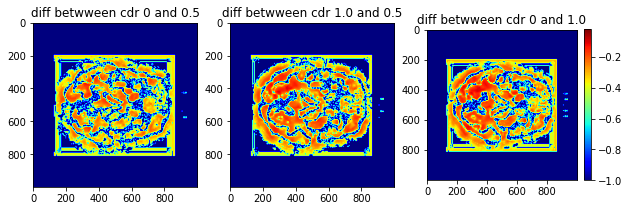

In [ ]:
from google.colab.patches import cv2_imshow # /media/shashanks/My Passport/documents/Master_Thesis_Backup/data/samples/13-07-exp2-mean/13-07-2020-09-45_mean_exp2/mean19_cdr0.0_Femaleoriginal_jet.png
import numpy as np
import skimage.io as sio
import matplotlib.pyplot as plt
#og1_cdr0=sio.imread('/content/drive/My Drive/BA_Estimation/results/sal_map/13-07-2020-09-45_mean_exp2/mean9_cdr0.0_Femaleoriginal_gray.png')
#og1_cdr0_5=sio.imread('/content/drive/My Drive/BA_Estimation/results/sal_map/13-07-2020-09-45_mean_exp2/mean9_cdr0.5_Femaleoriginal_gray.png')
# og1_cdr1=sio.imread('/content/drive/My Drive/BA_Estimation/results/sal_map/13-07-2020-09-45_mean_exp2/mean9_cdr1.0_Femaleoriginal_gray.png')
og1_cdr0=plt.imread('/content/OAS30884_MR_d2400_chunk_9Map_Combined.png')
og1_cdr0_5=plt.imread('/content/OAS30884_MR_d3204_chunk_9Map_Combined.png')
og1_cdr1=plt.imread('/content/OAS30884_MR_d4499_chunk_9Map_Combined.png')
print(og1_cdr0.shape)
og1_cdr0=np.mean(og1_cdr0,axis=-1)
og1_cdr0_5=np.mean(og1_cdr0_5,axis=-1)
og1_cdr1=np.mean(og1_cdr1,axis=-1)
# m = np.max([np.amax(np.abs(og1_cdr0)),np.amax(np.abs(og1_cdr0_5)),np.amax(np.abs(og1_cdr1))])
# if m==0:
#   m=1
# og1_cdr0= np.divide(og1_cdr0,m)
# og1_cdr0_5= np.divide(og1_cdr0_5,m)
# og1_cdr1= np.divide(og1_cdr1,m)

# og2_cdr0_5=sio.imread('/content/drive/My Drive/BA_Estimation/results/sal_map/12-07-2020-12-04/mean_chunk_9_cdr0.5_Male_Original.png')plt.imshow(diff_1,cmap='jet')
# og2_cdr1=sio.imread('/content/drive/My Drive/BA_Estimation/results/sal_map/12-07-2020-12-04/mean_chunk_9_cdr1.0_Male_Original.png')
#each of these mage are from 0-255

diff_1 = 20*np.log10(np.abs(np.subtract(og1_cdr0,og1_cdr0_5))+0.000001) #.astype(np.float32) / 255.0
diff_2 = 20*np.log10(np.abs(np.subtract(og1_cdr1,og1_cdr0_5))+0.000001)
diff_3 = 20*np.log10(np.abs(np.subtract(og1_cdr0,og1_cdr1))+0.000001)

m = np.max([np.amax(np.abs(diff_1)),np.amax(np.abs(diff_2)),np.amax(np.abs(diff_3))])
if m==0:
  m=1
diff_1= np.divide(diff_1,m)
diff_2= np.divide(diff_2,m)
diff_3= np.divide(diff_3,m)

vmin=np.amin([np.min(diff_1),np.min(diff_2),np.min(diff_3)])
vmax=np.amax([np.max(diff_1),np.max(diff_2),np.max(diff_3)])


  
  
# diff_2 = np.subtract(og2_cdr0_5,og2_cdr1) #.astype(np.float32) / 255.0
# diff_1 = og1_cdr0_5-og1_cdr0
# plt.imshow(og1_cdr0,cmap='gray')
# cv2_imshow(og1_cdr0)
# cv2_imshow(og1_cdr0_5)
# cv2_imshow(diff_1)#
# print(m)
f, axarr = plt.subplots(1,3,figsize=(10,10))

img_plot = axarr[0].imshow(diff_1,cmap='jet',vmin=vmin,vmax=vmax)
axarr[0].set_title('diff betwween cdr 0 and 0.5')
img_plot = axarr[1].imshow(diff_2,cmap='jet',vmin=vmin,vmax=vmax)
axarr[1].set_title('diff betwween cdr 1.0 and 0.5')
img_plot = axarr[2].imshow(diff_3,cmap='jet',vmin=vmin,vmax=vmax)
axarr[2].set_title('diff betwween cdr 0 and 1.0',)
plt.colorbar(img_plot,fraction=0.046, pad=0.04)
plt.savefig('/content/mean_diff_male_fig.png')
print('*********')
# cv2_imshow(og1_cdr0_5)
# cv2_imshow(og1_cdr1)
# cv2_imshow(diff_2)#,cmap='jet')

print('*********')
# cv2_imshow(og1_cdr0)
# cv2_imshow(og1_cdr1)
# cv2_imshow(diff_3)
# plt.imshow(diff_3,cmap='jet')
# print('*********')
# cv2_imshow(og2_cdr0_5)
# cv2_imshow(og2_cdr1)
# cv2_imshow(diff_2)

In [ ]:
import numpy as np
import skimage.io as sio
import matplotlib.pyplot as plt
im1=plt.imread('/content/OAS30884_MR_d2400_chunk_9Map_Combined.png')
im2=plt.imread('/content/OAS30884_MR_d4499_chunk_9Map_Combined.png')

# im1=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-11-34_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_3_tfw/OAS30884_MR_d2400_chunk_9Map_Combined.png')
# im2=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-11-34_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_chunk_9Map_Combined.png')
# im1=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-11-34_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_3_tfw/OAS30884_MR_d2400_chunk_9Map_Combined.png')
# im2=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-11-34_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_chunk_9Map_Combined.png')
# im1=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-11-34_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_3_tfw/OAS30884_MR_d2400_chunk_9Map_Combined.png')
# im2=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-11-34_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_chunk_9Map_Combined.png')
# im2=plt.imread('/content/OAS30884_MR_d4499_chunk_9mean_input_chunk.png')
diff_1 = np.abs(np.subtract(im1,im2))
diff_1=np.mean(diff_1,axis=-1)

FileNotFoundError: ignored

In [ ]:
print(im1.shape, im2.shape)

# diff_1=diff_1/np.max(diff_1)
# plt.imshow(diff_1,cmap='jet')
# plt.colorbar()

(1000, 1000, 4) (1000, 1000, 4)


In [ ]:

im1=plt.imread('/content/OAS30884_MR_d2400_chunk_9Map_Combined.png')
im2=plt.imread('/content/OAS30884_MR_d3204_chunk_9Map_Combined.png')
# im1=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-11-34_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_3_tfw/OAS30884_MR_d2400_chunk_9Map_Combined.png')
# im2=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-11-34_exp2/OAS30884_MR_d3204_cdr0.5/9_conv1_3_tfw/OAS30884_MR_d3204_chunk_9Map_Combined.png')
# im1=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-11-34_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_3_tfw/OAS30884_MR_d2400_chunk_9Map_Combined.png')
# im2=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-11-34_exp2/OAS30884_MR_d3204_cdr0.5/9_conv1_3_tfw/OAS30884_MR_d3204_chunk_9Map_Combined.png')
# im1=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-11-34_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_3_tfw/OAS30884_MR_d2400_chunk_9Map_Combined.png')
# im2=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-11-34_exp2/OAS30884_MR_d3204_cdr0.5/9_conv1_3_tfw/OAS30884_MR_d3204_chunk_9Map_Combined.png')

diff_2 = np.abs(np.subtract(im1,im2))
diff_2=np.mean(diff_2,axis=-1)

In [ ]:
im1=plt.imread('/content/OAS30884_MR_d4499_chunk_9Map_Combined.png')
im2=plt.imread('/content/OAS30884_MR_d3204_chunk_9Map_Combined.png')
# im1=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-11-34_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_chunk_9Map_Combined.png')
# im2=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-11-34_exp2/OAS30884_MR_d3204_cdr0.5/9_conv1_3_tfw/OAS30884_MR_d3204_chunk_9Map_Combined.png')
# im1=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-11-34_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_chunk_9Map_Combined.png')
# im2=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-11-34_exp2/OAS30884_MR_d3204_cdr0.5/9_conv1_3_tfw/OAS30884_MR_d3204_chunk_9Map_Combined.png')
# im1=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-11-34_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_chunk_9Map_Combined.png')
# im2=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-11-34_exp2/OAS30884_MR_d3204_cdr0.5/9_conv1_3_tfw/OAS30884_MR_d3204_chunk_9Map_Combined.png')

# im2=plt.imread('/content/OAS30884_MR_d3204_chunk_9mean_input_chunk.png')
print(im1.shape, im2.shape)
diff_3 = np.abs(np.subtract(im1,im2))
diff_3=np.mean(diff_3,axis=-1)
# diff_2=diff_2/np.max(diff_2)


# m=np.amax([np.max(np.log10(255*diff_1+0.0001)),np.log10(255*np.max(diff_2)+0.0001),np.log10(255*np.max(diff_3)+0.0001)])
m=np.amax([np.max(diff_1),np.max(diff_2),np.max(diff_3)])

(1000, 1000, 4) (1000, 1000, 4)


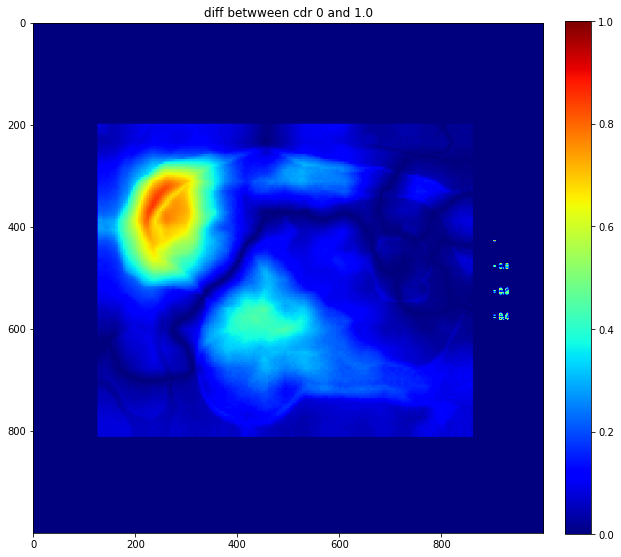

In [ ]:
f, axarr = plt.subplots(1,1,figsize=(10,10))
img_plot=axarr.imshow(diff_1/m,cmap='jet')
axarr.set_title('diff betwween cdr 0 and 1.0')
plt.colorbar(img_plot,fraction=0.046, pad=0.04)
# plt.savefig('OAS30884_cdr_1_0_coronal.png')
plt.savefig('OAS30884_cdr_1_0_axial.png')
# plt.savefig('OAS30884_cdr_1_0_sagittal.png')

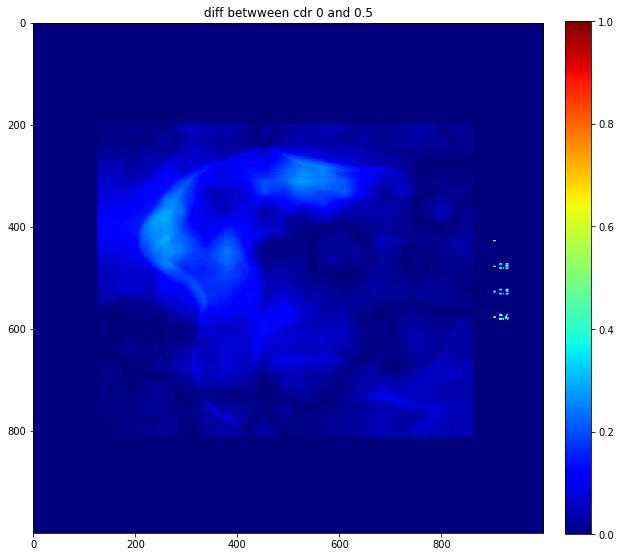

In [ ]:
f, axarr = plt.subplots(1,1,figsize=(10,10))
img_plot= axarr.imshow(diff_2/m,cmap='jet')
axarr.set_title('diff betwween cdr 0 and 0.5')
plt.colorbar(img_plot,fraction=0.046, pad=0.04)
plt.savefig('OAS30884_cdr_0.5_0_axial.png')
# plt.savefig('OAS30884_cdr_0.5_0_coronal.png')#coronalsagittal
# plt.savefig('OAS30884_cdr_0.5_0_sagittal.png')

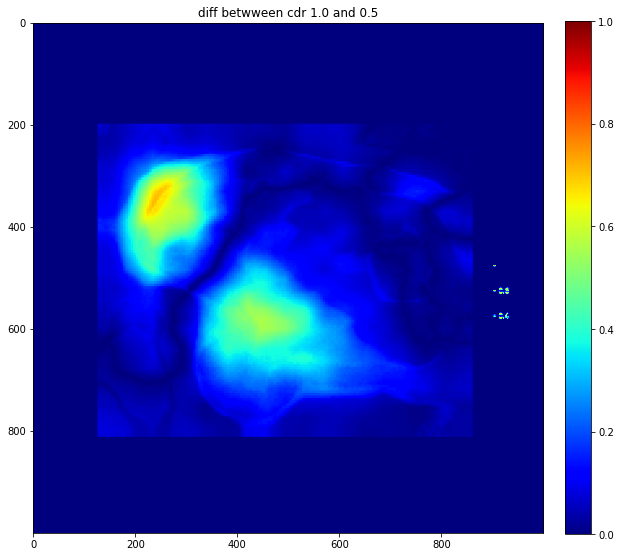

In [ ]:
f, axarr = plt.subplots(1,1,figsize=(10,10))
img_plot= axarr.imshow(diff_3/m,cmap='jet')
axarr.set_title('diff betwween cdr 1.0 and 0.5')
plt.colorbar(img_plot,fraction=0.046, pad=0.04)
# plt.savefig('OAS30884_cdr_0.5_1_sagittal.png')
# plt.savefig('OAS30884_cdr_0.5_1_coronal.png')
plt.savefig('OAS30884_cdr_0.5_1_axial.png')#sagittal

In [ ]:
from scipy.io import loadmat
# im1=loadmat('/content/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2result_gcam_pp.mat')
# im2=loadmat('/content/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2result_gcam_pp.mat')

# im1=loadmat('/content/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im2=loadmat('/content/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-21-28_exp2/OAS30884_MR_d2400_cdr0.0/7_conv1_3_tfw/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-11-34_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2result_gcam_pp.mat')
# im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-21-28_exp2/OAS30884_MR_d2400_cdr0.0/7_conv1_3_tfw/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-21-28_exp2/OAS30884_MR_d4499_cdr1.0/7_conv1_3_tfw/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-11-34_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-21-28_exp2/OAS30884_MR_d2400_cdr0.0/7_conv1_3_tfw/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-21-28_exp2/OAS30884_MR_d4499_cdr1.0/7_conv1_3_tfw/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-11-34_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_3_tfw/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2result_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-11-34_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2result_gcam_pp.mat')
# im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-11-34_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_3_tfw/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2result_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-11-34_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2result_gcam_pp.mat')
im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-21-28_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_3_tfw/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2heatmap_gcam_pp.mat')
im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-21-28_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2heatmap_gcam_pp.mat')
diff_1 = np.abs(np.subtract(im1['data'],im2['data']))
diff_1=np.mean(diff_1,axis=-1)

In [ ]:
# im1=loadmat('/content/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2result_gcam_pp.mat')
# im2=loadmat('/content/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2result_gcam_pp.mat')
# im1=loadmat('/content/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im2=loadmat('/content/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2heatmap_gcam_pp.mat')
# im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-11-34_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_3_tfw/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2result_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-11-34_exp2/OAS30884_MR_d3204_cdr0.5/9_conv1_3_tfw/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2result_gcam_pp.mat')
# im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-21-28_exp2/OAS30884_MR_d2400_cdr0.0/7_conv1_3_tfw/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-21-28_exp2/OAS30884_MR_d3204_cdr0.5/7_conv1_3_tfw/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2heatmap_gcam_pp.mat')
# im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-21-28_exp2/OAS30884_MR_d2400_cdr0.0/7_conv1_3_tfw/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-21-28_exp2/OAS30884_MR_d3204_cdr0.5/7_conv1_3_tfw/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2heatmap_gcam_pp.mat')
# im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-11-34_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_3_tfw/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2result_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-11-34_exp2/OAS30884_MR_d3204_cdr0.5/9_conv1_3_tfw/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2result_gcam_pp.mat')
# im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-11-34_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_3_tfw/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2result_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-11-34_exp2/OAS30884_MR_d3204_cdr0.5/9_conv1_3_tfw/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2result_gcam_pp.mat')
im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-21-28_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_3_tfw/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2heatmap_gcam_pp.mat')
im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-21-28_exp2/OAS30884_MR_d3204_cdr0.5/9_conv1_3_tfw/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2heatmap_gcam_pp.mat')
diff_2 = np.abs(np.subtract(im1['data'],im2['data']))
diff_2=np.mean(diff_2,axis=-1)

In [ ]:


# im1=loadmat('/content/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2result_gcam_pp.mat')
# im2=loadmat('/content/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2result_gcam_pp.mat')
# im1=loadmat('/content/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im2=loadmat('/content/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2heatmap_gcam_pp.mat')
# im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-21-28_exp2/OAS30884_MR_d4499_cdr1.0/7_conv1_3_tfw/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-21-28_exp2/OAS30884_MR_d3204_cdr0.5/7_conv1_3_tfw/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2heatmap_gcam_pp.mat')
# im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-21-28_exp2/OAS30884_MR_d4499_cdr1.0/7_conv1_3_tfw/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/26-07-2020-21-28_exp2/OAS30884_MR_d3204_cdr0.5/7_conv1_3_tfw/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2heatmap_gcam_pp.mat')
# im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-11-34_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2heatmap_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-11-34_exp2/OAS30884_MR_d3204_cdr0.5/9_conv1_3_tfw/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2heatmap_gcam_pp.mat')
# im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-11-34_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2result_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/26-07-2020-11-34_exp2/OAS30884_MR_d3204_cdr0.5/9_conv1_3_tfw/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2result_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-11-34_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2result_gcam_pp.mat')
# im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-11-34_exp2/OAS30884_MR_d3204_cdr0.5/9_conv1_3_tfw/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2result_gcam_pp.mat')
im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-21-28_exp2/OAS30884_MR_d4499_cdr1.0/9_conv1_3_tfw/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2heatmap_gcam_pp.mat')
im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-21-28_exp2/OAS30884_MR_d3204_cdr0.5/9_conv1_3_tfw/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2heatmap_gcam_pp.mat')
diff_3 = np.abs(np.subtract(im1['data'],im2['data']))

diff_3=np.mean(diff_3,axis=-1)
m=np.amax([np.max(diff_1),np.max(diff_2),np.max(diff_3)])

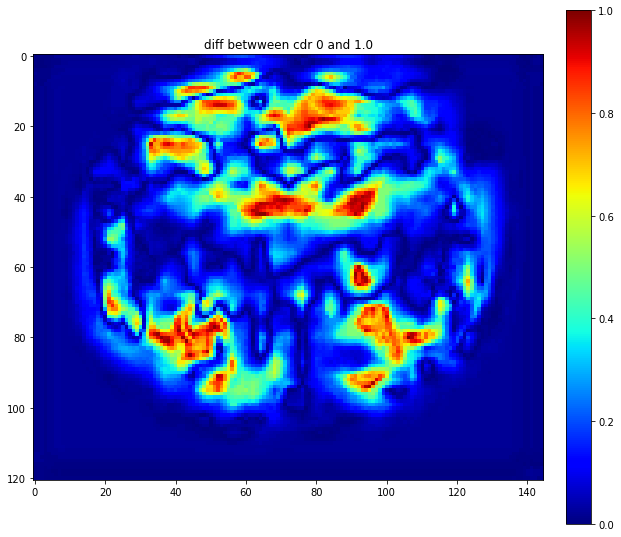

In [ ]:
f, axarr = plt.subplots(1,1,figsize=(10,10))
img_plot=axarr.imshow(diff_1/m,cmap='jet')
axarr.set_title('diff betwween cdr 0 and 1.0')
plt.colorbar(img_plot,fraction=0.046, pad=0.04)
# plt.savefig('OAS30884_cdr_cdr_1_0_axial.png')#axial coronal sagittal
# plt.savefig('OAS30884_cdr_cdr_1_0_coronal.png')
plt.savefig('OAS30884_cdr_cdr_1_0_sagittal.png')

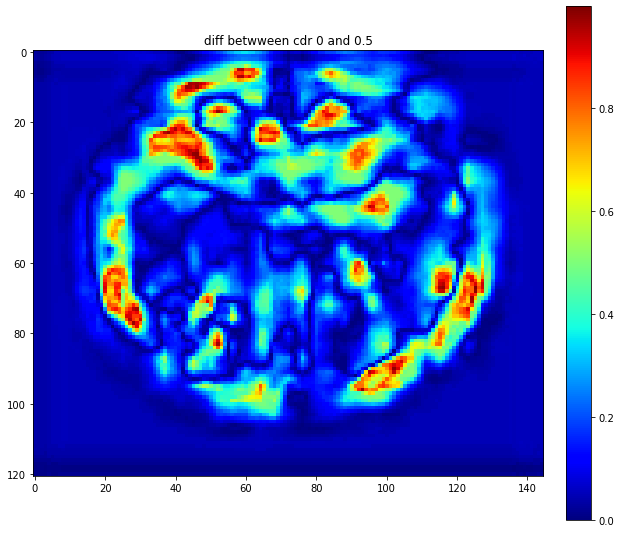

In [ ]:
f, axarr = plt.subplots(1,1,figsize=(10,10))
img_plot= axarr.imshow(diff_2/m,cmap='jet')
axarr.set_title('diff betwween cdr 0 and 0.5')
plt.colorbar(img_plot,fraction=0.046, pad=0.04)
# plt.savefig('OAS30884_cdr_cdr_0.5_0_axial.png')#coronal
# plt.savefig('OAS30884_cdr_cdr_0.5_0_coronal.png')
plt.savefig('OAS30884_cdr_cdr_0.5_0_sagittal.png')

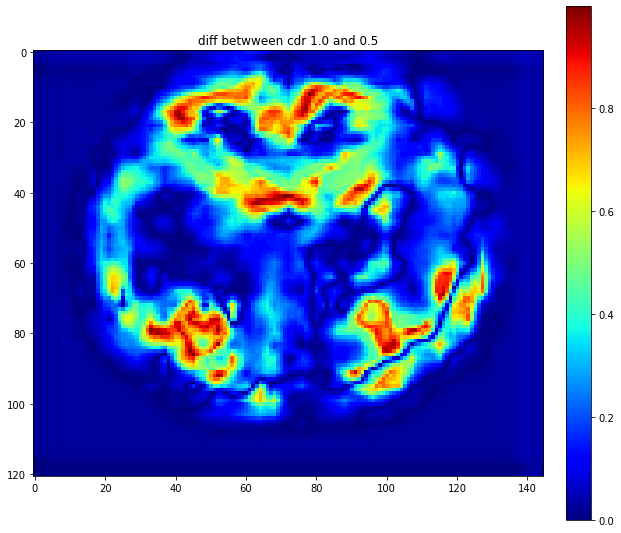

In [ ]:
f, axarr = plt.subplots(1,1,figsize=(10,10))
img_plot= axarr.imshow(diff_3/m,cmap='jet')
axarr.set_title('diff betwween cdr 1.0 and 0.5')
plt.colorbar(img_plot,fraction=0.046, pad=0.04)
# plt.savefig('OAS30884_cdr_cdr_0.5_1_axial.png')
# plt.savefig('OAS30884_cdr_cdr_1_0.5_coronal.png')
plt.savefig('OAS30884_cdr_cdr_1_0.5_sagittal.png')

In [2]:
import numpy as np
import skimage.io as sio
import matplotlib.pyplot as plt
from scipy.io import loadmat
import os

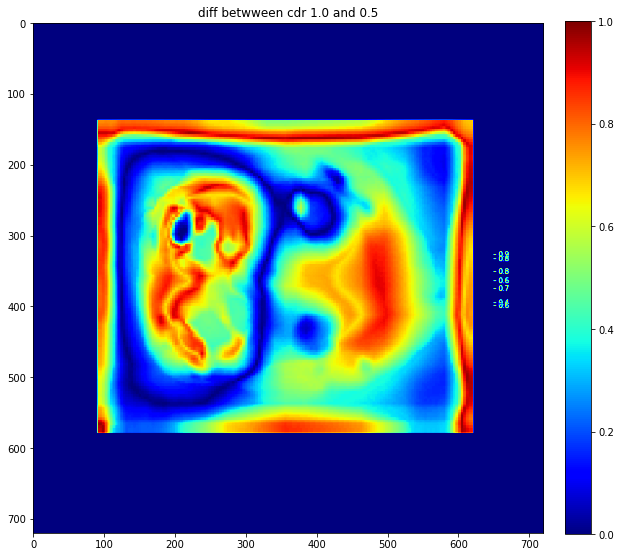

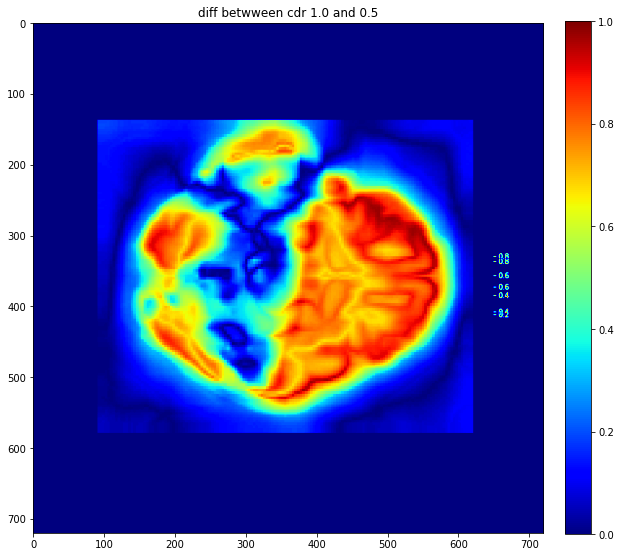

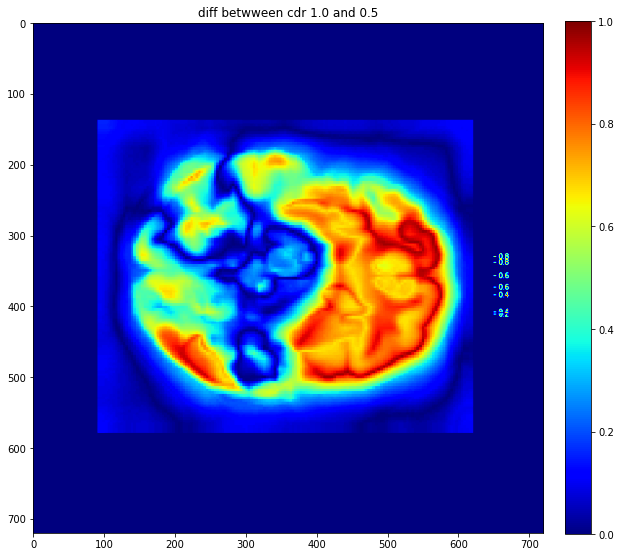

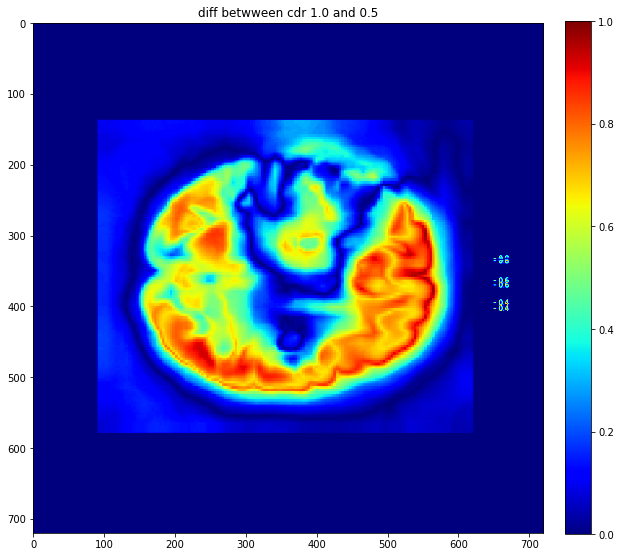

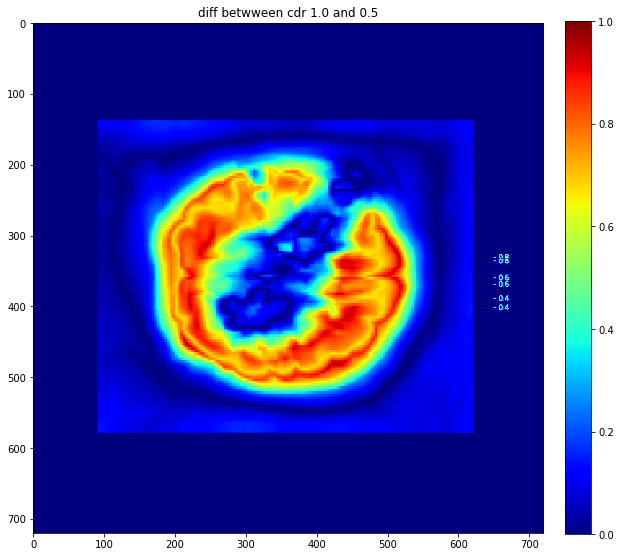

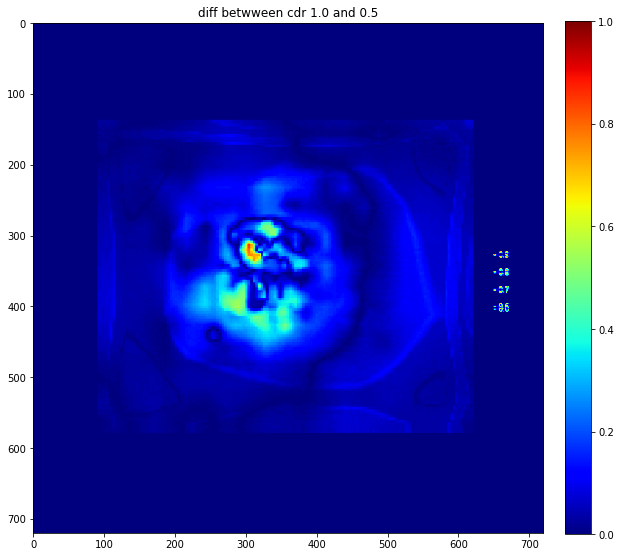

In [31]:


plane='axial'
# plane='coronal'
# plane='sagittal'
p3='OAS30720_MR_d0566'
p2='OAS30720_MR_d4213'

# p1='OAS30884_MR_d2400'
# p2='OAS30884_MR_d4499'
# p3='OAS30884_MR_d3204'

# p1='OAS30344_MR_d0049'
# p3='OAS30344_MR_d2375'

pat=p3.split('_')[0]
# t='heatmap'
# t='result'
t='Map_Combined'
for c in [3,7,9,11,14,18]: #range(1,21):
  
#/content/drive/My Drive/BA_Estimation/results/sal_map_axial/31-07-2020-12-03_exp2
#/content/drive/My Drive/BA_Estimation/results/sal_map_axial/02-08-2020-12-09_exp4
#/content/drive/My Drive/BA_Estimation/results/sal_map_axial/02-08-2020-12-09_exp4/OAS30720_MR_d0069_cdr1.0/9_conv1_66_blockend_scale_endlayers_equal_weights
  im1=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_{0}/05-08-2020-10-09_exp2/{1}_cdr0.0/{2}_conv1_66_blockend_scale_endlayers_equal_weights/{1}_chunk_{2}{3}.png'.format(plane,p1,c,t))
  im2=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_{0}/05-08-2020-10-09_exp2/{1}_cdr1.0/{2}_conv1_66_blockend_scale_endlayers_equal_weights/{1}_chunk_{2}{3}.png'.format(plane,p2,c,t))
  im3=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_{0}/05-08-2020-10-09_exp2/{1}_cdr0.5/{2}_conv1_66_blockend_scale_endlayers_equal_weights/{1}_chunk_{2}{3}.png'.format(plane,p3,c,t))
  
  # im1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_{0}/05-08-2020-10-09_exp2/{1}_cdr0.0/{2}_conv1_66_blockend_scale_endlayers_equal_weights/{1}_cdr0.0_Male_activation_65{3}_gcam_pp.mat'.format(plane,p1,c,t))#conv3d
  # im2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_{0}/05-08-2020-10-09_exp2/{1}_cdr1.0/{2}_conv1_66_blockend_scale_endlayers_equal_weights/{1}_cdr1.0_Male_activation_65{3}_gcam_pp.mat'.format(plane,p2,c,t))
  # im3=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map_{0}/05-08-2020-10-09_exp2/{1}_cdr0.5/{2}_conv1_66_blockend_scale_endlayers_equal_weights/{1}_cdr0.5_Male_activation_65{3}_gcam_pp.mat'.format(plane,p3,c,t))
  
  
  base_path='/content/drive/My Drive/BA_Estimation/results/sal_map_{0}/05-08-2020-10-09_exp2/{1}_diff/{2}_conv1_66_blockend_scale_endlayers_equal_weights/diff/'.format(plane,pat,c)
  
  # diff_1 = np.abs(np.subtract(im1,im2))
  # diff_2 = np.abs(np.subtract(im1,im3))
  diff_3 = np.abs(np.subtract(im3,im2))

  # diff_1 = np.abs(np.subtract(im1['data'],im2['data']))
  # diff_2 = np.abs(np.subtract(im1['data'],im3['data']))
  # diff_3 = np.abs(np.subtract(im3['data'],im2['data']))

  # diff_1=np.mean(diff_1,axis=-1)

  
  # diff_2=np.mean(diff_2,axis=-1)

  
  diff_3=np.mean(diff_3,axis=-1)


  # m=np.amax([np.max(diff_1),np.max(diff_2),np.max(diff_3)])
  m= np.max(diff_3)#np.amax([np.max(diff_1),np.max(diff_2),np.max(diff_3)])

  if not os.path.exists(base_path):
    os.makedirs(base_path)

  # f, axarr = plt.subplots(1,1,figsize=(10,10))
  # img_plot=axarr.imshow(diff_1/m,cmap='jet')
  # axarr.set_title('diff betwween cdr 0 and 1.0')
  # plt.colorbar(img_plot,fraction=0.046, pad=0.04)
  # plt.savefig(base_path+'{0}_cdr_1_0_{1}_diff_{2}.png'.format(pat,plane,t))

  # f, axarr = plt.subplots(1,1,figsize=(10,10))
  # img_plot= axarr.imshow(diff_2/m,cmap='jet')
  # axarr.set_title('diff betwween cdr 0 and 0.5')
  # plt.colorbar(img_plot,fraction=0.046, pad=0.04)
  # plt.savefig(base_path+'{0}_cdr_0.5_0_{1}_diff_{2}.png'.format(pat,plane,t))

  f, axarr = plt.subplots(1,1,figsize=(10,10))
  img_plot= axarr.imshow(diff_3/m,cmap='jet')
  axarr.set_title('diff betwween cdr 1.0 and 0.5')
  plt.colorbar(img_plot,fraction=0.046, pad=0.04)
  plt.savefig(base_path+'{0}_cdr_1_0.5_{1}_diff_{2}.png'.format(pat,plane,t))

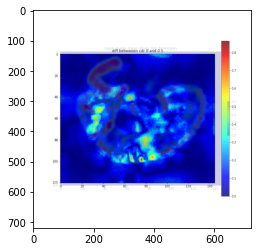

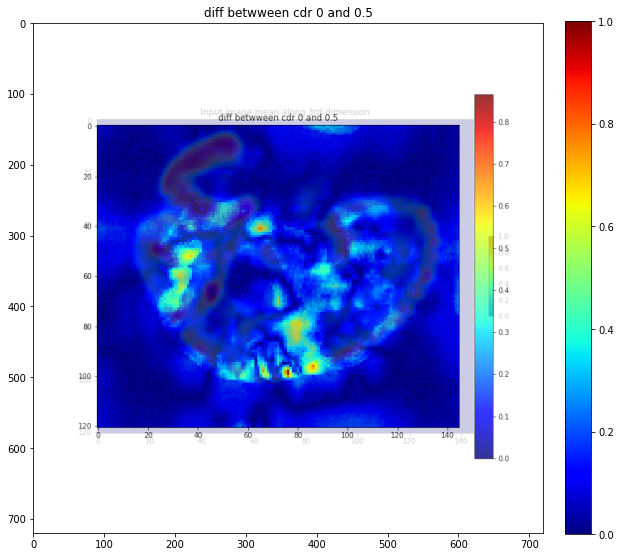

In [ ]:
# input=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/29-07-2020-18-16_exp2/OAS30720_MR_d0566_cdr0.5/9_conv1_66_tfw/OAS30720_MR_d0566_chunk_9mean_input_chunk.png')
# map= plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_axial/29-07-2020-18-16_exp2/OAS30720_MR_d0566_cdr0.5/9_conv1_66_tfw/OAS30720_MR_d0566_chunk_9Map_Combined.png')
# map=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-21-28_exp2/OAS30884_diff/9_conv1_3_tfw/diff/OAS30884_cdr_1_0_coronal_diff_Map_Combined.png')
# input=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-21-28_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_3_tfw/OAS30884_MR_d2400_chunk_9mean_input_chunk.png')
#OAS30884_1_0.5_axial_diff_heatmap.png
map=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/31-07-2020-12-03_exp2/OAS30884_diff/9_conv1_66_blockend_scale_endlayers_equal_weights/diff/OAS30884_cdr_0.5_0_sagittal_diff_heatmap.png')
input=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_sagittal/31-07-2020-12-03_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_66_blockend_scale_endlayers_equal_weights/OAS30884_MR_d2400_chunk_9mean_input_chunk.png')
# plane='coronal'
# plane='axial'
plane='sagittal'
# map=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_{0}/31-07-2020-12-03_exp2/OAS30720_diff/9_conv1_66_blockend_scale_endlayers_equal_weights/diff/OAS30720_cdr_1_0.5_{0}_diff_heatmap.png'.format(plane))
# input=plt.imread('/content/drive/My Drive/BA_Estimation/results/sal_map_{0}/31-07-2020-12-03_exp2/OAS30884_MR_d2400_cdr0.0/9_conv1_66_blockend_scale_endlayers_equal_weights/OAS30720_MR_d0566_chunk_9mean_input_chunk.png'.format(plane))

blend=input*0.2+map*0.8

pat='OAS30884'

t='heatmap'
# plt.colorbar()
m=np.max(blend)
plt.imshow(blend/m)
f, axarr = plt.subplots(1,1,figsize=(10,10))
img_plot= axarr.imshow(blend/m,cmap='jet')
axarr.set_title('diff betwween cdr 0 and 0.5')
plt.colorbar(img_plot,fraction=0.046, pad=0.04)
base_path='/content/drive/My Drive/BA_Estimation/results/sal_map_{0}/31-07-2020-12-03_exp2/{1}_diff/'.format(plane,pat)
plt.savefig(base_path+'{0}_0.5_0_{1}_diff_{2}_overlay_on_normal.png'.format(pat,plane,t))

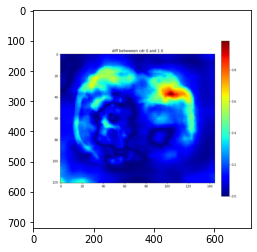

In [ ]:
plt.imshow(map)

In [ ]:
m,diff_2.shape

(0.5245098, (720, 720))

In [ ]:
os.listdir('/content/drive/My Drive/BA_Estimation/results/sal_map_{0}/26-07-2020-20-50_exp4/{1}_cdr0.0/{2}_conv1_3_tfw/'.format(plane,p1,c))

FileNotFoundError: ignored

In [ ]:
np.array_equal(diff_1/m,diff_2/m)
# OAS30884_MR_d2400_chunk_1Map_Combined.png  OAS30344_MR_d0049_cdr0.0_Male_conv3d_2gcam_pp_img.mat
base_path

'/content/drive/My Drive/BA_Estimation/results/sal_map_coronal/26-07-2020-21-28_exp2/OAS30884_diff/20_conv1_3_tfw/diff/'

In [ ]:
diff_1.shape,np.max(diff_1)

((1000, 1000), 0.75)

In [ ]:
np.max(og1_cdr1)

255

In [ ]:
vmin,vmax

(0.0, 1.0)

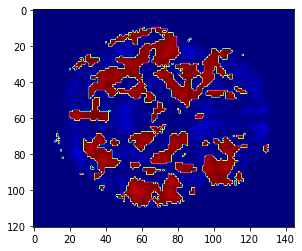

In [ ]:
plt.imshow(diff_2,cmap='jet',vmin=vmin,vmax=vmax)

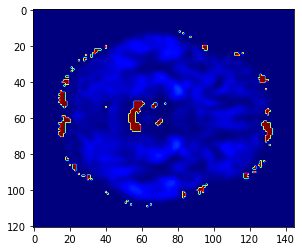

In [ ]:
plt.imshow(diff_3,cmap='jet',vmin=vmin,vmax=vmax)

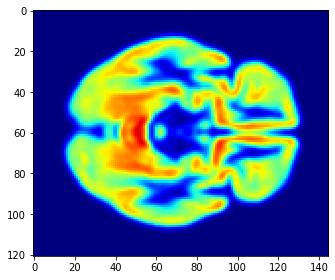

In [ ]:
sio.imshow(og1_cdr1,cmap='jet')

In [ ]:
np.min([np.amin(np.abs(diff_1)),np.amin(np.abs(diff_2)),np.amin(np.abs(diff_3))])

0.0

In [ ]:
a=np.array([[1,-1],[-3,-2],[9,-7]])
np.abs(a)

array([[1, 1],
       [3, 2],
       [9, 7]])

In [ ]:
np.subtract(og1_cdr1,og1_cdr0_5).min(),og1_cdr1.min()

(0, 0)

In [ ]:
og1_cdr0.shape

(121, 145)

In [ ]:
# type(og1_cdr0[0,0,0])
diff_1.shape,diff_2.shape,og1_cdr0.shape,og2_cdr1.shape

((121, 145), (121, 145), (121, 145), (121, 145))

In [ ]:
cmap='jet'
# cmap='gray'
chunk =20
dt_string='13-07-2020-09-45' #mean_chunk_18_cdr0.0_Male_Original.png
diff_path='/content/drive/My Drive/BA_Estimation/screenshots/'+dt_string+'_female_chunk_'+str(chunk)+'_'+cmap
plt.imsave(diff_path+'_diff_0_05.png',diff_1,cmap=cmap)
plt.imsave(diff_path+'_diff_05_1.png',diff_2,cmap=cmap)
plt.imsave(diff_path+'_diff_0_1.png',diff_3,cmap=cmap)
# im1=sio.imread('/content/drive/My Drive/BA_Estimation/screenshots/diff1.png')
# im2=sio.imread('/content/drive/My Drive/BA_Estimation/screenshots/diff2.png')
# cv2_imshow(im1)
# cv2_imshow(im2)

#**Normalized max intensity mean images**

In [ ]:
# normalize with max intensity across cdr for each mri volumne slice
from matplotlib import pyplot as plt
import skimage.io as sio
import numpy as np

chunk =20
cmap='jet'
gender='Female'
dt_string= '15-07-2020-00-21_mean_exp2' #'13-07-2020-09-45_mean_exp2_old'
print('Overall_Maxima|individual_maxima(cdr0,0.5,1)')
# max_normalized_path = 
for chunk in range(1,21):
  cdr0_path='/content/drive/My Drive/BA_Estimation/results/sal_map/'+dt_string+'/mean_chunk_'+str(chunk)+'_cdr0.0_'+gender+'_Original.png'
  cdr05_path='/content/drive/My Drive/BA_Estimation/results/sal_map/'+dt_string+'/mean_chunk_'+str(chunk)+'_cdr0.5_'+gender+'_Original.png'
  cdr1_path='/content/drive/My Drive/BA_Estimation/results/sal_map/'+dt_string+'/mean_chunk_'+str(chunk)+'_cdr1.0_'+gender+'_Original.png'
  # cdr0_path='/content/drive/My Drive/BA_Estimation/results/sal_map/'+dt_string+'/mean_chunk_'+str(chunk)+'_cdr0.0_'+gender+'_Original_plt_gray.png'
  # cdr05_path='/content/drive/My Drive/BA_Estimation/results/sal_map/'+dt_string+'/mean_chunk_'+str(chunk)+'_cdr0.5_'+gender+'_Original_plt_gray.png'
  # cdr1_path='/content/drive/My Drive/BA_Estimation/results/sal_map/'+dt_string+'/mean_chunk_'+str(chunk)+'_cdr1.0_'+gender+'_Original_plt_gray.png'

  # cdr0_path='/content/drive/My Drive/BA_Estimation/results/sal_map/'+dt_string+'/mean'+str(chunk)+'_cdr0.0_'+gender+'original_jet.png'
  # cdr05_path='/content/drive/My Drive/BA_Estimation/results/sal_map/'+dt_string+'/mean'+str(chunk)+'_cdr0.5_'+gender+'original_jet.png'
  # cdr1_path='/content/drive/My Drive/BA_Estimation/results/sal_map/'+dt_string+'/mean'+str(chunk)+'_cdr1.0_'+gender+'original_jet.png'

  cdr0_im = sio.imread(cdr0_path) #[:,:,0] use these indices incase image was saved using matplotlib ie RGB-Alpha format ,incase of skimage indices not required
  print(cdr0_im.shape)
  cdr05_im = sio.imread(cdr05_path)#[:,:,0]
  cdr1_im = sio.imread(cdr1_path) #[:,:,0]

  m = np.max([np.amax(np.abs(cdr0_im)),np.amax(np.abs(cdr05_im)),np.amax(np.abs(cdr1_im))])
  mn = np.min([np.amin(np.abs(cdr0_im)),np.amin(np.abs(cdr05_im)),np.amin(np.abs(cdr1_im))])
  
  print(m,(np.amax(np.abs(cdr0_im)),np.amax(np.abs(cdr05_im)),np.amax(np.abs(cdr1_im))))
  print('Minimas')
  print(mn,np.amin(np.abs(cdr0_im)),np.amin(np.abs(cdr05_im)),np.amin(np.abs(cdr1_im)))
  if m==0: # avoid divide by zero
    m=1.0
  # cdr0_im_normalized = cdr0_im/m #np.divide(cdr0_im,m)
  # cdr05_im_normalized = cdr05_im/m #np.divide(cdr05_im,m)
  # cdr1_im_normalized = cdr1_im/m  #np.divide(cdr1_im,m)
  cdr0_im_normalized = np.divide(cdr0_im,m)
  cdr05_im_normalized = np.divide(cdr05_im,m)
  cdr1_im_normalized = np.divide(cdr1_im,m)

  # cdr0_im_normalized = np.divide(cdr0_im-mn,m-mn)
  # cdr05_im_normalized = np.divide(cdr05_im-mn,m-mn) as all minimas are 0 so this doesn't matter
  # cdr1_im_normalized = np.divide(cdr1_im-mn,m-mn)

  cdr0_npath='/content/drive/My Drive/BA_Estimation/results/max_intensity_normalized_mri_volumes/'+dt_string+'/mean_chunk_'+str(chunk)+'_cdr0.0_'+gender+'_normalized'+cmap+'.png'
  cdr05_npath='/content/drive/My Drive/BA_Estimation/results/max_intensity_normalized_mri_volumes/'+dt_string+'/mean_chunk_'+str(chunk)+'_cdr0.5_'+gender+'_normalized'+cmap+'.png'
  cdr1_npath='/content/drive/My Drive/BA_Estimation/results/max_intensity_normalized_mri_volumes/'+dt_string+'/mean_chunk_'+str(chunk)+'_cdr1.0_'+gender+'_normalized'+cmap+'.png'

  plt.imsave(cdr0_npath,cdr0_im_normalized,cmap=cmap)
  plt.imsave(cdr05_npath,cdr05_im_normalized,cmap=cmap)
  plt.imsave(cdr1_npath,cdr1_im_normalized,cmap=cmap)
  # cdr01_sub = np.abs(np.subtract(cdr0_im_normalized,cdr1_im_normalized))




  



Overall_Maxima|individual_maxima(cdr0,0.5,1)
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121, 145, 4)
255 (255, 255, 255)
Minimas
0 0 0 0
(121,

In [ ]:
# cdr01_sub_old = np.abs(np.subtract(cdr0_im,cdr1_im))

In [ ]:
np.amin(cdr1_im)

0

TypeError: ignored

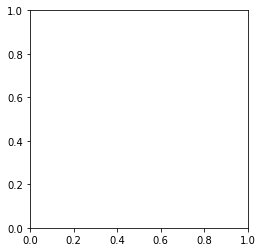

In [ ]:
plt.imshow(cdr1_im_normalized,cmap='jet')

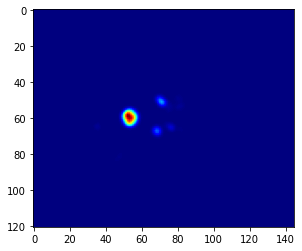

In [ ]:
plt.imshow(cdr0_im[:,:,1],cmap='jet')

In [ ]:
np.array_equal(cdr1_im,cdr1_im_normalized)

False

255

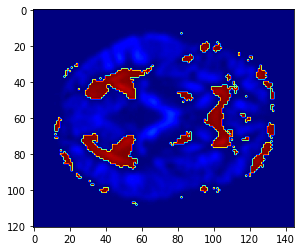

In [ ]:
plt.imshow(cdr01_sub_old,cmap='jet')
np.amax(cdr01_sub_old)

0.24352331606217614

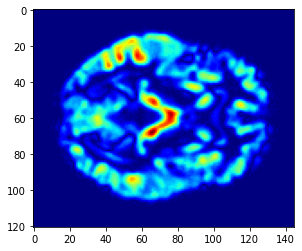

In [ ]:
plt.imshow(cdr01_sub,cmap='jet')
np.amax(cdr01_sub)

In [ ]:
import os
l=os.listdir('/content/drive/My Drive/BA_Estimation/results/max_intensity_normalized_mri_volumes/'+dt_string)
len(l)

120

In [ ]:
sio.imread('/content/drive/My Drive/BA_Estimation/results/sal_map/12-07-2020-11-26/OAS30524_MR_d0198_chunk_9_cdr0.0_Female_Original.png').shape

(121, 145)

In [ ]:
np.array_equal(diff_2,np.zeros(shape=diff_2.shape)),og1_cdr0_5.shape
plt.imsave('/content/diff2.png',diff_2)

In [ ]:
# dt_string
from scipy.io import savemat,loadmat

#**Mean CDR saliency map generation**

In [ ]:
#for mean chunks based on cdr and gender
from scipy.io import savemat,loadmat
from collections import defaultdict
from datetime import datetime
dt_string = datetime.now().strftime('%d-%m-%Y-%H-%M')

base_dir= '/content/drive/My Drive/BA_Estimation/results/sal_map/'+dt_string+'_mean_exp2'+'/'
if not os.path.exists(base_dir):
  os.makedirs(base_dir)
# for chunk_id in range(1,21):
gender_dict={0:'Female',1:'Male'}
gender_cdr_chunk_dict = defaultdict(lambda: defaultdict(lambda: defaultdict(list)))
gender_cdr_full_dict = defaultdict(lambda: defaultdict(list))
for i,im in enumerate(img_tf):
  print(type(im),im.shape)
  img=im.numpy()
  gender_cdr_full_dict[test_gender[i]][test_cdr[i]].append(img)
  
  #comment below loop if we only need .mat files of full tensor 121,145,121
  for chunk_id in range(1,21):
 
    # base_dir= '/content/drive/My Drive/BA_Estimation/results/sal_map/'+dt_string+'/'+str(chunk_id)+'/'
    # if not os.path.exists(base_dir):
    #   os.makedirs(base_dir)
    start = (chunk_id-1)*6
    end = chunk_id*6
    img_chunk= torch.tensor(img[:,:,start:end])
    img_chunk = img_chunk.unsqueeze(0)#channel
    input_tensor = img_chunk.unsqueeze(0)#batch
    gender_cdr_chunk_dict[[i]][test_cdr[i]][chunk_id].append(input_tensor.numpy())
# gender_cdr_chunk_dict = gender_cdr_full_dict 
for g in gender_cdr_chunk_dict.keys():
        print(f'Gender = {g}')
        for cdr,_ in gender_cdr_chunk_dict[g].items():
            print(f'CDR = {cdr}')
            full_imgs = np.array(gender_cdr_full_dict[g][cdr])
            full_mean = np.mean(full_imgs,axis=0)
            print(full_imgs.shape,full_mean.shape)
            matpath =  '/content/drive/My Drive/BA_Estimation/screenshots/'
            savemat(matpath+'full_img_mean_cdr'+str(cdr)+'_'+gender_dict[g]+'.mat',{'data': full_mean,'shape':full_mean.shape})
            # comment below loop if we only need .mat files of full tensor 121,145,121
            for chunk_index,imgs in gender_cdr_chunk_dict[g][cdr].items():
                print(f'Chunk Number = {chunk_index}')
                imgs=np.array(imgs)
                img_tensor =  torch.mean(torch.from_numpy(imgs),axis=0)
                # print(f'img_tensor shape={imgs.shape}')
                print(f'mean tensor shape={img_tensor.shape}')
                
                # ### only  for saving jet and gray scale input mris
                # input_tensor=torch.from_numpy(img_tensor.numpy())
                # output_path = base_dir + 'mean'+str(chunk_index)+'_cdr'+str(cdr)+'_'+gender_dict[g]+'original_'
                # plt.imsave(output_path+'gray.png',torch.mean(input_tensor[0,:,:,:,:],axis=-1)[0].numpy(),cmap='gray')
                # plt.imsave(output_path+'jet.png',torch.mean(input_tensor[0,:,:,:,:],axis=-1)[0].numpy(),cmap='jet')
                ###
                # layer_name='conv3d_2'
                # csmap=compute_fastcam_saliency(base_dir,[input_tensor,test_gender[i]],final_model,scan_ids[i],str(chunk_id)+'_cdr'+str(test_cdr[i])+'_'+gender_dict[test_gender[i]])
                # image,gcam_img,gcam_pp_img = compute_gcam_and_gcam_pp(layer_name,tf_model,[imgs[:,:,start:end],test_gender[i]])
                # combine_sal_gcam(base_dir+scan_ids[i]+'_cdr'+str(test_cdr[i])+'_'+gender_dict[test_gender[i]],csmap,gcam_img,gcam_pp_img,image,layer_name=layer_name )
                compute_fastcam_saliency(base_dir,[img_tensor,g],final_model,'mean',str(chunk_index)+'_cdr'+str(cdr)+'_'+gender_dict[g])
                
            #     ####
                
  

NameError: ignored

In [ ]:
gender_cdr_full_dict.keys()

dict_keys([])

In [ ]:
loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map/16-07-2020-21-25_mean_exp2/mean_chunk_9_cdr0.0_Female_MAP_COMBINED.mat')

#**Gradcam/++ with Saliency maps**

In [ ]:


import cv2
import numpy as np
# LAYER_NAME='conv3d'
def get_grads(layer_name,tf_model,inputs):

  cam_list=[]
  gender= inputs[1] #tf.constant([[1]],dtype=tf.float32)
  gender=tf.reshape(gender,[1,1])
  img=inputs[0]
  grad_model = tf.keras.models.Model([tf_model.inputs], [tf_model.get_layer(name=layer_name).output, tf_model.output])
  # for i in range(48,54,6):
  # end=start+6
  # print(f'{start,end}')
  # img_chunk2=
  img_chunk=tf.convert_to_tensor(img)
  img_chunk = tf.reshape(img_chunk,[1,121,145,6])
  # cdr_pred_dict={0:[1.0,0.0,0.0,0.0],1:[0.0,1.0,0.0,0.0],2:[0.0,0.0,1.0,0.0],3:[0.0,0.0,0.0,1.0]}
  cdr_ohe_dict={0:[1.0,0.0,0.0,0.0],0.5:[0.0,1.0,0.0,0.0],1:[0.0,0.0,1.0,0.0],2:[0.0,0.0,0.0,1.0]}
  cdr_keys= list(cdr_ohe_dict.keys())
  with tf.GradientTape() as tape:
      conv_outputs, predictions = grad_model([img_chunk,gender])
      print(f'predictions={predictions}')
      loss=predictions
      # loss = predictions[0]
      # predictions=np.argmax(predictions[0])#[::-1]
      # print(f'sorted args={predictions}')
      # loss = tf.convert_to_tensor(cdr_ohe_dict[cdr_keys[predictions]],dtype=tf.float32)#[0][0]#[:, :]
      # print(loss,type(loss))
      # loss=tf.convert_to_tensor(np.max(predictions),dtype=tf.float32)
  output = conv_outputs[0]#[0,:,:,:,100]
  print(f'entering tape gradients')
  # grads = tape.gradient(loss, conv_outputs)[0]
  grads = tape.gradient(loss, conv_outputs)[0]#[0,:,:,:,100]
  print(type(grads))
  print(f'Crossed tape gradients')
  gate_f = tf.cast(output > 0, 'float32')
  gate_r = tf.cast(grads > 0, 'float32')
  # now there are 2 choice either use grads(raw grads) or use guided grads)
  guided_grads = tf.cast(output > 0, 'float32') * tf.cast(grads > 0, 'float32') * grads

  print(f'Entering reduce mean using guided_grads with shape={guided_grads.shape}')
  #guided grads
  weights = tf.reduce_mean(guided_grads, axis=(0,1,2))


  print(f'Computing CAM using output with shape:{output.shape}')

  print(f'weights={weights.shape}')
  cam = np.zeros(output.shape[0:3], dtype=np.float32)
  print(cam.shape)


  cam=tf.reduce_sum(tf.multiply(output,weights),axis=-1)
  cam_list.append(cam)
  return cam_list,grads,loss,weights,output,img_chunk

In [ ]:
from skimage.transform import resize
from matplotlib import pyplot as plt
import os
import torch
# p='/content/drive/My Drive/Uni-Sem4/'+mname+'/layer_'+LAYER_NAME+'/'

def compute_gcam_and_gcam_pp(layer_name,model,inputs):
  # print(f'{inputs[0].shape,inputs[1].shape}')
  cam_list,grads,loss,weights,output,img_chunk = get_grads(layer_name,model,inputs)
  # if not os.path.exists(p) :
  #   os.makedirs(p)
  # j=chunk_start
  heatmap_list=[]
  for i,cam in enumerate(cam_list):#as we are doing chubk wise so this camlist will have only one cam
    # img_chunk=tf.convert_to_tensor(img[:,:,j:j+6])
    # j+=6
    # img_chunk = tf.reshape(img_chunk,[1,121,145,6])
    print(f'cam shape={cam.shape}')
    
    #gcam
    cam_map=resize(cam,(img_chunk.shape[1],img_chunk.shape[2],img_chunk.shape[3]))

    cam_map = np.maximum(cam_map,0)
    original_image=img_chunk.numpy()
   
    heatmap = (cam_map - cam_map.min()) / (cam_map.max() - cam_map.min())

  
    print(original_image.shape)
    image=np.mean(original_image[0,:,:,:],axis=-1)
    print(image.shape)

    mri_img=image#np.squeeze(image)
    heatmap_list.append(heatmap)
    print(heatmap.min(),heatmap.max())

    heatmap_gcam = (cam_map - cam_map.min()) / (cam_map.max() - cam_map.min())

      
      
    gcam_img=(np.mean(heatmap_gcam,axis=-1)* 255).astype("uint8")
   
    #gcam++
    conv_first_grad = tf.exp(loss)[0]*grads
    #second_derivative
    conv_second_grad = tf.exp(loss)[0]*grads*grads
    #triple_derivative
    conv_third_grad = tf.exp(loss)[0]*grads*grads*grads
    global_sum = np.sum(tf.reshape(output,(-1,conv_first_grad[0].shape[2])), axis=0)
    alpha_num = conv_second_grad[0]
    alpha_denom = conv_second_grad[0]*2.0 + conv_third_grad[0]*global_sum.reshape((1,1,conv_first_grad[0].shape[2]))
    alpha_denom = np.where(alpha_denom != 0.0, alpha_denom, np.ones(alpha_denom.shape))
    alphas = alpha_num/alpha_denom

    # conv_third_grad = tf.exp(loss)[0]*grads*grads*grads
    # global_sum = np.sum(tf.reshape(output,(-1,conv_first_grad[0].shape[2])), axis=0)
    # alpha_num = conv_second_grad[0]
    # # print(f'alpha_num shape global_sum shape,conv_third_grad[0] shape conv_first_grad[0] shape global_sum  shape={alpha_num.shape,global_sum.shape,conv_third_grad[0].shape,conv_first_grad[0].shape,global_sum.shape}')
    # # global_sum=global_sum.reshape((1,1,conv_first_grad[0].shape[2])
    # # print(conv_third_grad[0]*global_sum)
    # alpha_denom = conv_second_grad[0]*2.0 + conv_third_grad[0]*global_sum.reshape((1,1,conv_first_grad[0].shape[2]))
    # alpha_denom = np.where(alpha_denom != 0.0, alpha_denom, np.ones(alpha_denom.shape))
    # alphas = alpha_num/alpha_denom

    alphas_thresholding = np.where(weights, alphas, 0.0)

    alpha_normalization_constant = np.sum(np.sum(alphas_thresholding, axis=0),axis=0)
    alpha_normalization_constant_processed = np.where(alpha_normalization_constant != 0.0, alpha_normalization_constant, np.ones(alpha_normalization_constant.shape))
    
    alphas /= alpha_normalization_constant_processed.reshape((1,1,conv_first_grad[0].shape[2]))
    weights_alpha=tf.reduce_sum(tf.multiply(weights,alphas),axis=0)
    
    cam=tf.reduce_sum(tf.multiply(output,weights_alpha),axis=-1)
    
    cam_map=resize(cam,(img_chunk.shape[1],img_chunk.shape[2],img_chunk.shape[3]))
  
    
    print(f'cam_map={cam_map.shape}')
    cam_map = np.maximum(cam_map, 0)

    heatmap_gcam_pp = (cam_map - cam_map.min()) / (cam_map.max() - cam_map.min())


    gcam_pp_img=(np.mean(heatmap_gcam_pp,axis=-1) * 255).astype("uint8")
    ##
    print(img_chunk.shape,mri_img.shape,gcam_img.shape,type(mri_img),type(gcam_img))
  
        
    return image, gcam_img,gcam_pp_img


In [ ]:
def combine_sal_gcam(base_path,csmap,gcam_img,gcam_pp_img,image,layer_name ):
  print(gcam_img.shape,csmap.shape,gcam_pp_img.shape,image.shape)
  #gcam
  if np.max(gcam_img) ==0:
    gcam_img = gcam_img+0.001
  if np.max(gcam_pp_img) ==0:
    gcam_pp_img = gcam_pp_img+0.001
  gcam_img_tensor=torch.from_numpy(gcam_img).unsqueeze(0)
  mask_gcam = csmap*(gcam_img_tensor)
  mask_gcam=mask_gcam/mask_gcam.max()
  raw_tensor=torch.from_numpy(image).unsqueeze(0)
  heatmap_gcam, result_gcam = visualize_cam(mask_gcam, raw_tensor)
  getMask                 = mask.SaliencyMaskDropout(keep_percent = 0.1, scale_map=False)
  hard_masked_gcam,_       = getMask(raw_tensor.unsqueeze(0),mask_gcam)#.squeeze(0))
  hard_masked_gcam        = hard_masked_gcam.squeeze(0)
  masked_gcam             = misc.AlphaMask(raw_tensor, mask_gcam.squeeze(0)).squeeze(0)
  masked_gcam              = misc.RangeNormalize(masked_gcam)

  #gcam log operation
  # raw_tensor = 20*np.log10(raw_tensor*255)
  # mask_gcam = 20*np.log10(mask_gcam*255)
  # masked_gcam =20*np.log10(masked_gcam*255)
  # hard_masked_gcam = 20*np.log10(hard_masked_gcam*255)
  # heatmap_gcam = 20*np.log10(heatmap_gcam*255)
  # result_gcam = 20*np.log10(result_gcam*255)
  ##

  # image_list2 = []
  # image_list2.append(torch.stack([raw_tensor.squeeze(), heatmap_pp2[0,:,:], 
  #                           result_pp2[0,:,:], masked_gcam, hard_masked_pp2[0,:,:]], 0))
  #gcam++
  gcam_pp_img_tensor=torch.from_numpy(gcam_pp_img).unsqueeze(0)
  mask_gcam_pp = csmap*(gcam_pp_img_tensor)
  mask_gcam_pp=mask_gcam_pp/mask_gcam_pp.max()
  raw_tensor=torch.from_numpy(image).unsqueeze(0)
  heatmap_gcam_pp, result_gcam_pp = visualize_cam(mask_gcam_pp, raw_tensor)

  hard_masked_gcam_pp,_       = getMask(raw_tensor.unsqueeze(0),mask_gcam_pp)#.squeeze(0))
  hard_masked_gcam_pp         = hard_masked_gcam_pp.squeeze(0)
  masked_gcam_pp           = misc.AlphaMask(raw_tensor, mask_gcam_pp.squeeze(0)).squeeze(0)
  masked_gcam_pp           = misc.RangeNormalize(masked_gcam_pp)

  #input image
  #log gcam++
 
  # mask_gcam_pp = 20*np.log10(mask_gcam_pp*255)
  # masked_gcam_pp =20*np.log10(masked_gcam_pp*255)
  # hard_masked_gcam_pp = 20*np.log10(hard_masked_gcam_pp*255)
  # heatmap_gcam_pp = 20*np.log10(heatmap_gcam_pp*255)
  # result_gcam_pp = 20*np.log10(result_gcam_pp*255)
  #
  output_path   = base_path+"raw_img.png"
  savemat(output_path.split('.png')[0] +'.mat',{'data':raw_tensor.numpy() ,'shape':raw_tensor.shape})
  # plt.imsave(output_path,gcam_img)#provision for png if required.
  base_path+='_'+layer_name

  #save gcam and gcam++ fig
  vmin=np.amin([np.min(gcam_img),np.min(gcam_pp_img)])
  vmax=np.amax([np.max(gcam_img),np.max(gcam_pp_img)])
  # vmin=0
  # vmax=1.0
  # vmax=20*np.log10(255)
  f, axarr = plt.subplots(1,2,figsize=(10,10))
  img_plot = axarr[0].imshow(gcam_img,vmin=vmin,vmax=vmax, cmap='jet');
  axarr[0].set_title('Gradcam')
  img_plot = axarr[1].imshow(gcam_pp_img,vmin=vmin,vmax=vmax, cmap='jet');
  axarr[1].set_title('Gradcam++')
  plt.colorbar(img_plot,fraction=0.046, pad=0.04)
  plt.savefig(base_path+'gcam_gcam++_fig.png')
  #gcam
# 
  vmin=np.amin([torch.min(raw_tensor),torch.min(csmap),torch.min(heatmap_gcam),torch.min(result_gcam),torch.min(masked_gcam),torch.min(hard_masked_gcam)])
  vmax=np.amax([torch.max(raw_tensor),torch.max(csmap),torch.max(heatmap_gcam),torch.max(result_gcam),torch.max(masked_gcam),torch.max(hard_masked_gcam)])
  vmin=0
  vmax=1.0
  f, axarr = plt.subplots(1,6,figsize=(20,20))
  img_plot = axarr[0].imshow(torch.mean(raw_tensor,axis=0),vmin=vmin,vmax=vmax, cmap='jet');
  axarr[0].set_title('input')
  img_plot = axarr[1].imshow(torch.mean(csmap,axis=0),vmin=vmin,vmax=vmax, cmap='jet');
  axarr[1].set_title('combined saliency map')
  img_plot = axarr[2].imshow(torch.mean(heatmap_gcam,axis=0),vmin=vmin,vmax=vmax, cmap='jet');
  axarr[2].set_title('saliency map + gradcam')
  img_plot = axarr[3].imshow(torch.mean(result_gcam,axis=0),vmin=vmin,vmax=vmax, cmap='jet');
  axarr[3].set_title('saliency map+gradcam with alpha blend')
  img_plot = axarr[4].imshow(masked_gcam,vmin=vmin,vmax=vmax, cmap='jet');
  axarr[4].set_title('mask')
  img_plot = axarr[5].imshow(hard_masked_gcam[0],vmin=vmin,vmax=vmax, cmap='jet');
  axarr[5].set_title('hard mask')
  plt.colorbar(img_plot,fraction=0.046, pad=0.04)
  plt.savefig(base_path+'sal+gcam_fig.png')

  print(hard_masked_gcam.permute([2,0,1]).shape)
  output_path   = base_path+"gcam_img.png"
  savemat(output_path.split('.png')[0] +'.mat',{'data':gcam_img ,'shape':gcam_img.shape})
  output_path   = base_path+"heatmap_gcam.png"
  savemat(output_path.split('.png')[0] +'.mat',{'data':heatmap_gcam.permute([1,2,0]).numpy() ,'shape':heatmap_gcam.permute([1,2,0]).numpy().shape})
  output_path   = base_path+"result_gcam.png"
  savemat(output_path.split('.png')[0] +'.mat',{'data':result_gcam.permute([1,2,0]).numpy() ,'shape':result_gcam.permute([1,2,0]).numpy().shape})
  output_path   = base_path+"hard_masked_gcam.png" 
  savemat(output_path.split('.png')[0] +'.mat',{'data':hard_masked_gcam.permute([1,2,0]).numpy() ,'shape':hard_masked_gcam.permute([1,2,0]).shape})
  output_path   = base_path+"masked_gcam.png" 
  savemat(output_path.split('.png')[0] +'.mat',{'data':masked_gcam.numpy() ,'shape':masked_gcam.numpy().shape})

  #gcam_pp
  vmin=np.amin([torch.min(raw_tensor),torch.min(csmap),torch.min(heatmap_gcam_pp),torch.min(result_gcam_pp),torch.min(masked_gcam_pp),torch.min(hard_masked_gcam_pp)])
  vmax=np.amax([torch.max(raw_tensor),torch.max(csmap),torch.max(heatmap_gcam_pp),torch.max(result_gcam_pp),torch.max(masked_gcam_pp),torch.max(hard_masked_gcam_pp)])

  vmin=0
  vmax=1.0

  f, axarr = plt.subplots(1,6,figsize=(20,20))
  img_plot = axarr[0].imshow(torch.mean(raw_tensor,axis=0),vmin=vmin,vmax=vmax, cmap='jet');
  axarr[0].set_title('input')
  img_plot = axarr[1].imshow(torch.mean(csmap,axis=0),vmin=vmin,vmax=vmax, cmap='jet');
  axarr[1].set_title('combined saliency map')
  img_plot = axarr[2].imshow(torch.mean(heatmap_gcam_pp,axis=0),vmin=vmin,vmax=vmax, cmap='jet');
  axarr[2].set_title('saliency map + gradcam++')
  img_plot = axarr[3].imshow(torch.mean(result_gcam_pp,axis=0),vmin=vmin,vmax=vmax, cmap='jet');
  axarr[3].set_title('saliency map+gradcam++ with alpha blend')
  img_plot = axarr[4].imshow(masked_gcam_pp,vmin=vmin,vmax=vmax, cmap='jet');
  axarr[4].set_title('mask')
  img_plot = axarr[5].imshow(hard_masked_gcam_pp[0],vmin=vmin,vmax=vmax, cmap='jet');
  axarr[5].set_title('hard mask')
  plt.colorbar(img_plot,fraction=0.046, pad=0.04)
  plt.savefig(base_path+'sal+gcam++_fig.png')

  output_path   = base_path+"gcam_pp_img.png"
  savemat(output_path.split('.png')[0] +'.mat',{'data':gcam_pp_img ,'shape':gcam_pp_img.shape})
  output_path   = base_path+"heatmap_gcam_pp.png"
  savemat(output_path.split('.png')[0] +'.mat',{'data':heatmap_gcam_pp.permute([1,2,0]).numpy() ,'shape':heatmap_gcam_pp.permute([1,2,0]).numpy().shape})
  output_path   = base_path+"result_gcam_pp.png"
  savemat(output_path.split('.png')[0] +'.mat',{'data':result_gcam_pp.permute([1,2,0]).numpy() ,'shape':result_gcam_pp.permute([1,2,0]).numpy().shape})
  output_path   = base_path+"hard_masked_gcam_pp.png" 
  savemat(output_path.split('.png')[0] +'.mat',{'data':hard_masked_gcam_pp.permute([1,2,0]).numpy() ,'shape':hard_masked_gcam_pp.permute([1,2,0]).numpy().shape})
  output_path   = base_path+"masked_gcam_pp.png" 
  savemat(output_path.split('.png')[0] +'.mat',{'data':masked_gcam_pp.numpy() ,'shape':masked_gcam_pp.numpy().shape})
  

  # image_list = []
  # # image_list.append(torch.stack([raw_tensor.squeeze(), heatmap_pp[0,:,:], 
  # #                            result_pp[0,:,:], masked_pp, hard_masked_pp[0,:,:]], 0))
  # image_list.append(torch.stack([raw_tensor.squeeze(), torch.mean(heatmap_gcam_pp,axis=0), 
  #                           torch.mean(result_gcam_pp,axis=0), masked_gcam_pp, torch.mean(hard_masked_gcam_pp,axis=0)], 0))

In [ ]:

#for individual subject chunks 
dt_string = datetime.now().strftime('%d-%m-%Y-%H-%M')

label_path= '/content/drive/My Drive/BA_Estimation/csv_data/oasis1_oasis3_labels.csv'
data_path='/content/drive/My Drive/BA_Estimation/tf_records_data/testing_exp3'
exp='exp6'
test_patients,scan_ids, test_labels,test_gender,test_cdr = get_test_files(label_path,data_path)
tfr=tf.data.TFRecordDataset(test_patients)
img_tf=tfr.map(map_func=lambda a:parse_function_image(a))
# if not os.path.exists(base_dir_mat):
#   os.makedirs(base_dir_mat)
# final_model.eval()
final_model.load_state_dict(inflated_model_dict)
gender_dict={0:'Female',1:'Male'}
for i,im in enumerate(img_tf): #OAS30686_d0030
  print(type(im),im.shape)
  img=im.numpy()
  print(img.shape)
  if  'OAS30344'in scan_ids[i] or 'OAS30884' in scan_ids[i]:
    for chunk_id in range(7,12):
      base_dir= '/content/drive/My Drive/BA_Estimation/results/sal_map/'+dt_string+'/'+str(chunk_id)+'_conv1_3_tfw'+exp+'/'
      if not os.path.exists(base_dir):
        os.makedirs(base_dir)
      start = (chunk_id-1)*6
      end = chunk_id*6
      
      img_chunk=torch.tensor(img[:,:,start:end])
      # img_chunk=torch.tensor(img[:,:,0:6])
      img_chunk = img_chunk.unsqueeze(0)
      input_tensor = img_chunk.unsqueeze(0)
      # imshow(input_tensor[0,0,:,:,-1],cmap='jet')
      in_height   = input_tensor.size()[2]
      in_width    = input_tensor.size()[3]
      print(test_gender[i],input_tensor.shape,scan_ids[i])
      # break
      layer_name='conv3d_2'
      csmap=compute_fastcam_saliency(base_dir,[input_tensor,test_gender[i]],final_model,scan_ids[i],str(chunk_id)+'_cdr'+str(test_cdr[i])+'_'+gender_dict[test_gender[i]])
      image,gcam_img,gcam_pp_img = compute_gcam_and_gcam_pp(layer_name,tf_model,[img[:,:,start:end],test_gender[i]])
      combine_sal_gcam(base_dir+scan_ids[i]+'_cdr'+str(test_cdr[i])+'_'+gender_dict[test_gender[i]],csmap,gcam_img,gcam_pp_img,image,layer_name=layer_name )

<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
(121, 145, 121)
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
(121, 145, 121)
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
(121, 145, 121)
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
(121, 145, 121)
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
(121, 145, 121)
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
(121, 145, 121)
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
(121, 145, 121)
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
(121, 145, 121)
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
(121, 145, 121)
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
(121, 145, 121)
<class 'tensorflow.python.framework.ops.EagerTensor'> (121, 145, 121)
(121, 145, 121)
<class 'tensorflow.python.framework.ops.EagerTensor'> 

torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([3, 121, 145])
torch.Size([1, 121, 145]) torch.Size([1, 121, 145, 6])
predictions=[[0.45765257 0.4033636  0.13508469 0.00389919]]
entering tape gradients
<class 'tensorflow.python.framework.ops.EagerTensor'>
Crossed tape gradients
Entering reduce mean using guided_grads with shape=(31, 37, 6, 192)
Computing CAM using output with shape:(31, 37, 6, 192)
weights=(192,)
(31, 37, 6)
cam shape=(31, 37, 6)
(1, 121, 145, 6)
(121, 145)
nan nan


InvalidArgumentError: ignored

In [ ]:
torch.min(csmap),np.amin(image),image.shape,np.max(gcam_pp_img)

(tensor(0.1586), 0.0, (121, 145), 0)

In [ ]:
np.max(gcam_pp_img) == 0.0

True

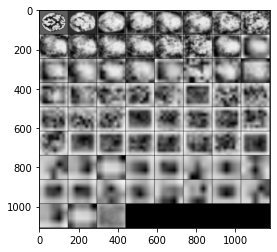

In [ ]:
im = sio.imread('/content/drive/My Drive/BA_Estimation/results/sal_map/20-07-2020-17-38/9_conv1_66_tfw/OAS30344_MR_d0049_chunk_9_cdr0.0_Male_MAP_COMBINED.jpg')


plt.imshow(im, cmap='jet')

In [ ]:
# ims=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map/21-07-2020-20-16/9_conv1_3_tfwexp6/OAS30344_MR_d1052_chunk_9_cdr0.5_Male_.mat')
# ims=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map/20-07-2020-17-20/9_conv1_2_tfw/OAS30344_MR_d1052_cdr0.5_Male_conv3d_2heatmap_gcam.mat')#OAS30884_MR_d3204_cdr0.5_Male_conv3d_2heatmap_gcam_pp.mat')#OAS30344_MR_d1052_cdr0.5_Male_conv3d_2result_gcam_pp.mat')#loadmat('/content/OAS1_0105_MR1_chunk_9_cdr0.0_Male_SAL_MAPS.mat')
# ims=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map/21-07-2020-20-16/9_conv1_3_tfwexp6/OAS30344_MR_d1052_chunk_9_cdr0.5_Male_.mat')
# ims['data']
ims1=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map/20-07-2020-17-20/9_conv1_3_tfw/OAS30884_MR_d2400_cdr0.0_Male_conv3d_2result_gcam_pp.mat')
ims2=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map/20-07-2020-17-20/9_conv1_3_tfw/OAS30884_MR_d3204_cdr0.5_Male_conv3d_2result_gcam_pp.mat')
ims3=loadmat('/content/drive/My Drive/BA_Estimation/results/sal_map/20-07-2020-17-20/9_conv1_3_tfw/OAS30884_MR_d4499_cdr1.0_Male_conv3d_2result_gcam_pp.mat')

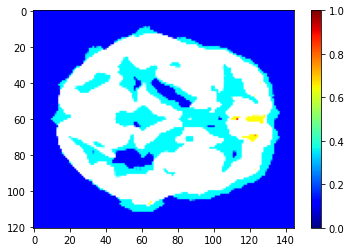

In [ ]:
plt.imshow(20*np.log10(ims1['data']*10),cmap='jet')
plt.colorbar()

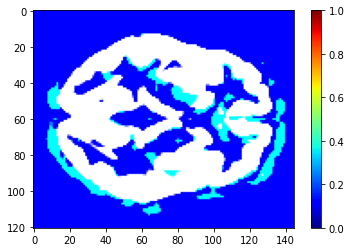

In [ ]:
plt.imshow(20*np.log10(ims2['data']*10),cmap='jet')
plt.colorbar()

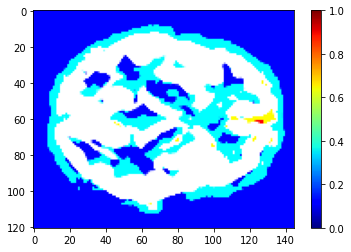

In [ ]:
plt.imshow(20*np.log10(ims3['data']*10),cmap='jet')
plt.colorbar()

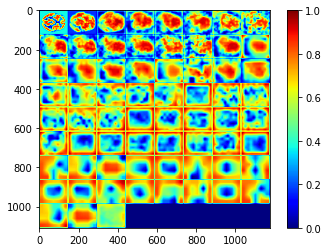

In [ ]:
imcs=sio.imread('/content/drive/My Drive/BA_Estimation/results/sal_map/20-07-2020-17-38/9_conv1_66_tfw/OAS30344_MR_d0049_chunk_9_cdr0.0_Male_MAP_COMBINED.jpg')
plt.imshow(np.mean(imcs,axis=-1)/255, cmap='jet');
plt.colorbar()

plt.imsave('maps.png',np.mean(imcs,axis=-1)/255, cmap='jet')

In [ ]:
imcs=sio.imread('/content/drive/My Drive/BA_Estimation/results/sal_map/20-07-2020-17-20/9_conv1_3_tfw/OAS30884_MR_d4499_chunk_9_cdr1.0_Male_MAP_COMBINED.jpg')
imcs=(np.mean(imcs,axis=-1))
imcs = imcs/np.max(imcs)
f, axarr = plt.subplots(1,1,figsize=(10,10))
im=axarr.imshow(imcs, cmap='jet');
# plt.colorbar()
axarr.set_title('layerwise saliency maps')
plt.colorbar(im,fraction=0.01, pad=0.04)
plt.savefig('/content/OAS30884_MR_d4499_chunk_9_cdr1.0_Male_MAP_COMBINED_jet.png')

FileNotFoundError: ignored

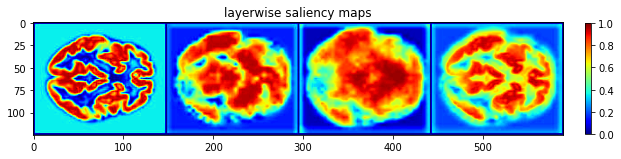

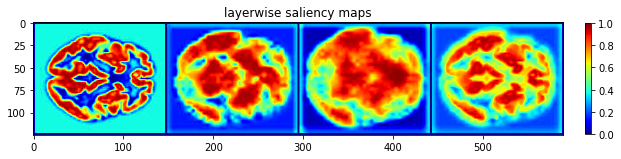

In [ ]:
fil=['OAS30884_MR_d3204_chunk_9_cdr0.5_Male_MAP_COMBINED',
'OAS30884_MR_d2400_chunk_9_cdr0.0_Male_MAP_COMBINED',
'OAS30884_MR_d4499_chunk_9_cdr1.0_Male_MAP_COMBINED',
'OAS30344_MR_d0049_chunk_9_cdr0.0_Male_MAP_COMBINED',
'OAS30344_MR_d1052_chunk_9_cdr0.5_Male_MAP_COMBINED']
for f in fil:
  imcs=sio.imread('/content/drive/My Drive/BA_Estimation/results/sal_map/21-07-2020-20-16/9_conv1_3_tfwexp6/{}.jpg'.format(f))
  imcs=(np.mean(imcs,axis=-1))
  imcs = imcs/np.max(imcs)
  f, axarr = plt.subplots(1,1,figsize=(10,10))
  im=axarr.imshow(imcs, cmap='jet');
  # plt.colorbar()
  axarr.set_title('layerwise saliency maps')
  plt.colorbar(im,fraction=0.01, pad=0.04)
  plt.savefig('/content/{}_jet.png'.format(f))
# plt.imshow(imcs, cmap='jet');
# plt.colorbar()
# plt.imsave('/content/OAS30344_MR_d0049_chunk_9_cdr0.0_Male_MAP_COMBINED_jet.png',imcs, cmap='jet')

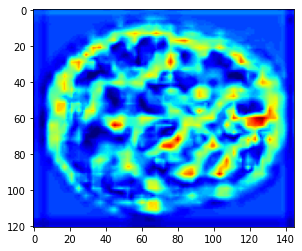

In [ ]:
plt.imshow(ims1['data'],cmap='jet')

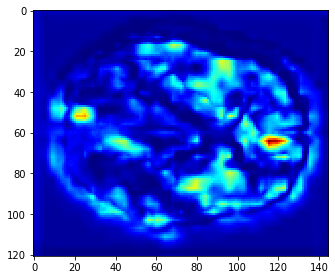

In [ ]:
from google.colab.patches import cv2_imshow
sio.imshow(ims['data'],cmap='jet')

#**Below cells are just for testing can be ignored**

In [ ]:
ar=np.array([np.array([1,2,3]),np.array([4,5,6])])
print(ar[0].shape)
arm=np.mean(ar,axis=0)
arm.shape,arm

(3,)


((3,), array([2.5, 3.5, 4.5]))

In [ ]:
gender_cdr_chunk_dict.keys()

dict_keys([1, 0])

In [ ]:
# for g in gender_cdr_chunk_dict.keys():
#         print(f'Gender = {g}')
#         for cdr,_ in gender_cdr_chunk_dict[g].items():
#             print(f'CDR = {cdr}')
#             for chunk_index,imgs in gender_cdr_chunk_dict[g][cdr].items():
#                 print(f'Chunk Number = {chunk_index}')
#                 imgs=np.array(imgs)
#                 img_tensor =  torch.mean(torch.from_numpy(imgs),axis=0)
#                 # print(f'img_tensor shape={imgs.shape}')
#                 print(f'mean tensor shape={img_tensor.shape}')
                
#                 # ### only  for saving jet and gray scale input mris
#                 input_tensor=torch.from_numpy(img_tensor.numpy())
#                 output_path ='/content/'# base_dir + 'mean'+str(chunk_index)+'_cdr'+str(cdr)+'_'+gender_dict[g]+'original_'
#                 # sio.imsave(output_path+'gray.png',torch.mean(input_tensor[0,:,:,:,:],axis=-1)[0].numpy().astype(np.uint8))
#                 plt.imsave(output_path+'gray.png',torch.mean(input_tensor[0,:,:,:,:],axis=-1)[0].numpy())#,cmap='gray')
#                 # plt.imsave(output_path+'jet.png',torch.mean(input_tensor[0,:,:,:,:],axis=-1)[0].numpy(),cmap='jet')
#                 ###
#                 # compute_fastcam_saliency(base_dir,[img_tensor,g],final_model,'mean',str(chunk_index)+'_cdr'+str(cdr)+'_'+gender_dict[g])

In [ ]:
s=sio.imread('/content/gray.png')
np.amax(s)

255

In [ ]:
len(gender_cdr_chunk_dict[0][0.0][20])+\
len(gender_cdr_chunk_dict[0][0.5][20])+\
len(gender_cdr_chunk_dict[0][1.0][20])+\
len(gender_cdr_chunk_dict[1][0.0][20])+\
len(gender_cdr_chunk_dict[1][0.5][20])+\
len(gender_cdr_chunk_dict[1][1.0][20])

309

In [ ]:
L=os.listdir('/content/drive/My Drive/BA_Estimation/results/sal_map/12-07-2020-10-30')
len(L)

3744

In [ ]:
gender_cdr_chunk_dict[1].keys()

dict_keys([0.0, 1.0, 0.5])

In [ ]:
# base_dir,scan_ids[-1]
input_tensor.shape

NameError: ignored

In [ ]:

import importlib
importlib.reload(norm)
getSmap     = maps.SMOEScaleMap(run_relu=True)

getNorm     = norm.GammaNorm2D()

weights=np.ones([map_num])
getCsmap    = maps.CombineSaliencyMaps(output_size=[in_height,in_width], 
                                       map_num=map_num, weights=weights, resize_mode='bilinear')



NameError: ignored

In [ ]:
for x in hooks:
  print(x.data[:,:,:,:,:].shape)
  print(x.data[:,0,:,:,0].shape)
  print(torch.mean(x.data[:,:,:,:,:],axis=-1).shape)
  print('-----')
hlist=[]
for x in hooks:
  hlist.append(x.data[0,0,:,:,:])

In [ ]:
len(hooks)
# torch.mean()

66

In [ ]:


smaps       = [ getNorm(getSmap(torch.mean(x.data[:,:,:,:,:],axis=-1))) for x in hooks ]
# smaps       = [ getNorm(getSmap(x.data)) for x in hlist ]
csmap,smaps = getCsmap(smaps)

In [ ]:
# smaps[0].permute(1,2,0).shape

torch.Size([1, 121, 145])


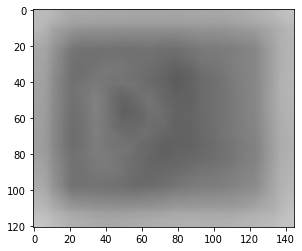

In [ ]:
print(csmap.shape)
output_dir='/content/drive/My Drive/Uni-Sem4/colab_files/'
output_name = "MAP_COMBINED.jpg"
output_path = os.path.join(output_dir, output_name)
misc.SaveGrayTensorToImage(csmap, output_path)
np_smaps    = misc.TensorToNumpyImages(smaps) # For later use, keep the Numpy version 
                                              # of the saliency maps.

# Image(filename=output_path)
im=imread(output_path)
imshow(im,cmap='jet')
# print(im)

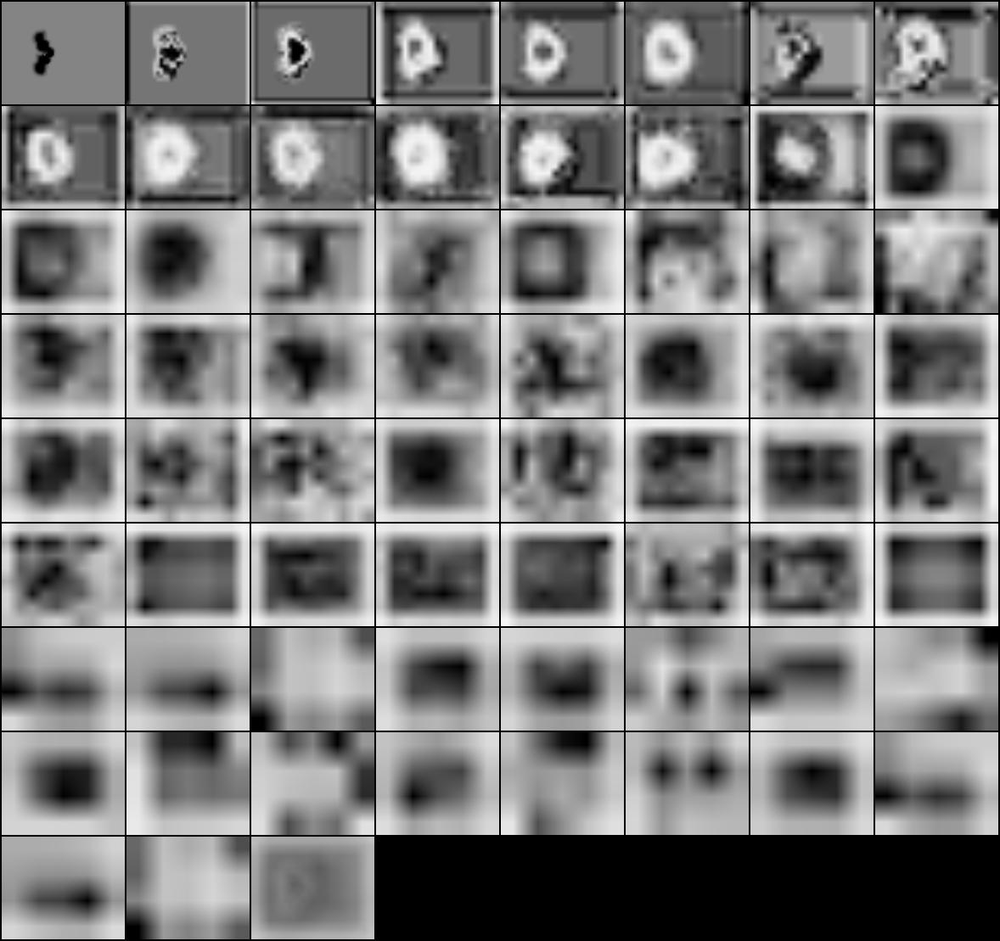

In [ ]:
il = [smaps[0,i,:,:] for i in range(map_num)] # Put each saliency map into the figure
    
il.append(csmap[0,:,:])                       # add in the combined map at the end of the figure

images        = [torch.stack(il, 0)]          
images        = make_grid(torch.cat(images, 0), nrow=5)
output_name   = "SAL_MAPS.jpg"
sal_img_file  = os.path.join(output_dir, output_name)

save_image(images.unsqueeze(1), sal_img_file)

Image(filename=sal_img_file)


In [ ]:
# imshow(images)

In [ ]:


SHM         = draw.HeatMap(shape=np_smaps.shape, weights=weights )  # Create our heat map drawer
LOVI        = draw.LOVI(shape=np_smaps.shape, weights=None)         # Create out LOVI drawer

shm_im      = SHM.make(np_smaps)                                    # Combine the saliency maps 
                                                                    # into one heat map
lovi_im     = LOVI.make(np_smaps)                                   # Combine the saliency maps 

In [ ]:
shm_im.shape,np_smaps.shape

((121, 145, 3), (121, 145, 66))

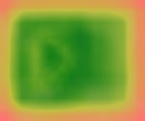

In [ ]:
output_name = "HEAT.jpg"
output_path = os.path.join(output_dir, output_name)
cv2.imwrite(output_path, (shm_im*255.0).astype(np.uint8))

Image(filename=output_path)

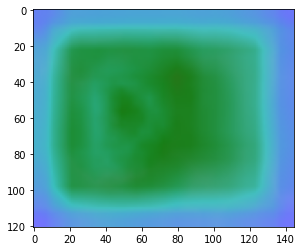

In [ ]:
imshow((shm_im*255.0).astype(np.uint8),cmap='jet')

In [ ]:
shm_im.shape

(121, 145, 3)

In [ ]:
from skimage.transform import resize
cv_im         = input_tensor.numpy().astype(np.float32) / 255.0
print(cv_im.shape,cv_im[0,0,:,:,-1].shape)
# cv_im = resize(cv_im[0,0,:,:,-1],(121,145,3)) #convert one channel image into 3 channel
cv_im = resize(np.mean(cv_im[0,0,:,:,:],axis=-1),(121,145,3)) #convert one channel image into 3 channel
print(cv_im.shape)

(1, 1, 121, 145, 6) (121, 145)
(121, 145, 3)


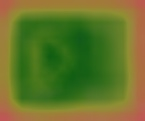

In [ ]:
# cv_im         = input_tensor.numpy().astype(np.float32) / 255.0
ab_shm     = misc.AlphaBlend(shm_im[:,:,:], cv_im) 
# ab_shm        = misc.AlphaBlend(shm_im[:,:,:], cv_im[0,0,:,:,3:6]) # Blend the heat map and the original image

output_name   = "ALPHA_HEAT.jpg"
output_path   = os.path.join(output_dir, output_name)
cv2.imwrite(output_path, (ab_shm*255.0).astype(np.uint8)) 

Image(filename=output_path)





In [ ]:
# imshow(cv_im[:,:,-1],cmap='jet')
# cv_im[:,:,-1].shape

In [ ]:
lovi_im.shape,shm_im.shape

((121, 145, 3), (121, 145, 3))

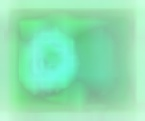

In [ ]:
output_name   = "LOVI.jpg"#.format(save_prefix)
output_path   = os.path.join(output_dir, output_name)
cv2.imwrite(output_path, (lovi_im*255.0).astype(np.uint8))

Image(filename=output_path)

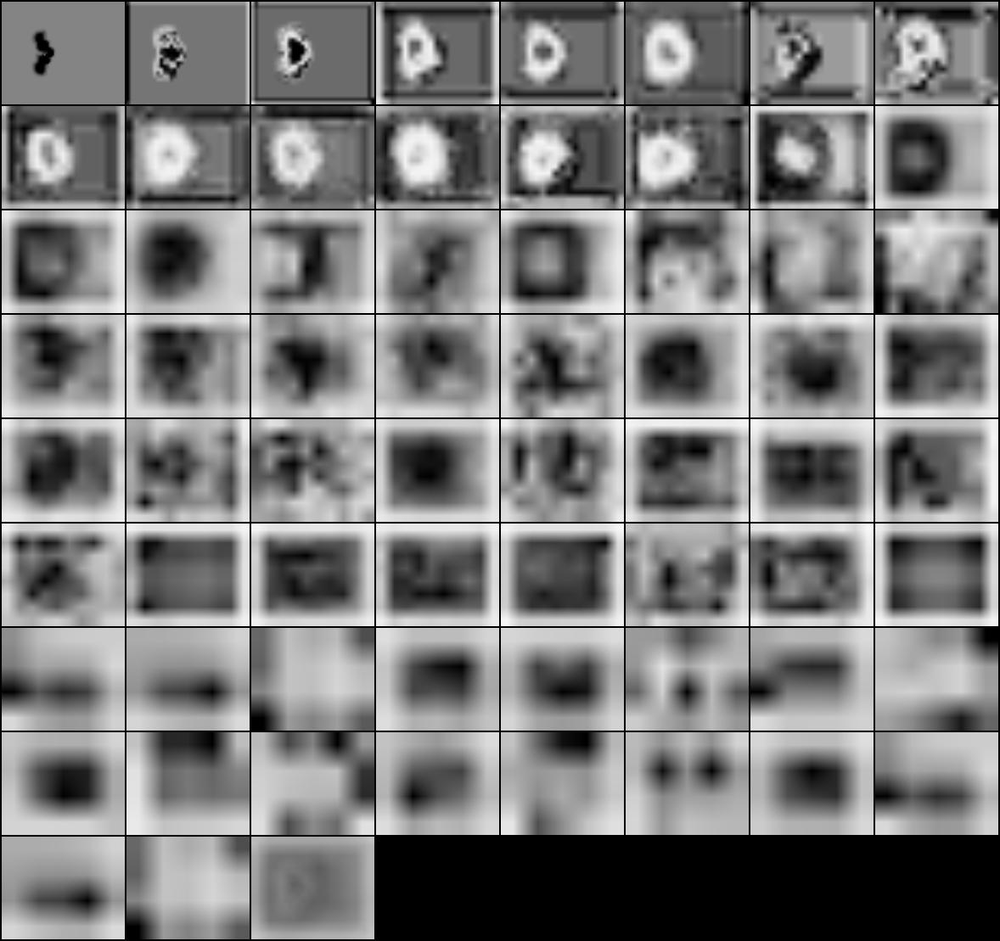

In [ ]:


Image(filename=sal_img_file)



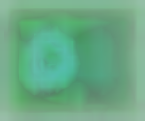

In [ ]:
# ab_lovi       = misc.AlphaBlend(lovi_im, cv_im[0,0,:,:,3:6]) # Blend original image and LOVI image
ab_lovi       = misc.AlphaBlend(lovi_im, cv_im)
output_name   = "ALPHA_LOVI.png"
output_path   = os.path.join(output_dir, output_name)
cv2.imwrite(output_path, (ab_lovi*255.0).astype(np.uint8)) 
# print(cv_im[0,0,:,:,0:3].max(),cv_im[0,0,:,:,0:3].min())
# print(cv_im[0,0,:,:,3:6].max(),cv_im[0,0,:,:,3:6].min())
Image(filename=output_path)


torch.Size([1, 1, 121, 145, 6])
torch.Size([121, 145]) torch.Size([1, 121, 145])
torch.Size([1, 3, 121, 145]) torch.Size([66, 121, 145])
torch.Size([1, 3, 121, 145])


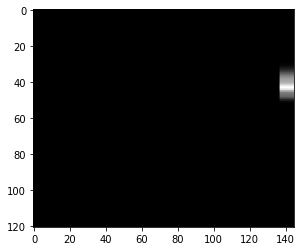

In [ ]:
import skimage.io as sio
getMask                 = mask.SaliencyMaskDropout(keep_percent = 0.1, scale_map=False)
denorm                  = misc.DeNormalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
# denorm                  = misc.DeNormalize([0.485], [0.229])
print(input_tensor.shape)
# masked_tensor,drop_map  = getMask(input_tensor[:,:,:,:,0], csmap)
cv_im         = input_tensor.numpy().astype(np.float32) / 255.0
print(torch.from_numpy(np.mean(cv_im[0,0,:,:,:],axis=-1)).shape,csmap.shape)
cv_im = torch.from_numpy(resize(np.mean(cv_im[0,0,:,:,:],axis=-1),(3,121,145)) )
print(cv_im.unsqueeze(0).shape,smaps[0].shape)
masked_tensor,drop_map  = getMask(cv_im.unsqueeze(0), csmap[:,:,:])
masked_tensor = denorm(masked_tensor)

output_name   = "MASK.jpg"#.format(save_prefix)
output_path   = os.path.join(output_dir, output_name)
print(masked_tensor.shape)
misc.SaveColorTensorToImage(masked_tensor, output_path)
# Image(filename=output_path)
# sio.imshow(masked_tensor[0])
masked_tensor=torch.mean(masked_tensor[:,:,:,:],axis=1)# convert 1,3,121,145 to 1,121,145
# print(masked_tensor.shape,torch.mean(masked_tensor[:,:,:,:],axis=1).shape,torch.mean(masked_tensor[:,:,:,:],axis=1).shape)
imshow(masked_tensor[0],cmap='gray')


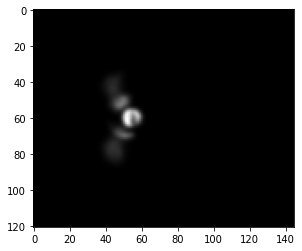

In [ ]:
imshow(torch.mean(input_tensor[0,:,:,:,:],axis=-1)[0],cmap='gray')

In [ ]:
torch.mean(input_tensor[0,:,:,:,:],axis=-1).shape

torch.Size([1, 121, 145])

In [ ]:
input_tensor[0,:,:,:,:].shape,in_tensor.shape,in_height,in_width

(torch.Size([1, 121, 145, 6]), torch.Size([1, 121, 145, 6]), 121, 145)

In [ ]:
inflated_model_dict['Conv3D_BN5c0.BatchNorm3d.num_batches_tracked'],tfw[3].numpy().shape,tfw[84].name

(tensor(0), (64,), 'conv3d_21_5/kernel:0')

In [ ]:
inflated_model_dict['Conv3D_BN2.BatchNorm3d.bias'].shape

torch.Size([64])

In [ ]:
#.permute(4,3,0,1,2)

np.array_equal(torch.from_numpy(tfw[85].numpy()).permute(4,3,0,1,2),inflated_model_dict['Fire_Module1.Conv3D_expand_left.0.weight'])



True

In [ ]:
len(tfw)

245

In [ ]:
for t in tfw:
  print(t.name)

conv3d_70/kernel:0
batch_normalization_61/beta:0
batch_normalization_61/moving_mean:0
batch_normalization_61/moving_variance:0
conv3d_1_5/kernel:0
batch_normalization_1_5/beta:0
batch_normalization_1_5/moving_mean:0
batch_normalization_1_5/moving_variance:0
conv3d_2_5/kernel:0
batch_normalization_2_5/beta:0
batch_normalization_2_5/moving_mean:0
batch_normalization_2_5/moving_variance:0
conv3d_4_5/kernel:0
conv3d_6_5/kernel:0
batch_normalization_4_5/beta:0
batch_normalization_4_5/moving_mean:0
batch_normalization_4_5/moving_variance:0
batch_normalization_6_5/beta:0
batch_normalization_6_5/moving_mean:0
batch_normalization_6_5/moving_variance:0
conv3d_3_5/kernel:0
conv3d_5_5/kernel:0
conv3d_7_5/kernel:0
conv3d_8_5/kernel:0
batch_normalization_3_5/beta:0
batch_normalization_3_5/moving_mean:0
batch_normalization_3_5/moving_variance:0
batch_normalization_5_5/beta:0
batch_normalization_5_5/moving_mean:0
batch_normalization_5_5/moving_variance:0
batch_normalization_7_5/beta:0
batch_normalizat